==============================\
Student name: Shiqi Yin \
GitHub username: acse-sy121\
\==============================

In [ ]:
from tensorflow import keras
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import load_model

import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import joblib
import copy
import tqdm

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
encoder, decoder = load_model('/content/drive/MyDrive/output_files/Models/with_sensor/autoencoder_10000.h5').layers
all_data = joblib.load('/content/drive/MyDrive/output_files/DATA/PCA_data/X_all_pca.pkl')
pca_compress = joblib.load('/content/drive/MyDrive/output_files/DATA/PCA_data/pca_compress_to_92.pkl')
ob_all_values = joblib.load('/content/drive/MyDrive/output_files/DATA/data_used_for_model/ob_all_values.pkl')

In [ ]:
scaler_CO2_all = joblib.load('/content/drive/MyDrive/output_files/scalers/node_data/scaler_CO2_all.pkl')
scaler_x_all = joblib.load('/content/drive/MyDrive/output_files/scalers/node_data/scaler_x_all.pkl')
scaler_y_all = joblib.load('/content/drive/MyDrive/output_files/scalers/node_data/scaler_y_all.pkl')
scaler_z_all = joblib.load('/content/drive/MyDrive/output_files/scalers/node_data/scaler_z_all.pkl')
scaler_Humidity_all = joblib.load('/content/drive/MyDrive/output_files/scalers/node_data/scaler_Humidity_all.pkl')
scaler_Temperature_all = joblib.load('/content/drive/MyDrive/output_files/scalers/node_data/scaler_Temperature_all.pkl')
scaler_Virus1_all = joblib.load('/content/drive/MyDrive/output_files/scalers/node_data/scaler_Virus1_all.pkl')
scaler_01 = joblib.load('/content/drive/MyDrive/output_files/scalers/node_data/scaler_with_DA/scaler_minmax01.pkl')


scaler_ob_CO2_all = joblib.load('/content/drive/MyDrive/output_files/scalers/sensor_data/scaler_ob_CO2_all.pkl')
scaler_ob_xdata_all = joblib.load('/content/drive/MyDrive/output_files/scalers/sensor_data/scaler_ob_xdata_all.pkl')
scaler_ob_ydata_all = joblib.load('/content/drive/MyDrive/output_files/scalers/sensor_data/scaler_ob_ydata_all.pkl')
scaler_ob_zdata_all = joblib.load('/content/drive/MyDrive/output_files/scalers/sensor_data/scaler_ob_zdata_all.pkl')
scaler_ob_Humidity_all = joblib.load('/content/drive/MyDrive/output_files/scalers/sensor_data/scaler_ob_Humidity_all.pkl')
scaler_ob_Temperature_all = joblib.load('/content/drive/MyDrive/output_files/scalers/sensor_data/scaler_ob_Temperature_all.pkl')
scaler_ob_Virus1_all = joblib.load('/content/drive/MyDrive/output_files/scalers/sensor_data/scaler_ob_Virus1_all.pkl')

scaler_exp_CO2_all = joblib.load('/content/drive/MyDrive/output_files/scalers/experimental_data/scaler_exp_CO2_all.pkl')
scaler_exp_Humidity_all = joblib.load('/content/drive/MyDrive/output_files/scalers/experimental_data/scaler_exp_Humidity_all.pkl')
scaler_exp_Temperature_all = joblib.load('/content/drive/MyDrive/output_files/scalers/experimental_data/scaler_exp_Temperature_all.pkl')

In [ ]:
input_timestamps = 9
batchsize = 128
step = 1
x_axis = np.linspace(1, 720, 720)
x_input = np.linspace(1, 8, 8)

In [ ]:
def simplify_dataset(X_train, input_timestamps, step):
  X_train_simp = []
  for i in range(len(X_train) - input_timestamps*step):
    X_train_simp.append(X_train[i:i+input_timestamps*step:step])
  return np.array(X_train_simp)

def Data_reshape(input_array):
  X_for_conv = (input_array.reshape((input_array.shape[0], input_timestamps, input_array.shape[2], 1))).astype('float32')
  X_output = tf.data.Dataset.from_tensor_slices(X_for_conv)
  X_output = X_output.shuffle(len(X_output))
  X_output = X_output.batch(batchsize)
  print(X_for_conv.shape)
  return X_for_conv, X_output

In [ ]:
mse = tf.keras.losses.MeanSquaredError()
def mse_loss(inp, outp):
    """
    Calculate mean square error 
    between real value and prediction
    
    Parameters
    ----------
    inp : numpy.ndarray 
       real POD coefficients
    ontp : numpy.ndarray
       generated values of the POD coefficients

    Returns
    -------
    float
       mean squared loss between inp and outp
    """   
    inp = tf.reshape(inp, [-1, total_coeffs])
    outp = tf.reshape(outp, [-1, total_coeffs])
    return mse(inp, outp)

def predict_coding_forward_basic(initial_pred, real_coding, epochs=10):
    """
    Generate predictions of m consecutive time levels:
    use {0-(m-2)} to predict m-1
    
    Parameters
    ----------
    initial_pred : numpy.ndarray 
       initial guess of m consecutive time levels
    real_coding : numpy.ndarray
       real value of {0 - (m-2)} consecutive time levels
    epochs: int
       times of update iteration
       
    Returns
    -------
    numpy.ndarray
       predictions for m consecutive time levels
    float
       mean squared loss of the last iteration   
    """   
    loss = []
    # Do the iteration to get the result
    for epoch in range(epochs):
        encoder_output = encoder(initial_pred, training=False)
        decoder_output = decoder(encoder_output, training=False)
        loss.append(mse_loss(real_coding, decoder_output[:,:(input_timestamps - 1),:,:]).numpy())
        # Replace initial guess with the output of decoder at time level n       
        initial_pred[:,(input_timestamps - 1):,:,:] = decoder_output[:,(input_timestamps - 1):,:,:]        
        
    return decoder_output,loss[-1]

def predict_coding_forward(initial_pred, real_coding, obs_data, epochs=10):
    """
    Generate predictions of m consecutive time levels:
    use {0-(m-2)} to predict m-1
    
    Parameters
    ----------
    initial_pred : numpy.ndarray 
       initial guess of m consecutive time levels
    real_coding : numpy.ndarray
       real value of {0 - (m-2)} consecutive time levels
    obs_data : numpy.ndarray
       observation data given by sensors
    epochs: int
       times of update iteration
       
    Returns
    -------
    numpy.ndarray
       predictions for m consecutive time levels
    float
       mean squared loss of the last iteration   
    """     
    loss = []
    # Do the iteration to get the result    
    for epoch in range(epochs):
        encoder_output = encoder(initial_pred, training=False)
        decoder_output = decoder(encoder_output, training=False)
        loss.append(mse_loss(real_coding, decoder_output[:,:(input_timestamps - 1),:,:]).numpy())
        # Replace initial guess with the output of decoder at time level n        
        initial_pred[:,(input_timestamps - 1):,:,:] = decoder_output[:,(input_timestamps - 1):,:,:]
 
        # Replace sensors' data in initial input with observation data using weight
        for i in range(len(obs_data)):
            # Find the time level with existing observation data
            time_level = int(obs_data[i,0])
            # Replace data with observation data by weight
            initial_pred[0,time_level,150:,0] = (1-weight)*(initial_pred[0,time_level,150:,0]) + weight*obs_data[i,1:]

    return decoder_output,loss[-1]

def predict_coding_backward(initial_pred, real_coding, obs_data, epochs=10):
    """
    Generate predictions of m consecutive time levels:
    use {1-(m-1)} to predict 0
    
    Parameters
    ----------
    initial_pred : numpy.ndarray 
       initial guess of m consecutive time levels
    real_coding : numpy.ndarray
       real value of {1 - (m-1)} consecutive time levels
    obs_data : numpy.ndarray
       observation data given by sensors
    epochs: int
       times of update iteration
       
    Returns
    -------
    numpy.ndarray
       predictions for m consecutive time levels
    float
       mean squared loss of the last iteration   
    """   
    loss = []
    # Do the iteration to get the result    
    for epoch in range(epochs):
        encoder_output = encoder(initial_pred, training=False)
        decoder_output = decoder(encoder_output, training=False)
        loss.append(mse_loss(real_coding, decoder_output[:,1:,:,:]).numpy())
        # Replace initial guess with the output of decoder at time level n         
        initial_pred[:,:1,:,:] = decoder_output[:,:1,:,:]

        # Replace sensors' data in initial input with observation data using weight
        for i in range(len(obs_data)):
            # Find the time level with existing observation data
            time_level = int(obs_data[i,0])
            # Replace data with observation data by weight
            initial_pred[0,time_level,150:,0] = (1-weight)*(initial_pred[0,time_level,150:,0]) + weight*obs_data[i,1:]

    return decoder_output,loss[-1]

def process_obs_data(march_range, X_obs):
    """
    Process the observation data to be 
    in the range of the forward/backward march
    
    Parameters
    ----------
    march_range : numpy.ndarray 
       the time levels covered by the current forecast
    X_obs : numpy.ndarray
       all observation data
       
    Returns
    -------
    numpy.ndarray
       observation data in the forward/backward march   
    """   
    obs_data = []
    for x in range(len(X_obs)):
        if X_obs[x,0] in march_range:
            obs_data.append(X_obs[x])
    
    # Convert the time level to the range [0, (m-1))
    obs_data = np.array(obs_data)
    for i in range(len(obs_data)):
        obs_data[i,0] = obs_data[i,0] - march_range[0]
   
    return obs_data

In [ ]:
# transform test set into range (0, 1)
X_all_array_origin = scaler_01.transform(all_data)
X_all_all = np.hstack((X_all_array_origin, ob_all_values))
X_all_array = simplify_dataset(X_all_all, input_timestamps, step)
X_all_for_conv, X_all = Data_reshape(X_all_array)

(711, 9, 276, 1)


In [ ]:
# Number of coeffs after PCA
coeffs_num = X_all_array_origin.shape[1]
# Number of sensors
sensor_num = ob_all_values.shape[1]
# Total coeffs input to the model
total_coeffs = coeffs_num + sensor_num

In [ ]:
# Choose start time level
n = 0
# Set the proportion of observations in the initial guess

# Set prediction range
forward_steps = 712
print(X_all_for_conv.shape[0] + 1 - n)
# forward_steps = X_all_for_conv.shape[0] + 1 - n
time_steps = forward_steps + input_timestamps
prediction_num = forward_steps
real_timestamp = 8

712


First forward march

In [ ]:
first_forward_loss = []
real_value = X_all_for_conv[n].reshape(1,-1)
print(real_value.shape)
# Set time level n-m to n-1 as the input
real_value = real_value[:,:total_coeffs*(input_timestamps - 1)]
real_value = real_value.reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
# Set value of time level n as same as that of time level n-1
initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)

# Predict data for one time level forward in time (time level m-1)
prediction_values,loss = predict_coding_forward_basic(initial_pred, real_value)
first_forward_loss.append(loss)

# Update input and initial guess
X_predict = list(prediction_values.numpy().reshape(-1,total_coeffs))
# prediction of time level n
gen_predict = prediction_values[:,(input_timestamps - 1):,:,:]
# Add the predicted value to the real value
real_value = np.concatenate((real_value[:,1:,:,:], gen_predict), axis=1)
# Set value of time level n as same as that of time level n-1
initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)

# Predict forward in time without observation data
for i in tqdm.tqdm(range(1, forward_steps)):
    prediction_values, loss = predict_coding_forward_basic(initial_pred, real_value)
    first_forward_loss.append(loss)

    # Update input values and initial guess
    gen_predict = prediction_values[:,(input_timestamps - 1):,:,:].numpy()
    X_predict.append(gen_predict.flatten())
    real_value = np.concatenate((real_value[:,1:,:,:], gen_predict), axis=1)
    initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)
X_predict = np.array(X_predict)
print(X_predict.shape)

(1, 2484)


100%|██████████| 711/711 [01:28<00:00,  8.04it/s]

(720, 276)


In [ ]:
coeffs_pred = X_predict[:,:coeffs_num]
sensors_pred = X_predict[:,coeffs_num:]

## Process sensor results

In [ ]:
pred_sensor_split = np.hsplit(sensors_pred, 7)

In [ ]:
# Undo (0,1) scaling
pred_sensor_CO2 = scaler_ob_CO2_all.inverse_transform(pred_sensor_split[0])
pred_sensor_xdata = scaler_ob_xdata_all.inverse_transform(pred_sensor_split[1])
pred_sensor_ydata = scaler_ob_ydata_all.inverse_transform(pred_sensor_split[2])
pred_sensor_zdata = scaler_ob_zdata_all.inverse_transform(pred_sensor_split[3])
pred_sensor_Humidity = scaler_ob_Humidity_all.inverse_transform(pred_sensor_split[4])
pred_sensor_Temperature = scaler_ob_Temperature_all.inverse_transform(pred_sensor_split[5])
pred_sensor_Virus1 = scaler_ob_Virus1_all.inverse_transform(pred_sensor_split[6])

In [ ]:
ob_sensor_split = np.hsplit(ob_all_values, 7)

In [ ]:
# Undo (0,1) scaling
ob_CO2_all = scaler_ob_CO2_all.inverse_transform(ob_sensor_split[0])
ob_xdata_all = scaler_ob_xdata_all.inverse_transform(ob_sensor_split[1])
ob_ydata_all = scaler_ob_ydata_all.inverse_transform(ob_sensor_split[2])
ob_zdata_all = scaler_ob_zdata_all.inverse_transform(ob_sensor_split[3])
ob_Humidity_all = scaler_ob_Humidity_all.inverse_transform(ob_sensor_split[4])
ob_Temperature_all = scaler_ob_Temperature_all.inverse_transform(ob_sensor_split[5])
ob_Virus1_all = scaler_ob_Virus1_all.inverse_transform(ob_sensor_split[6])

## Plot the result of sensors

In [ ]:
def plot_output_sensor(predict_data, CFD_data, filename):
  fig, ax = plt.subplots(6, 3, figsize=[18,12])
  fig.tight_layout(h_pad=3.5, w_pad=3.5)
  for i in range(18):
    ax.flatten()[i].plot(x_axis*5, predict_data[n:real_timestamp+prediction_num,i], '-')
    ax.flatten()[i].plot(x_axis*5, CFD_data[n:n+(real_timestamp+prediction_num),i], '-')
    ax.flatten()[i].plot(x_input*5, CFD_data[n:n+(real_timestamp),i], 'd')
    ax.flatten()[i].legend(['Prediction', 'Fluidity', 'Input data'])
    ax.flatten()[i].set_title('Sensor '+ str(i+1))
    ax.flatten()[i].set_xlabel('Time (s)')
    ax.flatten()[i].set_ylabel(filename)
  path = '/content/drive/MyDrive/output_files/Figures/Figures_with_DA_Applied/sensors/All_set/'+str(filename)+'_prediction.png'
  plt.savefig(path)

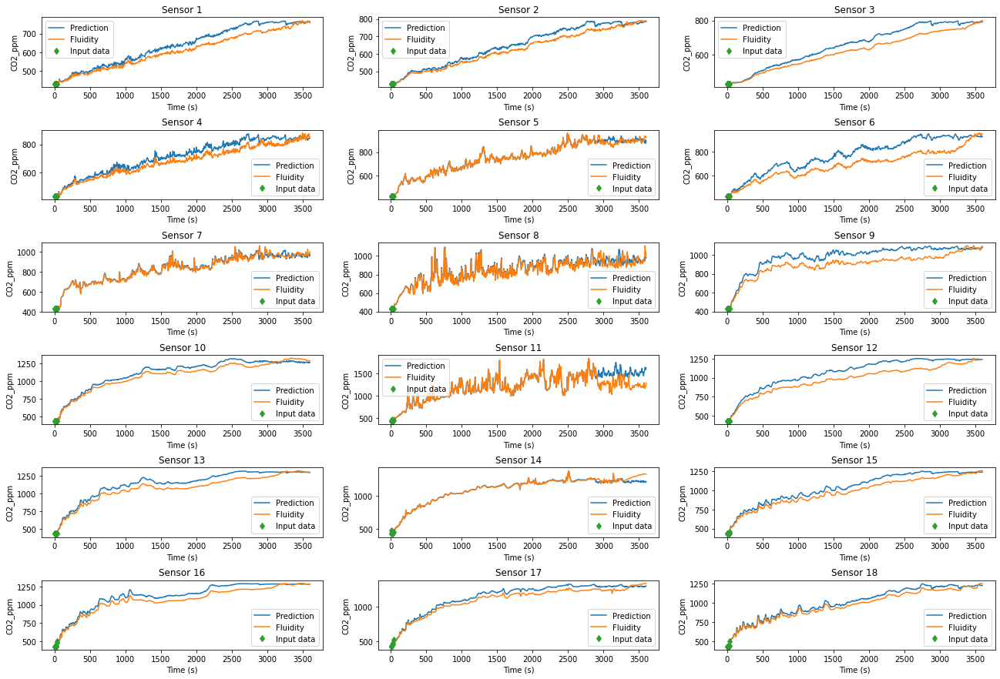

In [ ]:
plot_output_sensor(pred_sensor_CO2, ob_CO2_all, 'CO2_ppm')

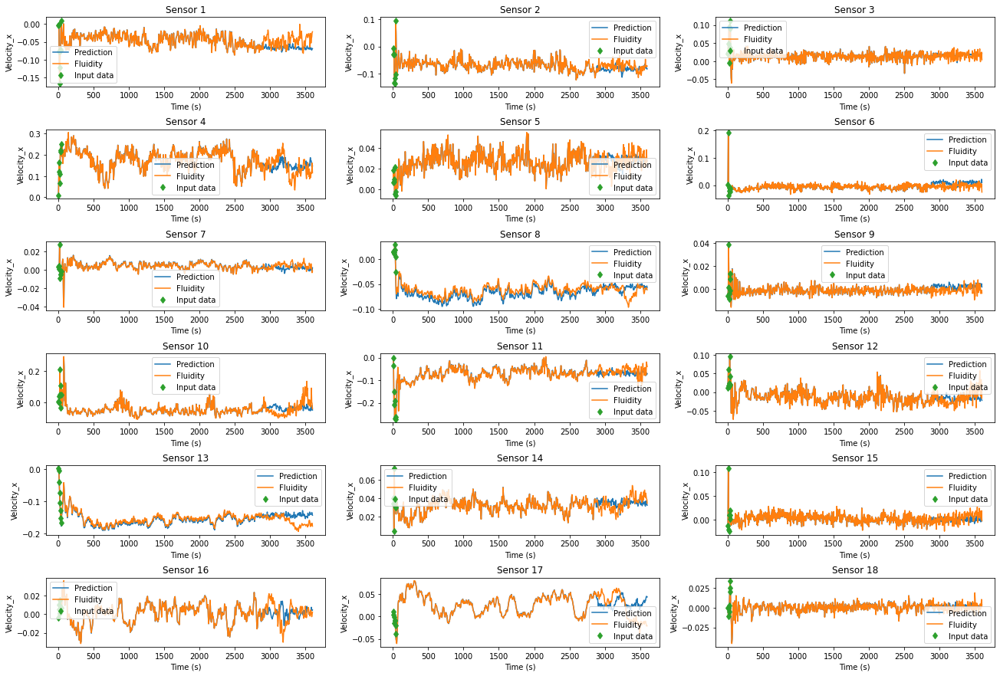

In [ ]:
plot_output_sensor(pred_sensor_xdata, ob_xdata_all, 'Velocity_x')

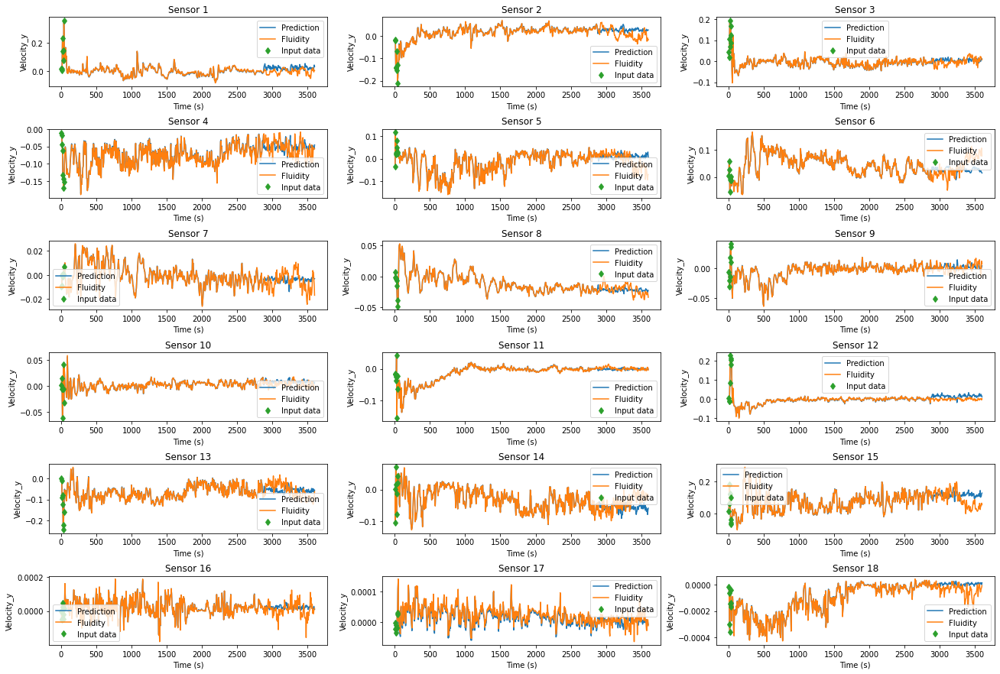

In [ ]:
plot_output_sensor(pred_sensor_ydata, ob_ydata_all, 'Velocity_y')

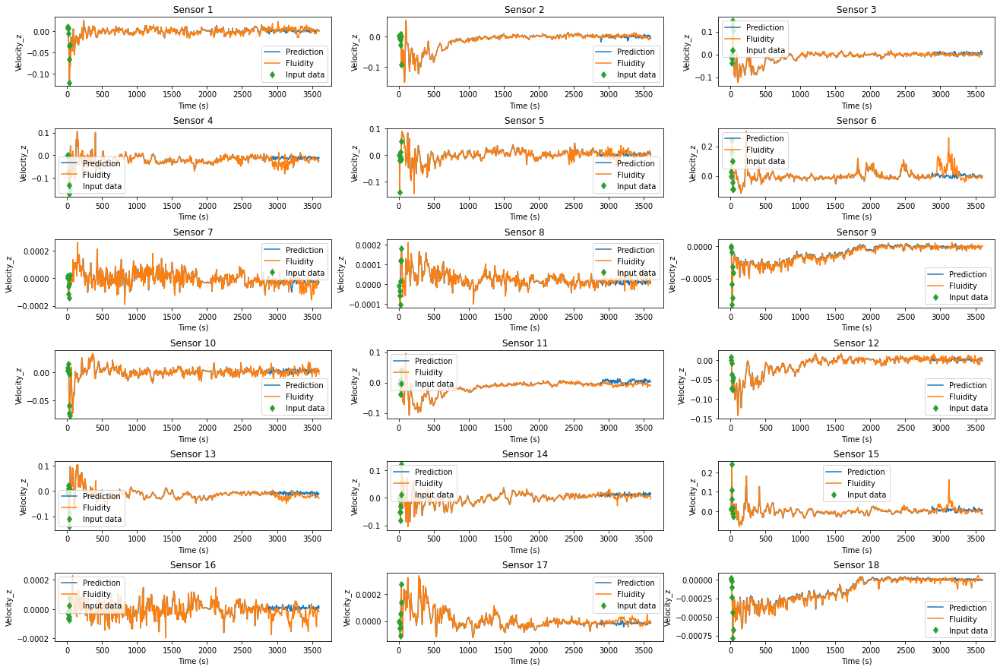

In [ ]:
plot_output_sensor(pred_sensor_zdata, ob_zdata_all, 'Velocity_z')

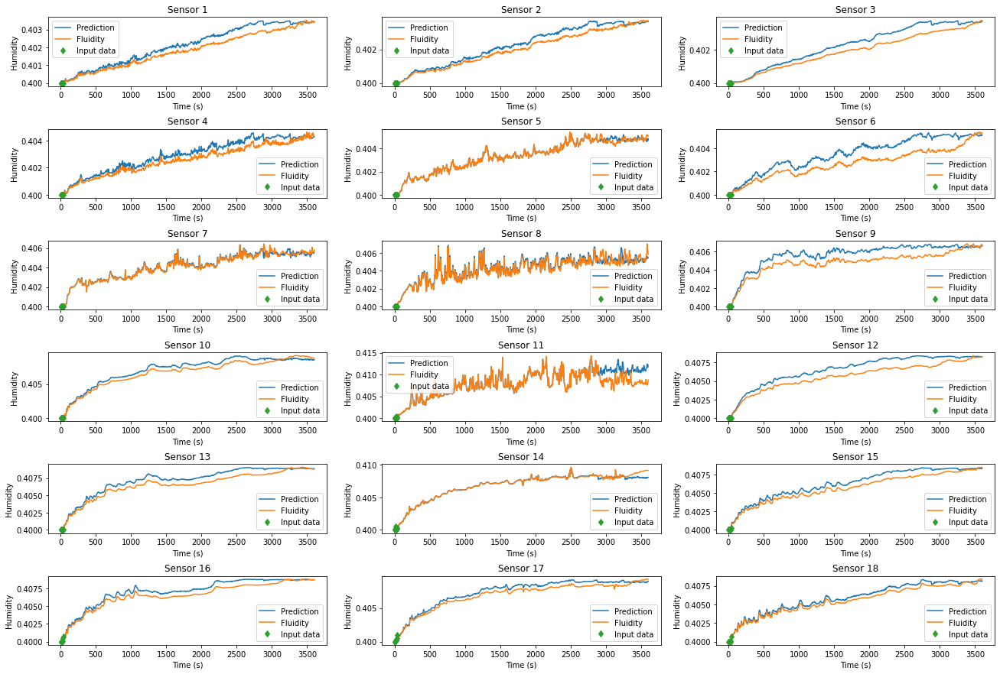

In [ ]:
plot_output_sensor(pred_sensor_Humidity, ob_Humidity_all, 'Humidity')

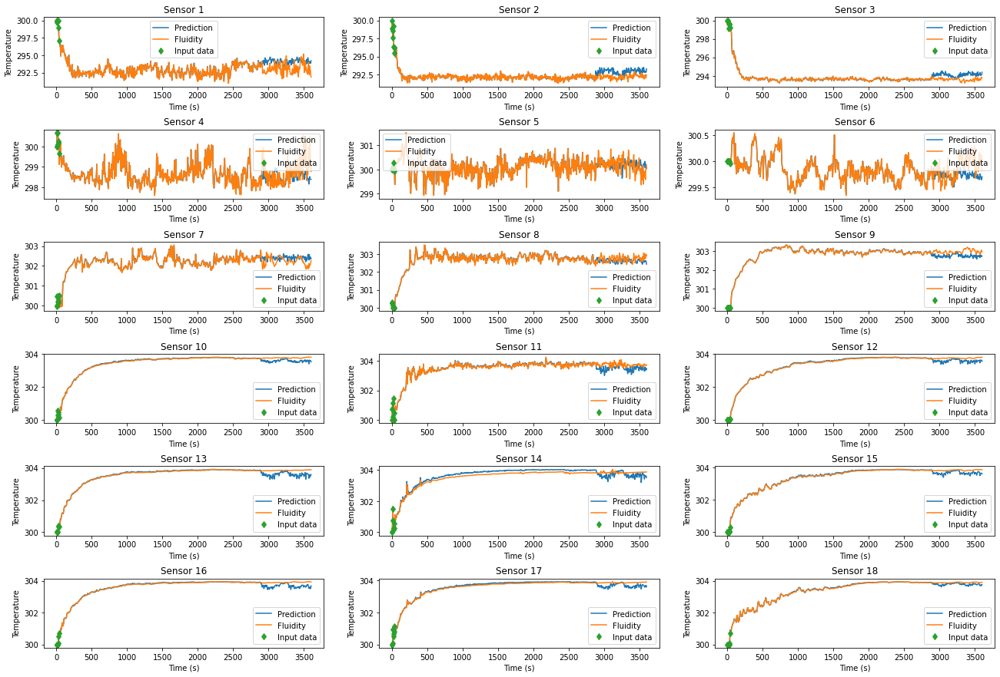

In [ ]:
plot_output_sensor(pred_sensor_Temperature, ob_Temperature_all, 'Temperature')

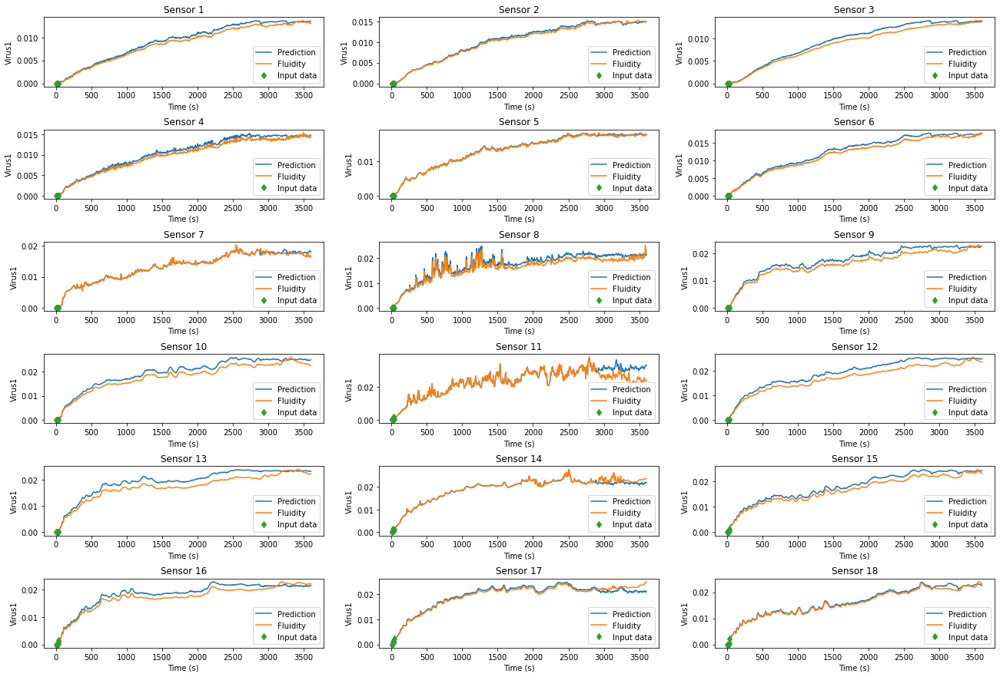

In [ ]:
plot_output_sensor(pred_sensor_Virus1, ob_Virus1_all, 'Virus1')

## Process node results

In [ ]:
# Undo (0,1) scaling
X_inverse_01 = scaler_01.inverse_transform(coeffs_pred)
# Undo PCA to obtain a scaled snapshot matrix
X_inverse_PCA = pca_compress.inverse_transform(X_inverse_01)
# Split to CO2 and three dimensions of velocity data
X_predict_split = np.hsplit(X_inverse_PCA, 7)
# Undo (−1,1) scaling
pred_CO2 = scaler_CO2_all.inverse_transform(X_predict_split[0])
pred_Velocity_x = scaler_x_all.inverse_transform(X_predict_split[1])
pred_Velocity_y = scaler_y_all.inverse_transform(X_predict_split[2])
pred_Velocity_z = scaler_z_all.inverse_transform(X_predict_split[3])
pred_Humidity = scaler_Humidity_all.inverse_transform(X_predict_split[4])
pred_Temperature = scaler_Temperature_all.inverse_transform(X_predict_split[5])
pred_Virus1 = scaler_Virus1_all.inverse_transform(X_predict_split[6])

In [ ]:
X_CFD = pca_compress.inverse_transform(all_data)
X_CFD_split = np.hsplit(X_CFD, 7)

In [ ]:
# Undo (−1,1) scaling
CFD_CO2 = scaler_CO2_all.inverse_transform(X_CFD_split[0])
CFD_Velocity_x = scaler_x_all.inverse_transform(X_CFD_split[1])
CFD_Velocity_y = scaler_y_all.inverse_transform(X_CFD_split[2])
CFD_Velocity_z = scaler_z_all.inverse_transform(X_CFD_split[3])
CFD_Humidity = scaler_Humidity_all.inverse_transform(X_CFD_split[4])
CFD_Temperature = scaler_Temperature_all.inverse_transform(X_CFD_split[5])
CFD_Virus1 = scaler_Virus1_all.inverse_transform(X_CFD_split[6])

## Plot the node results

In [ ]:
def plot_output(predict_data, CFD_data, filename):
  fig, ax = plt.subplots(3, 3, figsize=[16,10])
  fig.tight_layout(h_pad=3.5, w_pad=3.5)
  for i in range(9):
    ax.flatten()[i].plot(x_axis*5, predict_data[:real_timestamp+prediction_num,i*200], '-')
    ax.flatten()[i].plot(x_axis*5, CFD_data[n:n+(real_timestamp+prediction_num)*step:step,i*200], '-')
    ax.flatten()[i].plot(x_input*5, CFD_data[n:n+(real_timestamp)*step:step,i*200], 'd')
    ax.flatten()[i].legend(['Prediction', 'Fluidity', 'Input data'])
    ax.flatten()[i].set_title('Node '+ str(i*200+1))
    ax.flatten()[i].set_xlabel('Time (s)')
    ax.flatten()[i].set_ylabel(filename)
    
  path = '/content/drive/MyDrive/output_files/Figures/Figures_with_DA_Applied/nodes/All_set/'+str(filename)+'_prediction.png'
  plt.savefig(path)

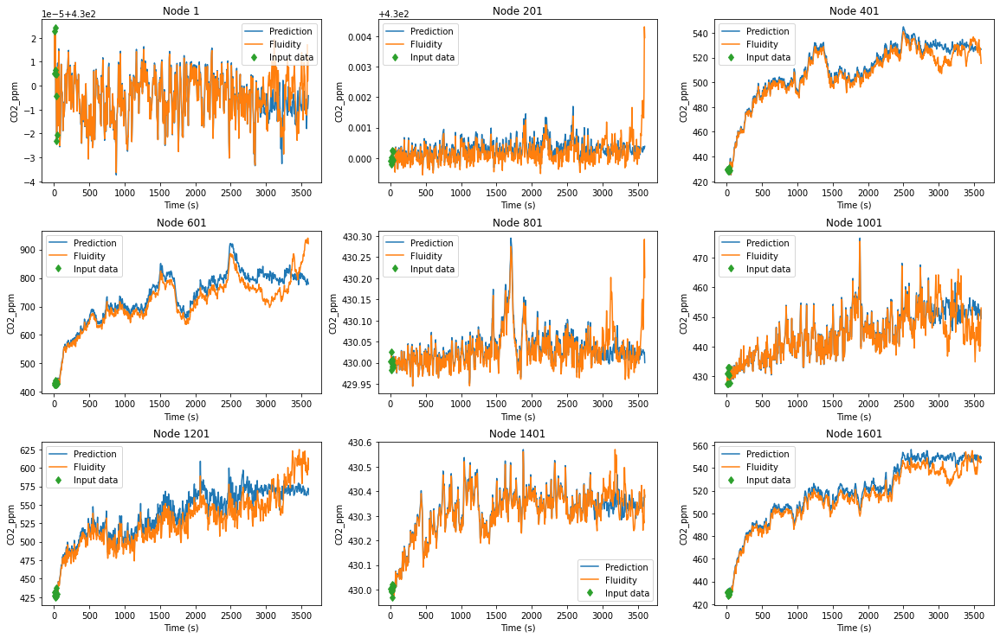

In [ ]:
plot_output(pred_CO2, CFD_CO2, 'CO2_ppm')

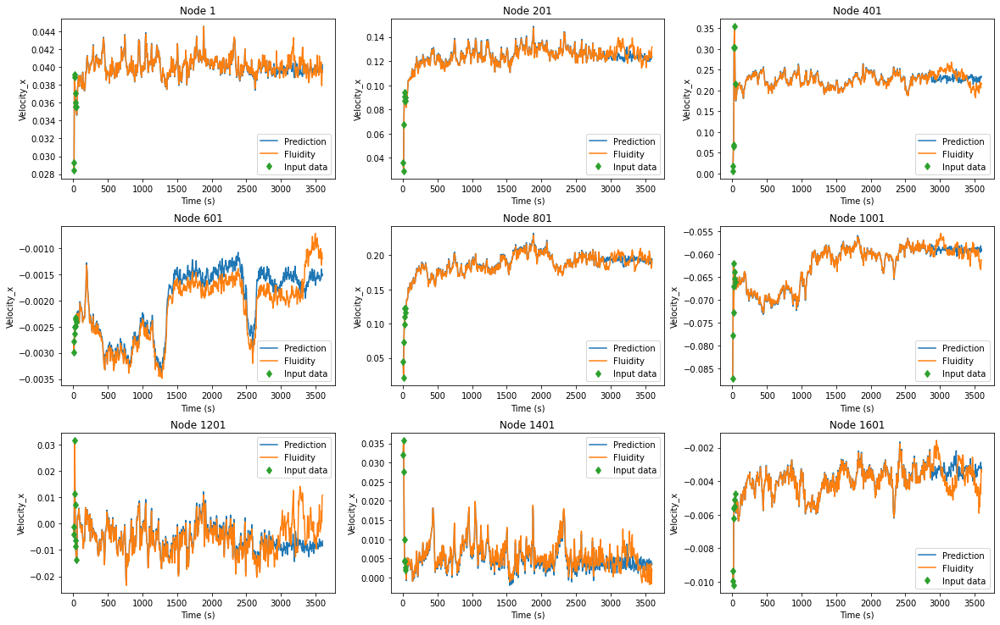

In [ ]:
plot_output(pred_Velocity_x, CFD_Velocity_x, 'Velocity_x')

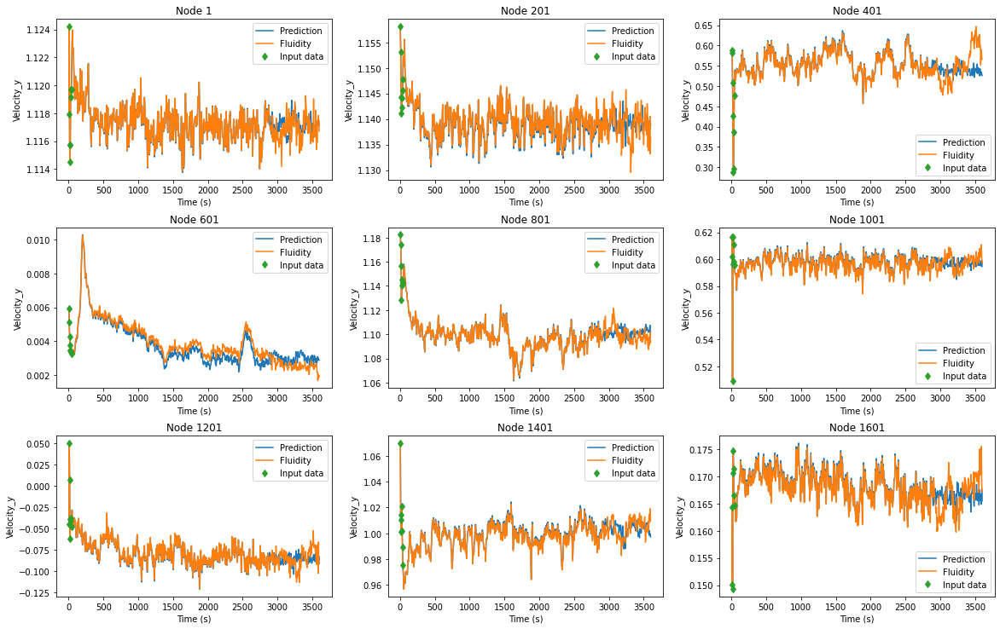

In [ ]:
plot_output(pred_Velocity_y, CFD_Velocity_y, 'Velocity_y')

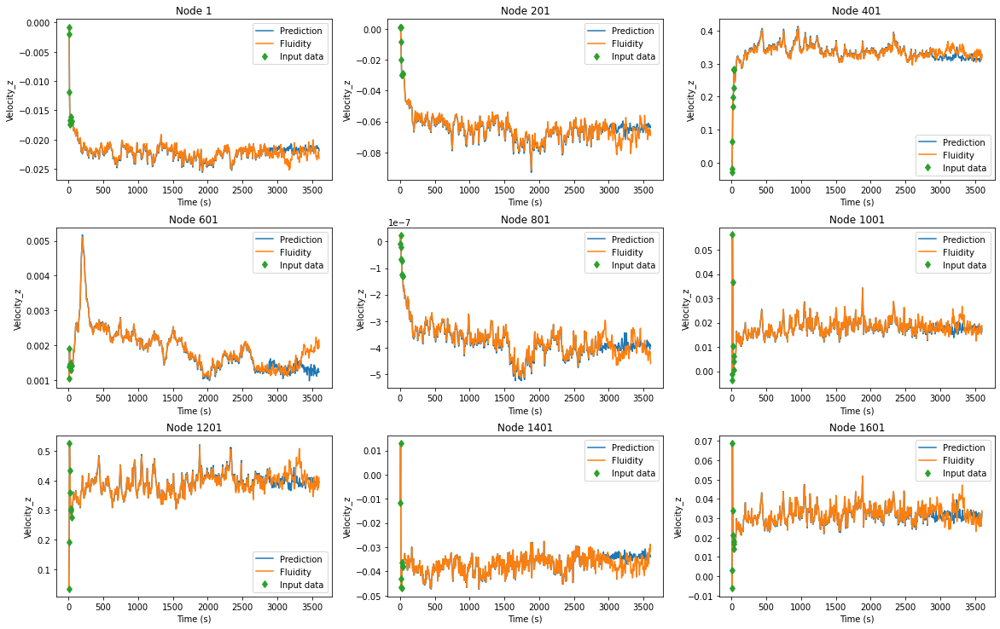

In [ ]:
plot_output(pred_Velocity_z, CFD_Velocity_z, 'Velocity_z')

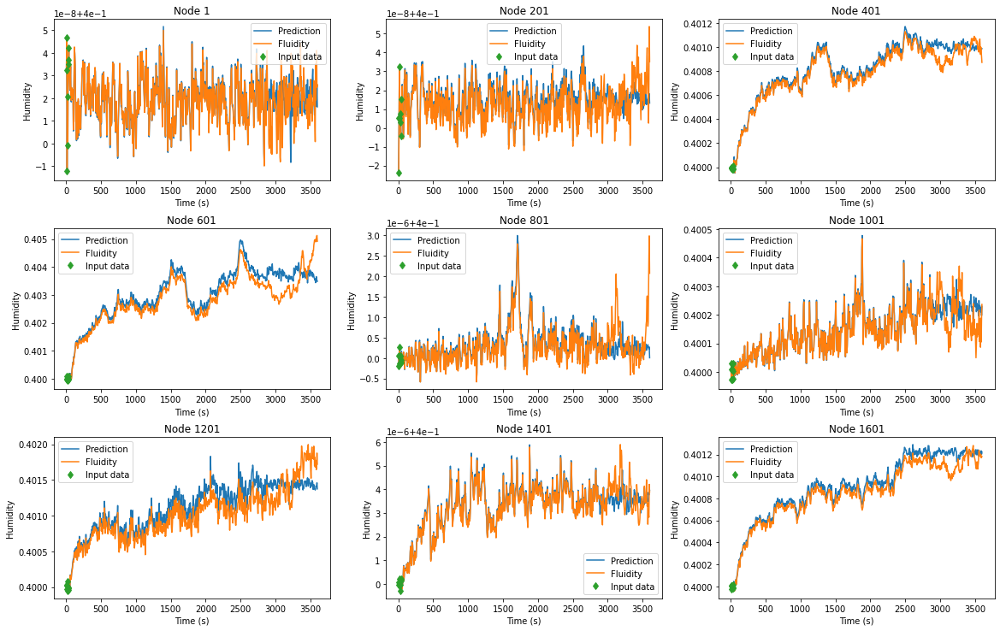

In [ ]:
plot_output(pred_Humidity, CFD_Humidity, 'Humidity')

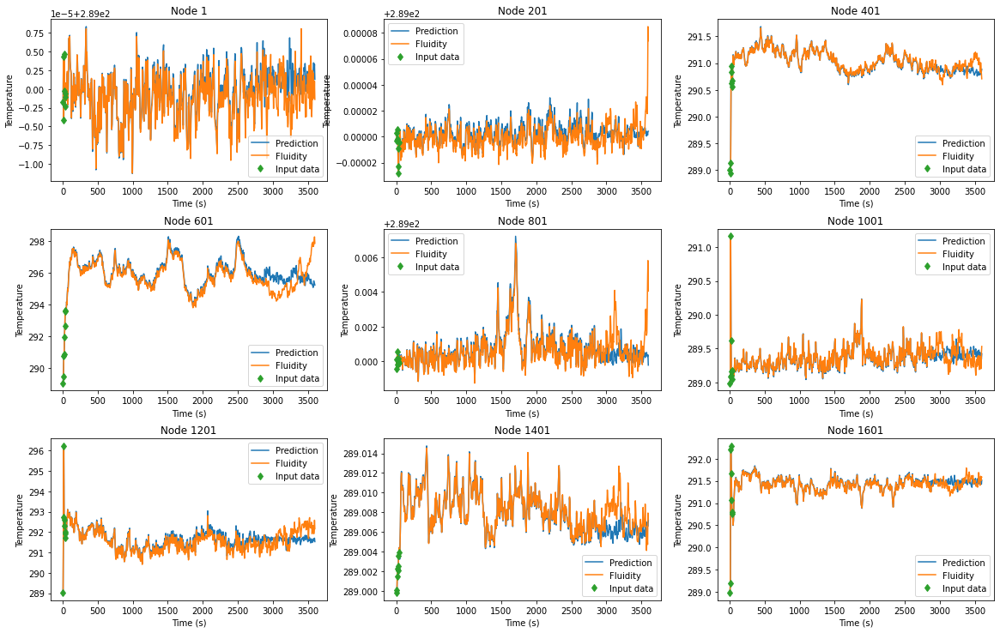

In [ ]:
plot_output(pred_Temperature, CFD_Temperature, 'Temperature')

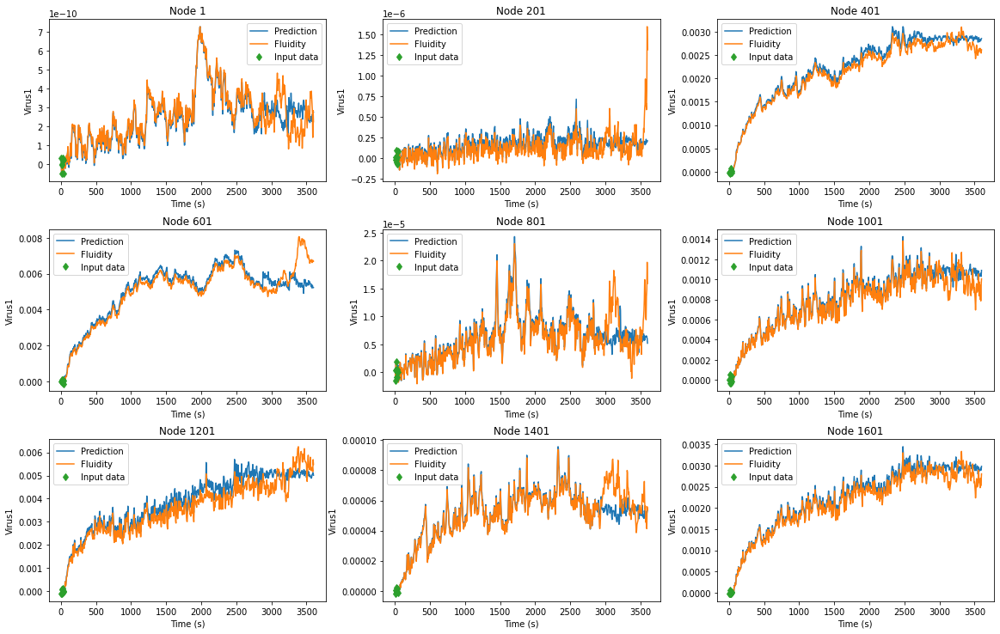

In [ ]:
plot_output(pred_Virus1, CFD_Virus1, 'Virus1')

# Basic Data Assimilation

In [ ]:
import random
times = random.sample(range(0, 720), 650)
times.sort()
#print(times)

X_obs = []
# Get the observation data
for time in times:
  X_obs.append(ob_all_values[time])
# Add the corresponding time level to the observation data for DA
X_obs = np.array(X_obs)
times = np.array(times).reshape(len(times),1)
X_obs = np.hstack((times,X_obs))

## Data assimilation

In [ ]:
# start data assimilation at timestamp t.
t = 0
x_axis_DA = np.linspace(t+1, 720, 720-t)
weight = 70   #set 1 if dynamic relaxation is used, here we use over relaxation

In [ ]:
x_axis_DA

array([  1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,  11.,
        12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,  22.,
        23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,  33.,
        34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,  44.,
        45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,  55.,
        56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,  66.,
        67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,  77.,
        78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,  88.,
        89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,  99.,
       100., 101., 102., 103., 104., 105., 106., 107., 108., 109., 110.,
       111., 112., 113., 114., 115., 116., 117., 118., 119., 120., 121.,
       122., 123., 124., 125., 126., 127., 128., 129., 130., 131., 132.,
       133., 134., 135., 136., 137., 138., 139., 140., 141., 142., 143.,
       144., 145., 146., 147., 148., 149., 150., 15

First backward march

In [ ]:
# Extract the value of the last m-1 continuous time level in the prediction
real_value = X_predict[-(input_timestamps - 1):,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
# Set value of time level n-m as same as that of time level n-m+1
initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)

# Set the range of the time level for prediction
march_range = np.arange(time_steps-(input_timestamps-1), time_steps)
# Extract observation data
obs_data = process_obs_data(march_range, X_obs)
# Predict a point backward in time with observation data
prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)

# Update input and initial guess
X_predict_backward = list(prediction_values.numpy().reshape(-1,total_coeffs))
# prediction of the mth time level from the bottom
gen_predict = prediction_values[:,:1,:,:]
# Add the predicted value to the input
real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
# Set for the next iteration
initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)

# Predict backward with observation data
for i in tqdm.tqdm(range(1, forward_steps-t)):
    # Set the range of the time level for prediction
    march_range = np.arange(time_steps - (input_timestamps - 1) - i, time_steps - i)
    # get observation data
    obs_data = process_obs_data(march_range, X_obs)

    prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)

    # Update input and initial guess
    gen_predict = prediction_values[:,:1,:,:].numpy()
    X_predict_backward.insert(0,gen_predict.flatten())
    real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
    initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)
X_predict_backward = np.array(X_predict_backward, dtype = np.float32)

100%|██████████| 711/711 [01:32<00:00,  7.70it/s]


Iterations for forward and backward march

In [ ]:
DA = []
for j in range(10):
    print(f'\nIteration {j}: forward and backward')

    print('-- Forward March --') 
    forward_loss_i = []

    # Set time level n-m to n-1 as the input  
    real_coding = X_predict_backward[:input_timestamps - 1,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
    # Set value of time level n as same as that of time level n-1
    initial_pred = np.concatenate((real_coding, real_coding[:,-1:,:,:]), axis=1)
    # Set the range of the time level for prediction
    march_range = np.arange(0, input_timestamps)
    # Extract observation data
    obs_data = process_obs_data(march_range, X_obs)
    # Predict data for one time level forward in time (time level m-1)
    prediction_values,loss = predict_coding_forward(initial_pred, real_coding, obs_data)
    forward_loss_i.append(loss)

    # Predict backward with observation data
    X_predict_forward = list(prediction_values.numpy().reshape(-1,total_coeffs))
    gen_predict = prediction_values[:,(input_timestamps - 1):,:,:]
    real_coding = np.concatenate((real_coding[:,1:,:,:], gen_predict), axis=1)
    initial_pred = np.concatenate((real_coding, real_coding[:,-1:,:,:]), axis=1)

    # Predict backward with observation data
    for i in tqdm.tqdm(range(1, forward_steps-t)):
        # Set the range of the time level for prediction
        march_range = np.arange(i, (input_timestamps - 1) + i)
        # get observation data
        obs_data = process_obs_data(march_range, X_obs)

        prediction_values,loss = predict_coding_forward(initial_pred, real_coding, obs_data)
        forward_loss_i.append(loss)

        # Update input and initial guess
        gen_predict = prediction_values[:,(input_timestamps - 1):,:,:].numpy()
        X_predict_forward.append(gen_predict.flatten())
        real_coding = np.concatenate((real_coding[:,1:,:,:], gen_predict), axis=1)
        initial_pred = np.concatenate((real_coding, real_coding[:,-1:,:,:]), axis=1)
    X_predict_forward = np.array(X_predict_forward)
    DA.append(np.array(forward_loss_i).mean())

    print('-- Backward March --')
    backward_loss_i = []

    # Extract the value of the last m-1 continuous time level in the prediction
    real_value = X_predict_forward[-(input_timestamps - 1):,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
    # Set value of time level n-m as same as that of time level n-m+1
    initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)
    
    # Set the range of the time level for prediction
    march_range = np.arange(time_steps-(input_timestamps-1), time_steps)
    # Extract observation data
    obs_data = process_obs_data(march_range, X_obs)
    # Predict a point backward in time with observation data
    prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)
    backward_loss_i.append(loss)

    X_predict_backward2 = list(prediction_values.numpy().reshape(-1, total_coeffs))
    # Update input and initial guess
    gen_predict = prediction_values[:,:1,:,:]
    # Add the predicted value to the input
    real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
    # Set for the next iteration
    initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)

    # Predict backward with observation data
    for i in tqdm.tqdm(range(1, forward_steps-t)):
        # Set the range of the time level for prediction
        march_range = np.arange(time_steps - (input_timestamps - 1) - i, time_steps - i)
        # get observation data
        obs_data = process_obs_data(march_range, X_obs)

        prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)
        backward_loss_i.append(loss)

        # Update input and initial guess
        gen_predict = prediction_values[:,:1,:,:].numpy()
        X_predict_backward2.insert(0,gen_predict.flatten())
        real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
        initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)
    X_predict_backward2 = np.array(X_predict_backward2)
    DA.append(np.array(backward_loss_i).mean())
    print(DA[-1], DA[-2])
    # Do relaxation
    # if j>0:
    #   if DA[-2]-DA[-1]<1e-4 and DA[-2]<1e-3:
    #     break
    #   if DA[-2]-DA[-1]>0:
    #     weight = weight * 0.5
    #   else:
    #     weight = 1.5 * weight
    #   if weight > 1:
    #     weight = 1


Iteration 0: forward and backward
-- Forward March --


100%|██████████| 711/711 [01:32<00:00,  7.68it/s]


-- Backward March --


100%|██████████| 711/711 [01:32<00:00,  7.67it/s]


0.00053608936 0.0006518041

Iteration 1: forward and backward
-- Forward March --


100%|██████████| 711/711 [01:31<00:00,  7.75it/s]


-- Backward March --


100%|██████████| 711/711 [01:30<00:00,  7.84it/s]


0.0005360954 0.0006518041

Iteration 2: forward and backward
-- Forward March --


100%|██████████| 711/711 [01:31<00:00,  7.73it/s]


-- Backward March --


100%|██████████| 711/711 [01:31<00:00,  7.77it/s]


0.0005163875 0.00065131043

Iteration 3: forward and backward
-- Forward March --


100%|██████████| 711/711 [01:31<00:00,  7.78it/s]


-- Backward March --


100%|██████████| 711/711 [01:32<00:00,  7.71it/s]

0.0006503285 0.0006313085


Last forward march

In [ ]:
last_forward_loss = []

# Set time level n-m to n-1 as the input
real_value = X_predict_backward2[:input_timestamps - 1,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
# Set value of time level n-m as same as that of time level n-m+1
initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)

# Predict data for one time level forward in time (time level m-1)
prediction_values,loss = predict_coding_forward_basic(initial_pred, real_value)
last_forward_loss.append(loss)

# Update input and initial guess
X_predict_last = list(prediction_values.numpy().reshape(-1,total_coeffs))
# prediction of time level n
gen_predict = prediction_values[:,(input_timestamps - 1):,:,:]
# Add the predicted value to the real value
real_value = np.concatenate((real_value[:,1:,:,:], gen_predict), axis=1)
# Set value of time level n as same as that of time level n-1
initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)

# Predict forward in time without observation data
for i in tqdm.tqdm(range(1, forward_steps-t)):
    prediction_values, loss = predict_coding_forward_basic(initial_pred, real_value)
    last_forward_loss.append(loss)

    # Update input values and initial guess
    gen_predict = prediction_values[:,(input_timestamps - 1):,:,:].numpy()
    X_predict_last.append(gen_predict.flatten())
    real_value = np.concatenate((real_value[:,1:,:,:], gen_predict), axis=1)
    initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)
X_predict_last = np.array(X_predict_last)

print(X_predict_last)

100%|██████████| 711/711 [01:27<00:00,  8.11it/s]

[[0.9827513  0.978011   0.6126174  ... 0.01030965 0.01502489 0.0144365 ]
 [0.98561424 0.9867951  0.6259512  ... 0.01156173 0.03708482 0.01141908]
 [0.98922276 0.99387425 0.60810614 ... 0.01057038 0.02916485 0.01209245]
 ...
 [0.00960478 0.3644748  0.397192   ... 0.9369089  0.8477287  0.9415831 ]
 [0.01148702 0.36756063 0.41980356 ... 0.93484676 0.83662075 0.93867   ]
 [0.01082661 0.3675853  0.4371736  ... 0.9352373  0.84494305 0.9381906 ]]


## Split the results into nodes and sensors parts

In [ ]:
pod_pred_DA = X_predict_last[:,:coeffs_num]
sensors_pred_DA = X_predict_last[:,coeffs_num:]

## Process sensor results

In [ ]:
pred_sensor_split_DA = np.hsplit(sensors_pred_DA, 7)

In [ ]:
# Undo (0,1) scaling
pred_sensor_CO2_DA = scaler_ob_CO2_all.inverse_transform(pred_sensor_split_DA[0])
pred_sensor_xdata_DA = scaler_ob_xdata_all.inverse_transform(pred_sensor_split_DA[1])
pred_sensor_ydata_DA = scaler_ob_ydata_all.inverse_transform(pred_sensor_split_DA[2])
pred_sensor_zdata_DA = scaler_ob_zdata_all.inverse_transform(pred_sensor_split_DA[3])
pred_sensor_Humidity_DA = scaler_ob_Humidity_all.inverse_transform(pred_sensor_split_DA[4])
pred_sensor_Temperature_DA = scaler_ob_Temperature_all.inverse_transform(pred_sensor_split_DA[5])
pred_sensor_Virus1_DA = scaler_ob_Virus1_all.inverse_transform(pred_sensor_split_DA[6])

## Plot the results of sensors after apply DA

In [ ]:
def plot_output_sensor_DA(predict_data, CFD_data, DA_data, filename):
  fig, ax = plt.subplots(6, 3, figsize=[18,12])
  fig.tight_layout(h_pad=3.5, w_pad=3.5)
  for i in range(18):
    ax.flatten()[i].plot(x_axis*5, predict_data[n:real_timestamp+prediction_num,i], '-')
    ax.flatten()[i].plot(x_axis*5, CFD_data[n:real_timestamp+prediction_num,i], '-')
    ax.flatten()[i].plot(x_axis_DA*5, DA_data[:,i], '-')
    ax.flatten()[i].legend(['Prediction', 'Fluidity', 'Data assimilation'])
    ax.flatten()[i].set_title('Sensor '+ str(i+1))
    ax.flatten()[i].set_xlabel('Time (s)')
    ax.flatten()[i].set_ylabel(filename)
  path = '/content/drive/MyDrive/output_files/Figures/Figures_with_DA_Applied/sensors/All_set/obs_data/'+str(filename)+'_DA.png'
  plt.savefig(path)

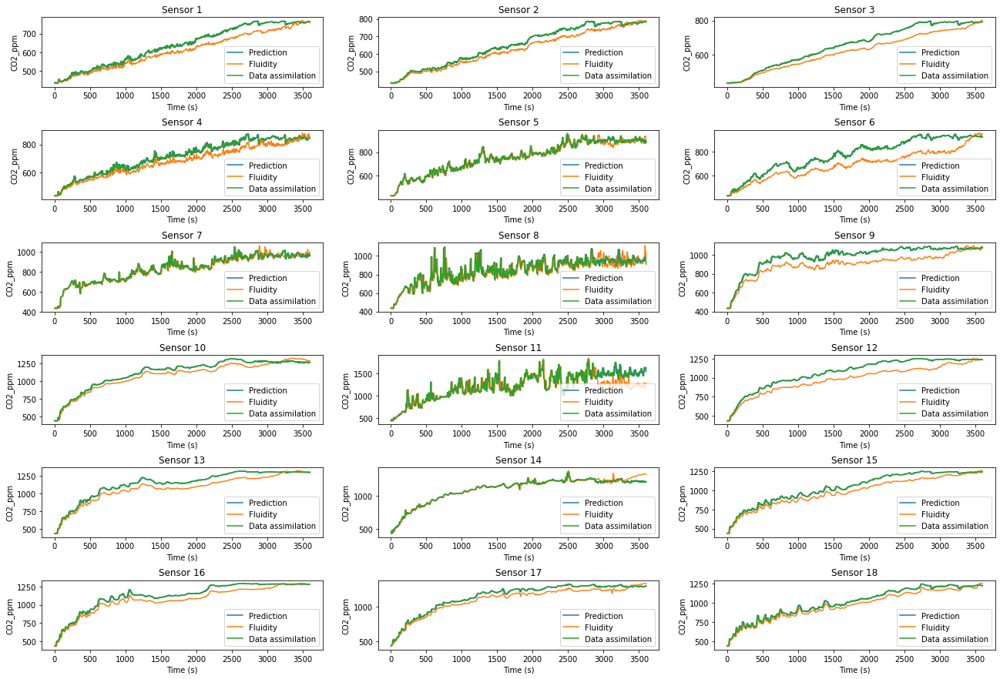

In [ ]:
plot_output_sensor_DA(pred_sensor_CO2, ob_CO2_all, pred_sensor_CO2_DA, 'CO2_ppm')

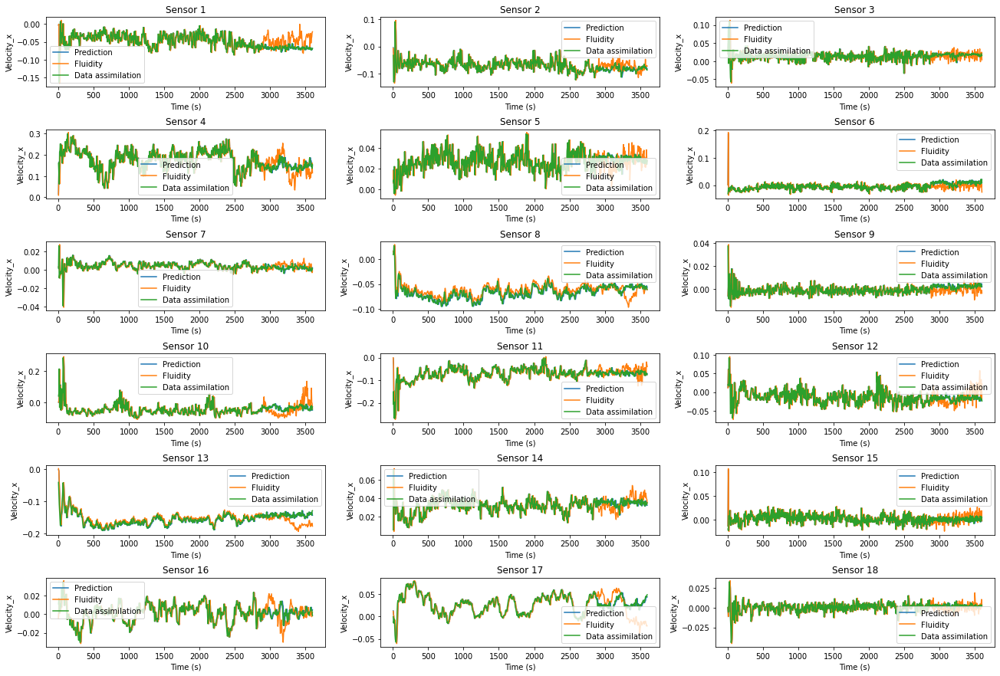

In [ ]:
plot_output_sensor_DA(pred_sensor_xdata, ob_xdata_all, pred_sensor_xdata_DA, 'Velocity_x')

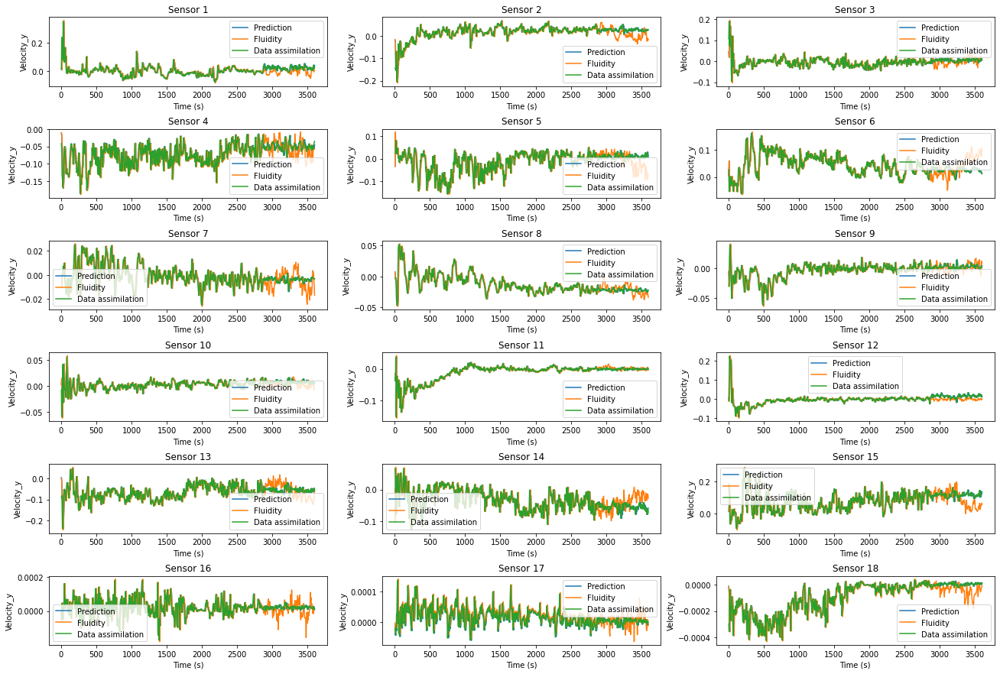

In [ ]:
plot_output_sensor_DA(pred_sensor_ydata, ob_ydata_all, pred_sensor_ydata_DA, 'Velocity_y')

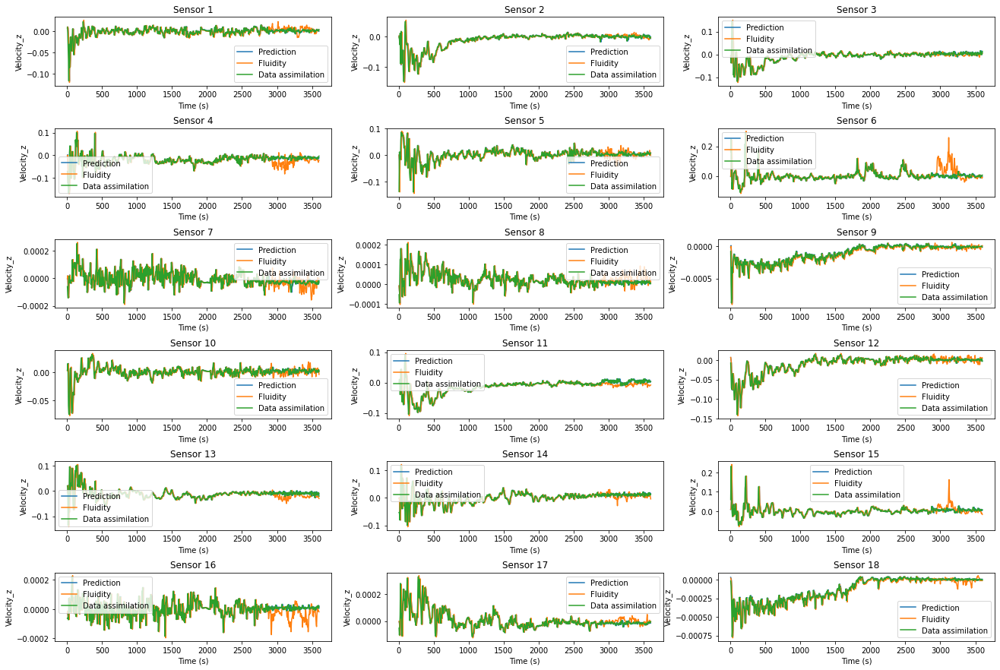

In [ ]:
plot_output_sensor_DA(pred_sensor_zdata, ob_zdata_all, pred_sensor_zdata_DA, 'Velocity_z')

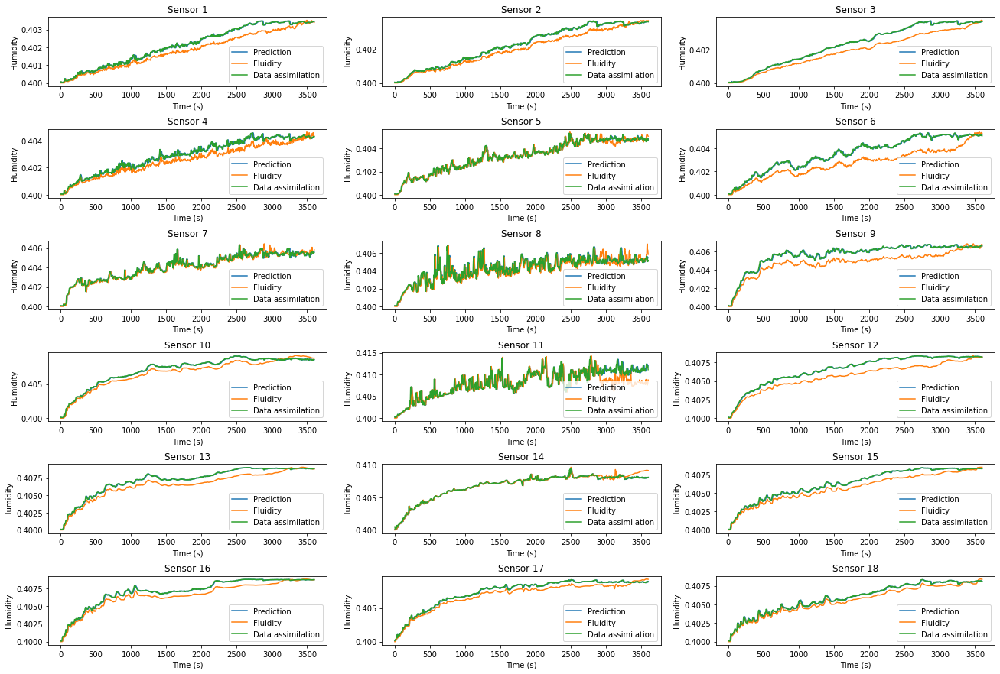

In [ ]:
plot_output_sensor_DA(pred_sensor_Humidity, ob_Humidity_all, pred_sensor_Humidity_DA, 'Humidity')

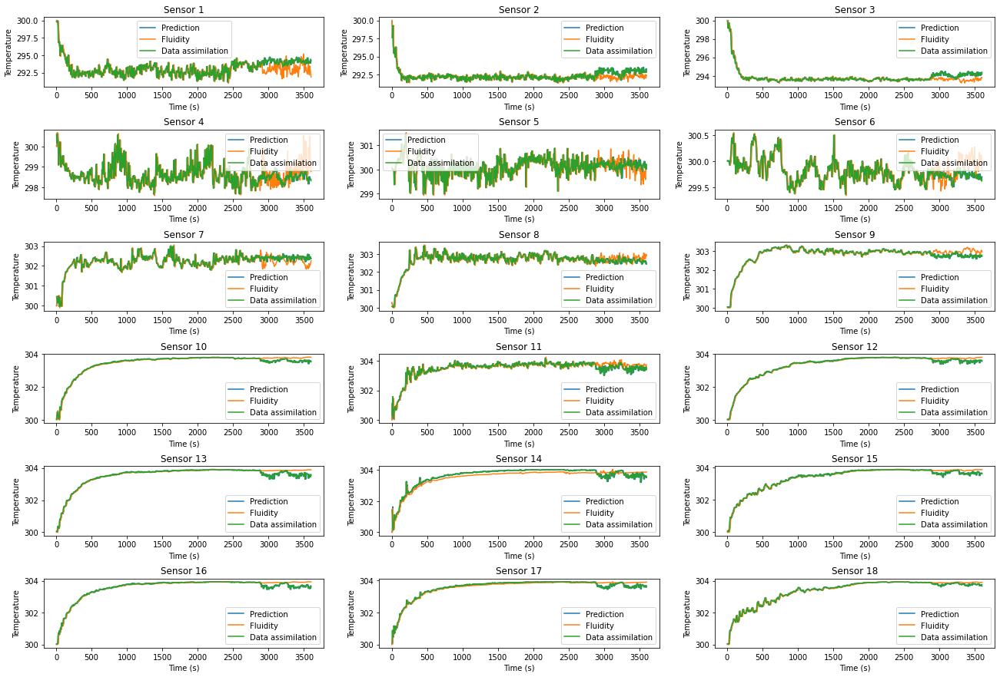

In [ ]:
plot_output_sensor_DA(pred_sensor_Temperature, ob_Temperature_all, pred_sensor_Temperature_DA, 'Temperature')

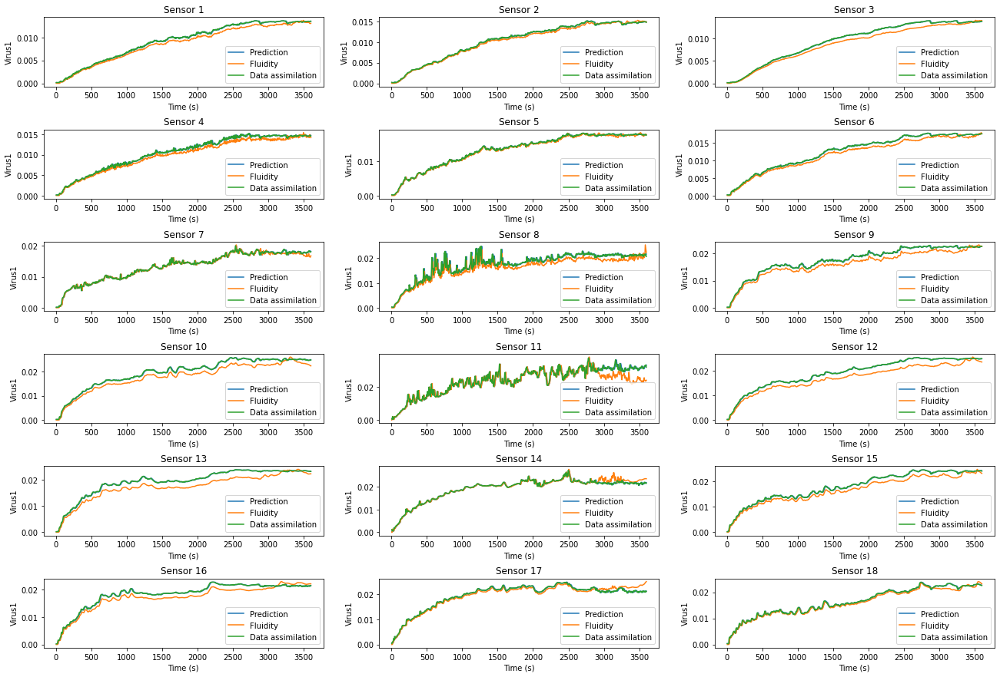

In [ ]:
plot_output_sensor_DA(pred_sensor_Virus1, ob_Virus1_all, pred_sensor_Virus1_DA, 'Virus1')

## Process nodes results

In [ ]:
# Undo (0,1) scaling
X_DA_inverse_01 = scaler_01.inverse_transform(pod_pred_DA)
# Undo PCA to obtain a scaled snapshot matrix
X_DA_inverse_PCA = pca_compress.inverse_transform(X_DA_inverse_01)
# Split to CO2 and three dimensions of velocity data
X_DA_predict_split = np.hsplit(X_DA_inverse_PCA, 7)
# Undo (−1,1) scaling
DA_pred_CO2 = scaler_CO2_all.inverse_transform(X_DA_predict_split[0])
DA_pred_Velocity_x = scaler_x_all.inverse_transform(X_DA_predict_split[1])
DA_pred_Velocity_y = scaler_y_all.inverse_transform(X_DA_predict_split[2])
DA_pred_Velocity_z = scaler_z_all.inverse_transform(X_DA_predict_split[3])
DA_pred_Humidity = scaler_Humidity_all.inverse_transform(X_DA_predict_split[4])
DA_pred_Temperature = scaler_Temperature_all.inverse_transform(X_DA_predict_split[5])
DA_pred_Virus1 = scaler_Virus1_all.inverse_transform(X_DA_predict_split[6])

## Plot the results of nodes after apply DA

In [ ]:
def plot_output_DA(predict_data, CFD_data, DA_data, filename):
  fig, ax = plt.subplots(3, 3, figsize=[16,10])
  fig.tight_layout(h_pad=3.5, w_pad=3.5)
  for i in range(9):
    ax.flatten()[i].plot(x_axis*5, predict_data[n:n+real_timestamp+prediction_num,i*200], '-')
    ax.flatten()[i].plot(x_axis*5, CFD_data[n:n+(real_timestamp+prediction_num)*step:step,i*200], '-')
    ax.flatten()[i].plot(x_axis_DA*5, DA_data[n:n+real_timestamp+prediction_num,i*200], '-')
    ax.flatten()[i].legend(['Prediction without DA', 'Fluidity', 'Data assimilation'])
    ax.flatten()[i].set_title('Node '+ str(i*200+1))
    ax.flatten()[i].set_xlabel('Time (s)')
    ax.flatten()[i].set_ylabel(filename)
  path = '/content/drive/MyDrive/output_files/Figures/Figures_with_DA_Applied/nodes/All_set/obs_data/'+str(filename)+'_DA.png'
  plt.savefig(path)

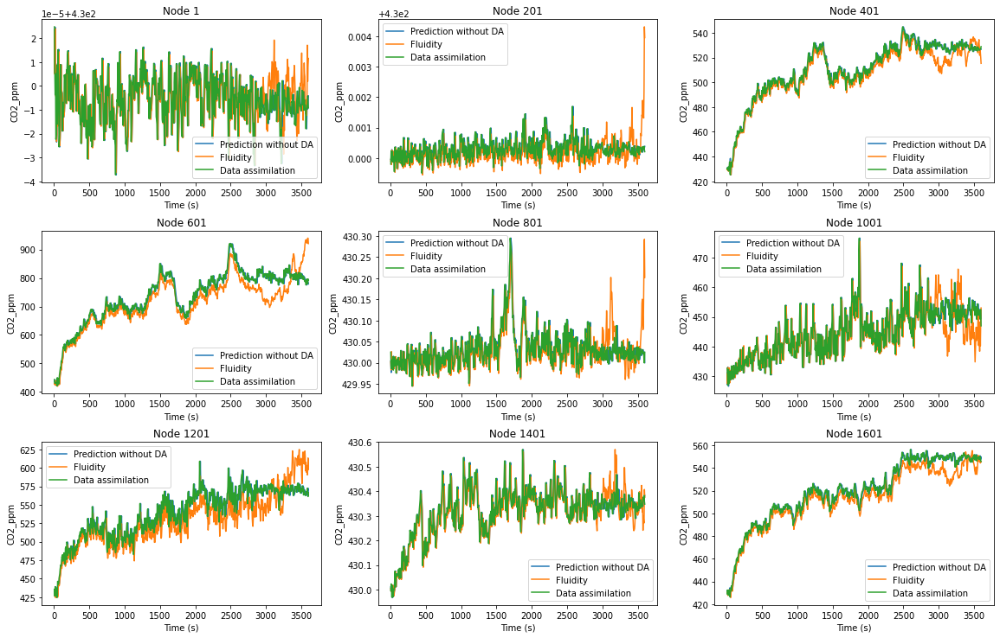

In [ ]:
plot_output_DA(pred_CO2, CFD_CO2, DA_pred_CO2, 'CO2_ppm')

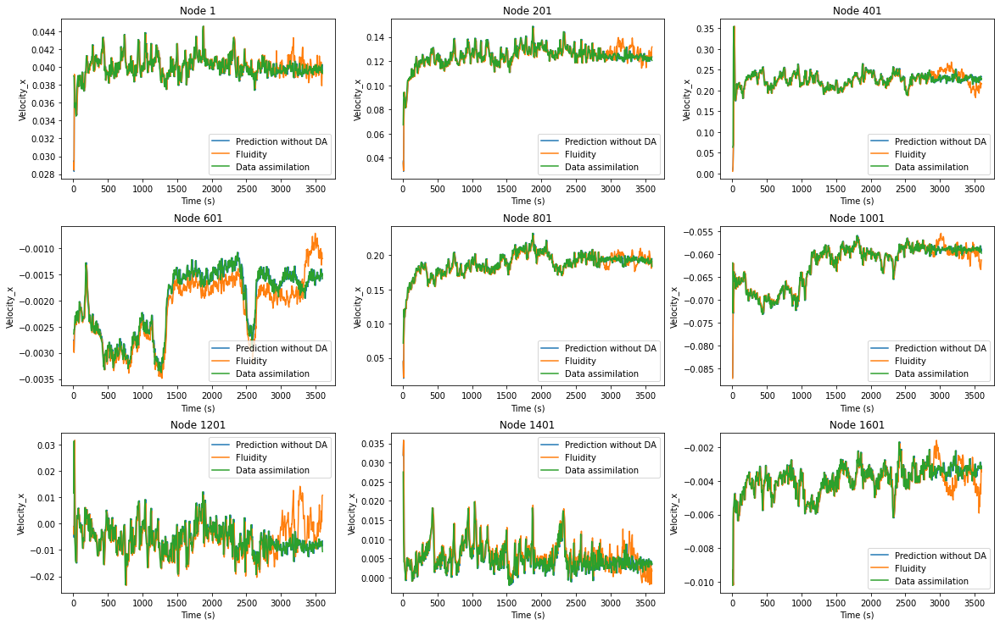

In [ ]:
plot_output_DA(pred_Velocity_x, CFD_Velocity_x, DA_pred_Velocity_x, 'Velocity_x')

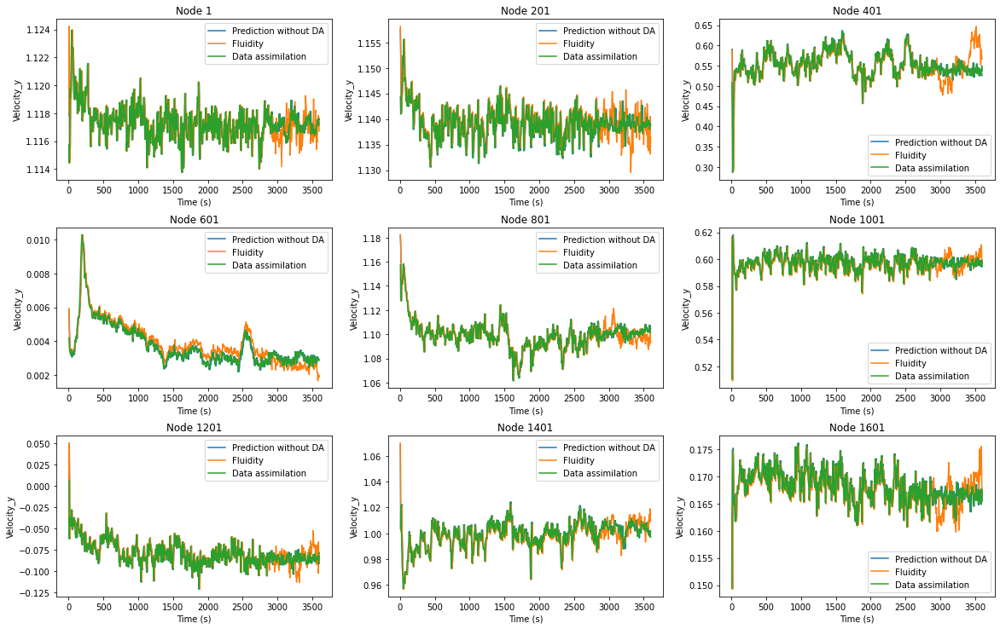

In [ ]:
plot_output_DA(pred_Velocity_y, CFD_Velocity_y, DA_pred_Velocity_y, 'Velocity_y')

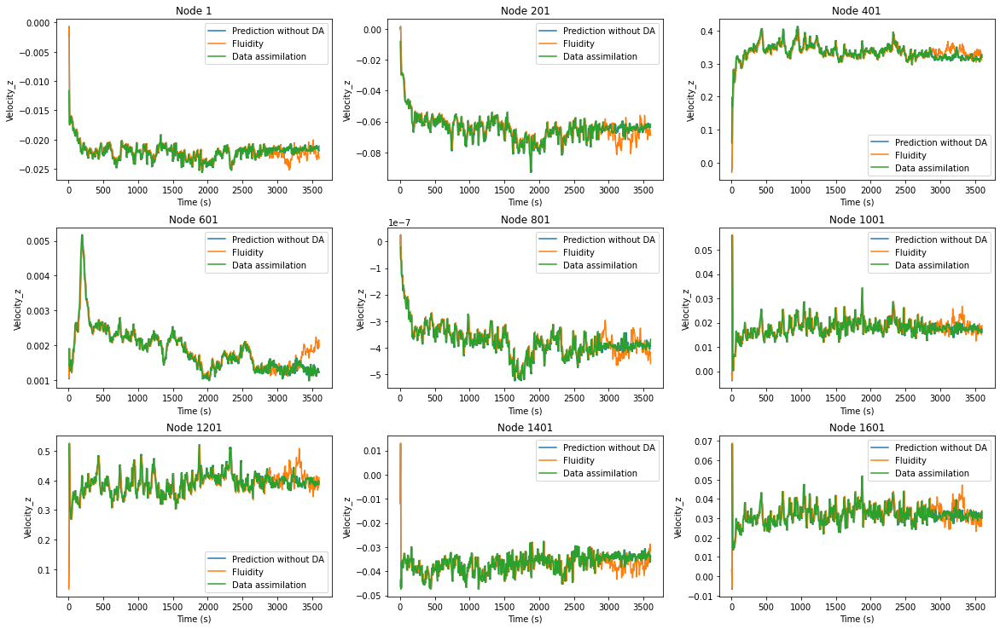

In [ ]:
plot_output_DA(pred_Velocity_z, CFD_Velocity_z, DA_pred_Velocity_z, 'Velocity_z')

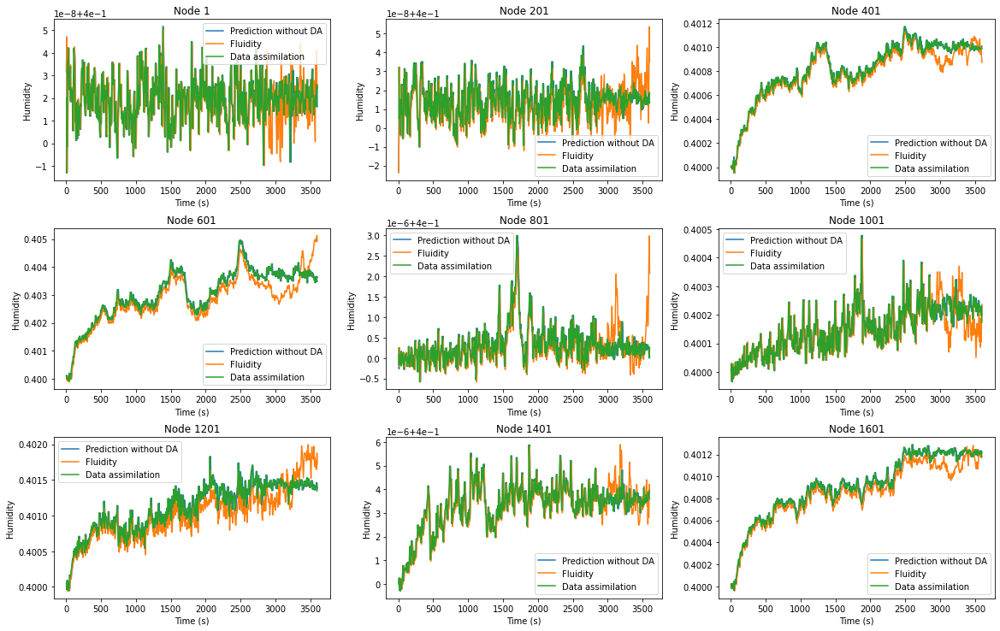

In [ ]:
plot_output_DA(pred_Humidity, CFD_Humidity, DA_pred_Humidity, 'Humidity')

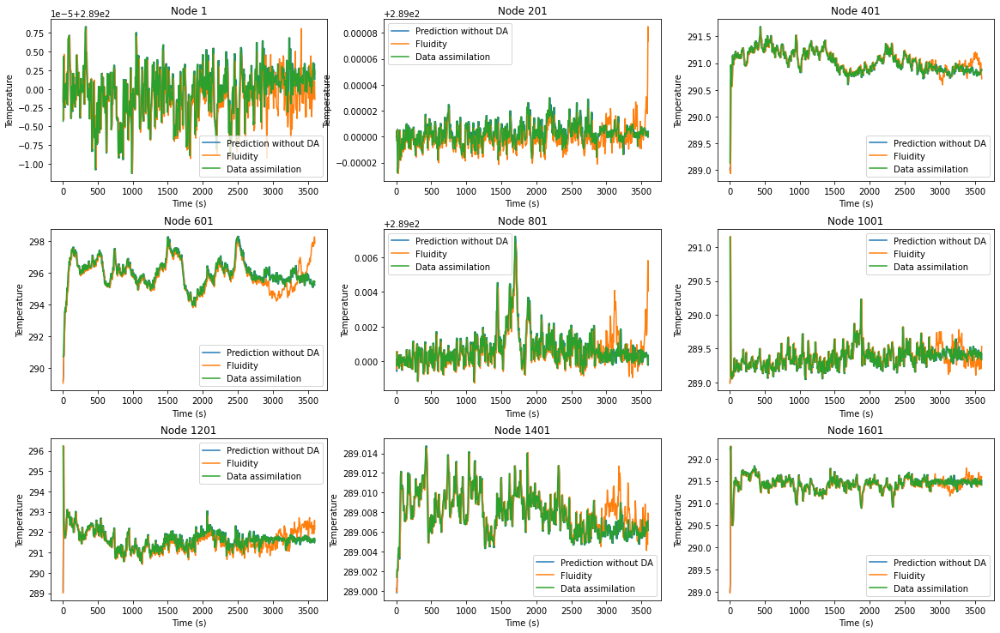

In [ ]:
plot_output_DA(pred_Temperature, CFD_Temperature, DA_pred_Temperature, 'Temperature')

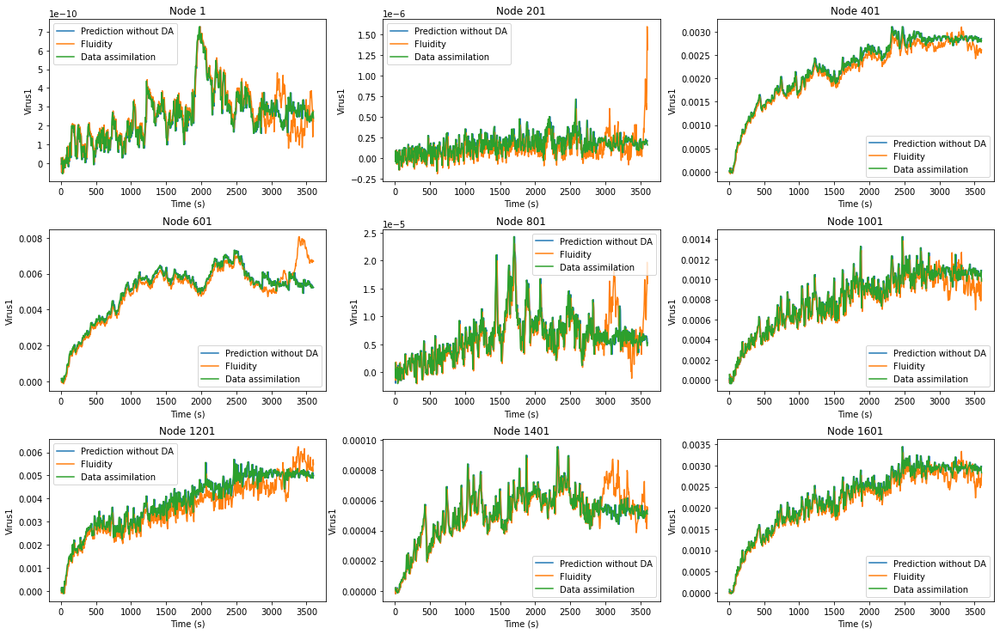

In [ ]:
plot_output_DA(pred_Virus1, CFD_Virus1, DA_pred_Virus1, 'Virus1')

## Output result to vtu file

In [ ]:
!pip -q install vtk

     |████████████████████████████████| 88.3 MB 142 kB/s 


In [ ]:
import os
os.chdir("/content/drive/MyDrive")
import vtktools
from tools_io import get_nNodes_from_vtu, get_clean_vtu_file

def write_example_to_vtu(i, exm_num, filepath):
  # get clean vtu file
  snapshot_data_location = '/content/drive/MyDrive/Cotrace_fixed_final/'
  snapshot_file_base = 'Cotrace_fixed_'
  filename = snapshot_data_location + snapshot_file_base + '582.vtu'
  clean_vtu = get_clean_vtu_file(filename)

  # write results to vtu
  nNodes = get_nNodes_from_vtu(snapshot_data_location, snapshot_file_base)
  CO2_ppm = np.zeros((nNodes,1))
  velocity = np.zeros((nNodes,3))
  humidity = np.zeros((nNodes,1))
  temperature = np.zeros((nNodes,1))
  virus1 = np.zeros((nNodes,1))

  new_vtu = vtktools.vtu()
  new_vtu.ugrid.DeepCopy(clean_vtu.ugrid)
  new_vtu.filename = filepath + str(exm_num) + '.vtu'

  CO2_ppm[:] = pred_CO2[i].reshape((192060, 1),order='F')
  velocity[:,0] = pred_Velocity_x[i].reshape((192060),order='F')
  velocity[:,1] = pred_Velocity_y[i].reshape((192060),order='F')
  velocity[:,2] = pred_Velocity_z[i].reshape((192060),order='F')
  humidity = pred_Humidity[i].reshape((192060, 1),order='F')
  temperature = pred_Temperature[i].reshape((192060, 1),order='F')
  virus1 = pred_Virus1[i].reshape((192060, 1),order='F')

  new_vtu.AddField('Tracer', CO2_ppm)
  new_vtu.AddField('Velocity', velocity)
  new_vtu.AddField('Humidity', humidity)
  new_vtu.AddField('Temperature', temperature)
  new_vtu.AddField('Virus1', virus1)
  new_vtu.Write()

### Write prediction results to .vtu files

In [ ]:
import tqdm
start = 1
end = 720
i = 0
for filenum in tqdm.tqdm(range(start,end+1,1)):
  path = 'output_files/vtu_files/DA_applied/All_set/Prediction/output_'
  write_example_to_vtu(i, filenum, path)
  i += 1

100%|██████████| 720/720 [1:04:23<00:00,  5.37s/it]


In [ ]:
import tqdm
start = 1
end = 720
i = 0
for filenum in tqdm.tqdm(range(start,end+1,6)):
  path = 'output_files/vtu_files/sparse_output/DA_applied/All_set/Prediction/output_'
  write_example_to_vtu(i, filenum, path)
  i += 6

100%|██████████| 120/120 [10:40<00:00,  5.34s/it]


### Write data assimilation results to .vtu files

In [ ]:
import os
os.chdir("/content/drive/MyDrive")
import vtktools
from tools_io import get_nNodes_from_vtu, get_clean_vtu_file

def write_example_to_vtu_DA(i, exm_num, filepath):
  # get clean vtu file
  snapshot_data_location = '/content/drive/MyDrive/Cotrace_fixed_final/'
  snapshot_file_base = 'Cotrace_fixed_'
  filename = snapshot_data_location + snapshot_file_base + '582.vtu'
  clean_vtu = get_clean_vtu_file(filename)

  # write results to vtu
  nNodes = get_nNodes_from_vtu(snapshot_data_location, snapshot_file_base)
  CO2_ppm = np.zeros((nNodes,1))
  velocity = np.zeros((nNodes,3))
  humidity = np.zeros((nNodes,1))
  temperature = np.zeros((nNodes,1))
  virus1 = np.zeros((nNodes,1))

  new_vtu = vtktools.vtu()
  new_vtu.ugrid.DeepCopy(clean_vtu.ugrid)
  new_vtu.filename = filepath + str(exm_num) + '.vtu'

  CO2_ppm[:] = DA_pred_CO2[i].reshape((192060, 1),order='F')
  velocity[:,0] = DA_pred_Velocity_x[i].reshape((192060),order='F')
  velocity[:,1] = DA_pred_Velocity_y[i].reshape((192060),order='F')
  velocity[:,2] = DA_pred_Velocity_z[i].reshape((192060),order='F')
  humidity = DA_pred_Humidity[i].reshape((192060, 1),order='F')
  temperature = DA_pred_Temperature[i].reshape((192060, 1),order='F')
  virus1 = DA_pred_Virus1[i].reshape((192060, 1),order='F')

  new_vtu.AddField('Tracer', CO2_ppm)
  new_vtu.AddField('Velocity', velocity)
  new_vtu.AddField('Humidity', humidity)
  new_vtu.AddField('Temperature', temperature)
  new_vtu.AddField('Virus1', virus1)
  new_vtu.Write()

In [ ]:
import tqdm
start = t+1
end = 720
i = 0
for filenum in tqdm.tqdm(range(start,end+1,1)):
  path = 'output_files/vtu_files/DA_applied/All_set/DA/Case_1/output_'
  write_example_to_vtu_DA(i, filenum, path)
  i += 1

100%|██████████| 720/720 [1:04:47<00:00,  5.40s/it]


In [ ]:
import tqdm
start = 1
end = real_timestamp + prediction_num
i = 0
for filenum in tqdm.tqdm(range(start,end+1,6)):
  path = 'output_files/vtu_files/sparse_output/DA_applied/All_set/DA/Case_1/output_'
  write_example_to_vtu_DA(i, filenum, path)
  i += 6

100%|██████████| 120/120 [10:37<00:00,  5.31s/it]


# Test case 1: start DA with CFD data from the middle

In [ ]:
t_start = 360

In [ ]:
import random
times = random.sample(range(0, 720-t_start), 650-t_start+1)
times.sort()
#print(times)

X_obs = []
# Get the observation data
for time in times:
  X_obs.append(ob_all_values[t_start+time])
# Add the corresponding time level to the observation data for DA
X_obs = np.array(X_obs)
times = np.array(times).reshape(len(times),1)
X_obs = np.hstack((times,X_obs))

## Data assimilation

In [ ]:
# start data assimilation at timestamp t.
weight = 70 #set 1 if dynamic relaxation is used, here we use over relaxation
t = t_start
x_axis_DA = np.linspace(t+1, 720, 720-t)

In [ ]:
x_axis_DA

array([361., 362., 363., 364., 365., 366., 367., 368., 369., 370., 371.,
       372., 373., 374., 375., 376., 377., 378., 379., 380., 381., 382.,
       383., 384., 385., 386., 387., 388., 389., 390., 391., 392., 393.,
       394., 395., 396., 397., 398., 399., 400., 401., 402., 403., 404.,
       405., 406., 407., 408., 409., 410., 411., 412., 413., 414., 415.,
       416., 417., 418., 419., 420., 421., 422., 423., 424., 425., 426.,
       427., 428., 429., 430., 431., 432., 433., 434., 435., 436., 437.,
       438., 439., 440., 441., 442., 443., 444., 445., 446., 447., 448.,
       449., 450., 451., 452., 453., 454., 455., 456., 457., 458., 459.,
       460., 461., 462., 463., 464., 465., 466., 467., 468., 469., 470.,
       471., 472., 473., 474., 475., 476., 477., 478., 479., 480., 481.,
       482., 483., 484., 485., 486., 487., 488., 489., 490., 491., 492.,
       493., 494., 495., 496., 497., 498., 499., 500., 501., 502., 503.,
       504., 505., 506., 507., 508., 509., 510., 51

First backward march

In [ ]:
# Extract the value of the last m-1 continuous time level in the prediction
real_value = X_predict[-(input_timestamps - 1):,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
# Set value of time level n-m as same as that of time level n-m+1
initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)

# Set the range of the time level for prediction
march_range = np.arange(time_steps-(input_timestamps-1), time_steps)
# Extract observation data
obs_data = process_obs_data(march_range, X_obs)
# Predict data for one time level forward in time (time level m-1)
prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)

# Update input and initial guess
X_predict_backward = list(prediction_values.numpy().reshape(-1,total_coeffs))
# prediction of the mth time level from the bottom
gen_predict = prediction_values[:,:1,:,:]
# Add the predicted value to the input
real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
# Set for the next iteration
initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)

# Predict backward with observation data
for i in tqdm.tqdm(range(1, forward_steps-t)):
    # Set the range of the time level for prediction
    march_range = np.arange(time_steps - (input_timestamps - 1) - i, time_steps - i)
    # get observation data
    obs_data = process_obs_data(march_range, X_obs)

    prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)

    # Update input and initial guess
    gen_predict = prediction_values[:,:1,:,:].numpy()
    X_predict_backward.insert(0,gen_predict.flatten())
    real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
    initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)
X_predict_backward = np.array(X_predict_backward, dtype = np.float32)

100%|██████████| 351/351 [00:58<00:00,  6.04it/s]


Iterations for forward and backward march

In [ ]:
DA = []
for j in range(10):
    print(f'\nIteration {j}: forward and backward')

    print('-- Forward March --') 
    forward_loss_i = []

    # Extract the value of the first m-1 continuous time level in the prediction   
    real_coding = X_predict_backward[:input_timestamps - 1,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
    # print(real_coding)
    initial_pred = np.concatenate((real_coding, real_coding[:,-1:,:,:]), axis=1)
    # Set the range of the time level that prediction will cover
    march_range = np.arange(0, input_timestamps)
    # Extract observation data within the prediction range
    obs_data = process_obs_data(march_range, X_obs)
    # Predict a point forward in time with obs_data
    prediction_values,loss = predict_coding_forward(initial_pred, real_coding, obs_data)
    forward_loss_i.append(loss)

    # Predict backward with observation data
    X_predict_forward = list(prediction_values.numpy().reshape(-1,total_coeffs))
    gen_predict = prediction_values[:,(input_timestamps - 1):,:,:]
    real_coding = np.concatenate((real_coding[:,1:,:,:], gen_predict), axis=1)
    initial_pred = np.concatenate((real_coding, real_coding[:,-1:,:,:]), axis=1)

    # Predict forward in time with obs_data
    for i in tqdm.tqdm(range(1, forward_steps-t)):
        # Set the range of the time level that prediction will cover
        march_range = np.arange(i, (input_timestamps - 1) + i)
        # Extract observation data within the prediction range
        obs_data = process_obs_data(march_range, X_obs)

        prediction_values,loss = predict_coding_forward(initial_pred, real_coding, obs_data)
        forward_loss_i.append(loss)

        # Update real value and initial guess
        gen_predict = prediction_values[:,(input_timestamps - 1):,:,:].numpy()
        X_predict_forward.append(gen_predict.flatten())
        real_coding = np.concatenate((real_coding[:,1:,:,:], gen_predict), axis=1)
        initial_pred = np.concatenate((real_coding, real_coding[:,-1:,:,:]), axis=1)
    X_predict_forward = np.array(X_predict_forward)
    DA.append(np.array(forward_loss_i).mean())

    print('-- Backward March --')
    backward_loss_i = []

    # Extract the value of the last m-1 continuous time level in the prediction
    real_value = X_predict_forward[-(input_timestamps - 1):,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
    # Set value of time level n-m as same as that of time level n-m+1
    initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)
    
    # Set the range of the time level for prediction
    march_range = np.arange(time_steps-(input_timestamps-1), time_steps)
    # Extract observation data
    obs_data = process_obs_data(march_range, X_obs)
    # Predict a point backward in time with observation data
    prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)
    backward_loss_i.append(loss)

    X_predict_backward2 = list(prediction_values.numpy().reshape(-1, total_coeffs))
    # Update input and initial guess
    gen_predict = prediction_values[:,:1,:,:]
    # Add the predicted value to the input
    real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
    # Set for the next iteration
    initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)

    # Predict backward with observation data
    for i in tqdm.tqdm(range(1, forward_steps-t)):
        # Set the range of the time level for prediction
        march_range = np.arange(time_steps - (input_timestamps - 1) - i, time_steps - i)
        # get observation data
        obs_data = process_obs_data(march_range, X_obs)

        prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)
        backward_loss_i.append(loss)

        # Update input and initial guess
        gen_predict = prediction_values[:,:1,:,:].numpy()
        X_predict_backward2.insert(0,gen_predict.flatten())
        real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
        initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)
    X_predict_backward2 = np.array(X_predict_backward2)
    DA.append(np.array(backward_loss_i).mean())
    print(DA[-1], DA[-2])
    # Do relaxation (DA with dynamic relaxation), comment this if over relaxation is selected.
    # if j>0:
    #   if DA[-2]-DA[-1]<1e-5 and DA[-2]<1e-4:
    #     break
    #   if DA[-2]-DA[-1]>0:
    #     weight = weight * 0.5
    #   else:
    #     weight = 1.5 * weight
    #   if weight > 1:
    #     weight = 1

Last forward march

In [ ]:
last_forward_loss = []

# Set time level n-m to n-1 as the input
real_value = X_predict_backward2[:input_timestamps - 1,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
# Set value of time level n-m as same as that of time level n-m+1
initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)

# Predict data for one time level forward in time (time level m-1)
prediction_values,loss = predict_coding_forward_basic(initial_pred, real_value)
last_forward_loss.append(loss)

# Update input and initial guess
X_predict_last = list(prediction_values.numpy().reshape(-1,total_coeffs))
# prediction of time level n
gen_predict = prediction_values[:,(input_timestamps - 1):,:,:]
# Add the predicted value to the real value
real_value = np.concatenate((real_value[:,1:,:,:], gen_predict), axis=1)
# Set value of time level n as same as that of time level n-1
initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)

# Predict forward in time without observation data
for i in tqdm.tqdm(range(1, forward_steps-t)):
    prediction_values, loss = predict_coding_forward_basic(initial_pred, real_value)
    last_forward_loss.append(loss)

    # Update input values and initial guess
    gen_predict = prediction_values[:,(input_timestamps - 1):,:,:].numpy()
    X_predict_last.append(gen_predict.flatten())
    real_value = np.concatenate((real_value[:,1:,:,:], gen_predict), axis=1)
    initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)
X_predict_last = np.array(X_predict_last)

print(X_predict_last)

100%|██████████| 351/351 [00:56<00:00,  6.21it/s]

[[0.48159143 0.02757419 0.16478546 ... 0.86442    0.7541201  0.495922  ]
 [0.47666195 0.0274974  0.1588611  ... 0.8608273  0.75513655 0.5050578 ]
 [0.47986323 0.02334328 0.14117654 ... 0.8519776  0.75168115 0.51870775]
 ...
 [0.01323472 0.31820253 0.32839856 ... 0.9429779  0.86789024 0.98582107]
 [0.00921324 0.31847823 0.33778614 ... 0.94248545 0.8652738  0.98257184]
 [0.00864746 0.33238977 0.3890114  ... 0.94406176 0.8675116  0.98028255]]


## Split the results into nodes and sensors parts

In [ ]:
pod_pred_DA = X_predict_last[:,:coeffs_num]
sensors_pred_DA = X_predict_last[:,coeffs_num:]

## Process sensor results

In [ ]:
pred_sensor_split_DA = np.hsplit(sensors_pred_DA, 7)

In [ ]:
# Undo (0,1) scaling
pred_sensor_CO2_DA = scaler_ob_CO2_all.inverse_transform(pred_sensor_split_DA[0])
pred_sensor_xdata_DA = scaler_ob_xdata_all.inverse_transform(pred_sensor_split_DA[1])
pred_sensor_ydata_DA = scaler_ob_ydata_all.inverse_transform(pred_sensor_split_DA[2])
pred_sensor_zdata_DA = scaler_ob_zdata_all.inverse_transform(pred_sensor_split_DA[3])
pred_sensor_Humidity_DA = scaler_ob_Humidity_all.inverse_transform(pred_sensor_split_DA[4])
pred_sensor_Temperature_DA = scaler_ob_Temperature_all.inverse_transform(pred_sensor_split_DA[5])
pred_sensor_Virus1_DA = scaler_ob_Virus1_all.inverse_transform(pred_sensor_split_DA[6])

## Plot the results of sensors after apply DA

In [ ]:
x_axis_middle = np.linspace(1, 720-t, 720-t)
x_axis_middle

array([  1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,  11.,
        12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,  22.,
        23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,  33.,
        34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,  44.,
        45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,  55.,
        56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,  66.,
        67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,  77.,
        78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,  88.,
        89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,  99.,
       100., 101., 102., 103., 104., 105., 106., 107., 108., 109., 110.,
       111., 112., 113., 114., 115., 116., 117., 118., 119., 120., 121.,
       122., 123., 124., 125., 126., 127., 128., 129., 130., 131., 132.,
       133., 134., 135., 136., 137., 138., 139., 140., 141., 142., 143.,
       144., 145., 146., 147., 148., 149., 150., 15

In [ ]:
def plot_output_sensor_DA(predict_data, CFD_data, DA_data, filename):
  fig, ax = plt.subplots(6, 3, figsize=[18,12])
  fig.tight_layout(h_pad=3.5, w_pad=3.5)
  for i in range(18):
    ax.flatten()[i].plot(x_axis_middle*5, predict_data[n:real_timestamp+prediction_num-t,i], '-')
    ax.flatten()[i].plot(x_axis_middle*5, CFD_data[n+t:real_timestamp+prediction_num,i], '-')
    ax.flatten()[i].plot(x_axis_middle*5, DA_data[:,i], '-')
    ax.flatten()[i].plot(x_axis_middle*5, CFD_data[n:real_timestamp+prediction_num-t,i], '-')
    ax.flatten()[i].legend(['Prediction', 'CFD_test', 'DA', 'CFD_real'])
    ax.flatten()[i].set_title('Sensor '+ str(i+1))
    ax.flatten()[i].set_xlabel('Time (s)')
    ax.flatten()[i].set_ylabel(filename)
  path = '/content/drive/MyDrive/output_files/Figures/Figures_with_DA_Applied/sensors/All_set/obs_data/case_1/'+str(filename)+'_DA.png'
  plt.savefig(path)

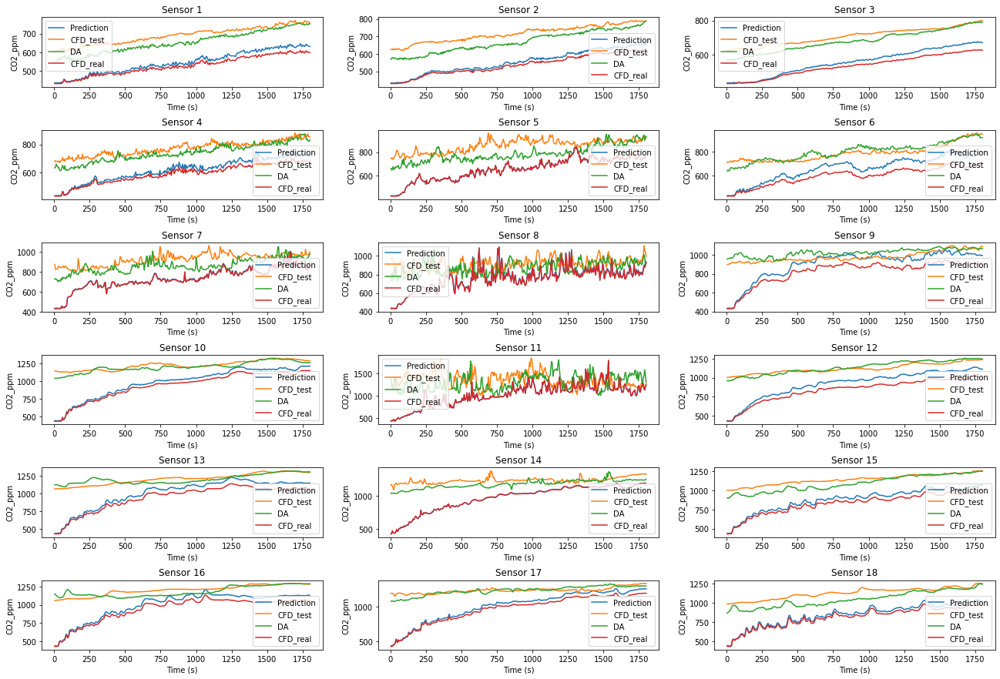

In [ ]:
plot_output_sensor_DA(pred_sensor_CO2, ob_CO2_all, pred_sensor_CO2_DA, 'CO2_ppm')

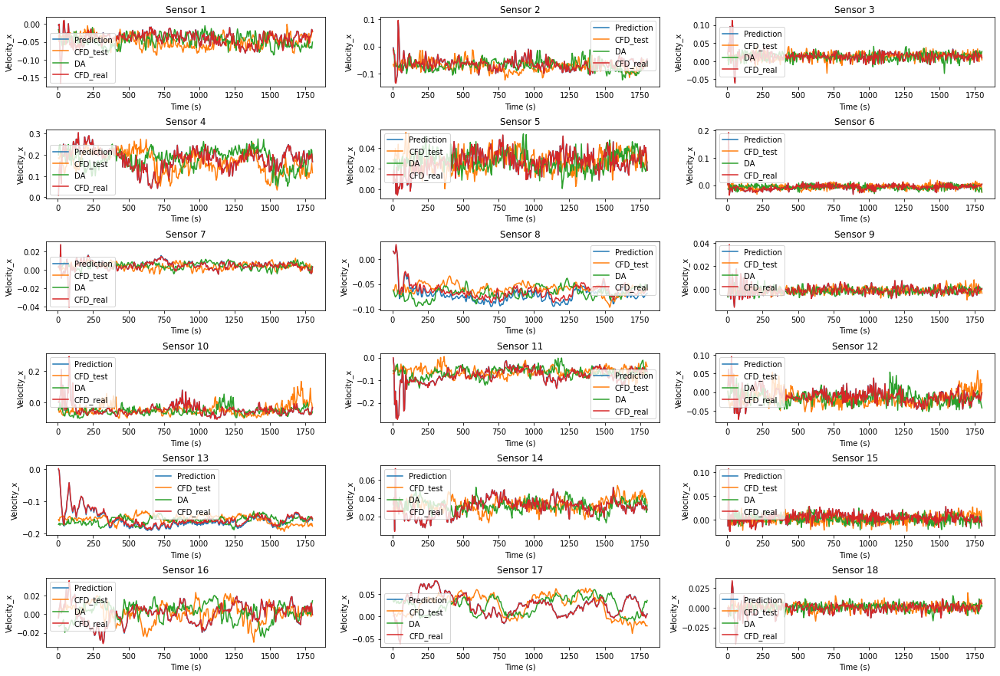

In [ ]:
plot_output_sensor_DA(pred_sensor_xdata, ob_xdata_all, pred_sensor_xdata_DA, 'Velocity_x')

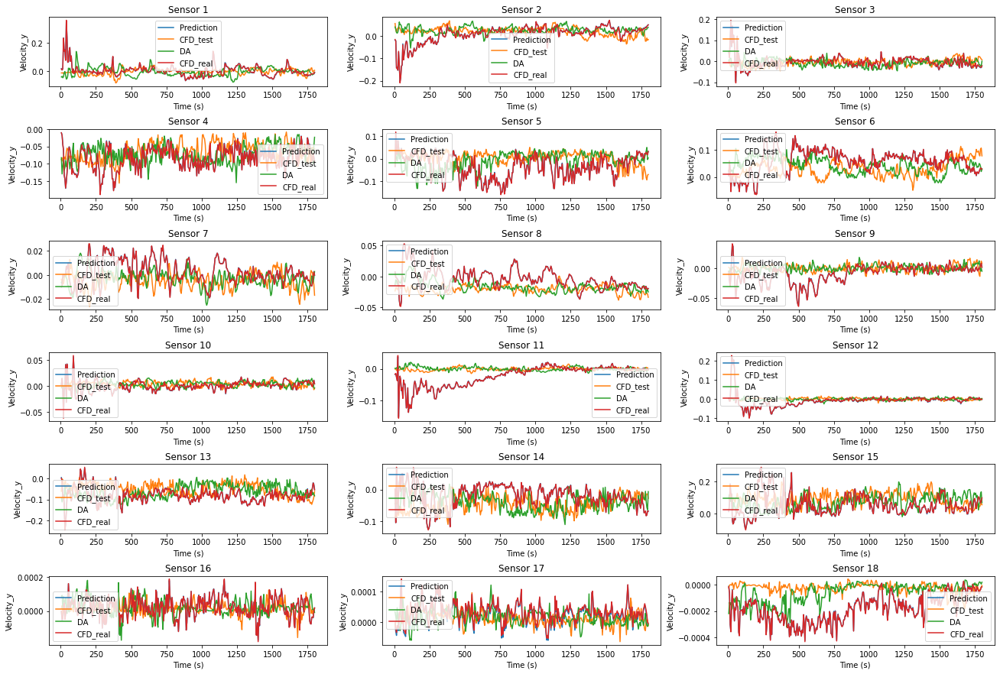

In [ ]:
plot_output_sensor_DA(pred_sensor_ydata, ob_ydata_all, pred_sensor_ydata_DA, 'Velocity_y')

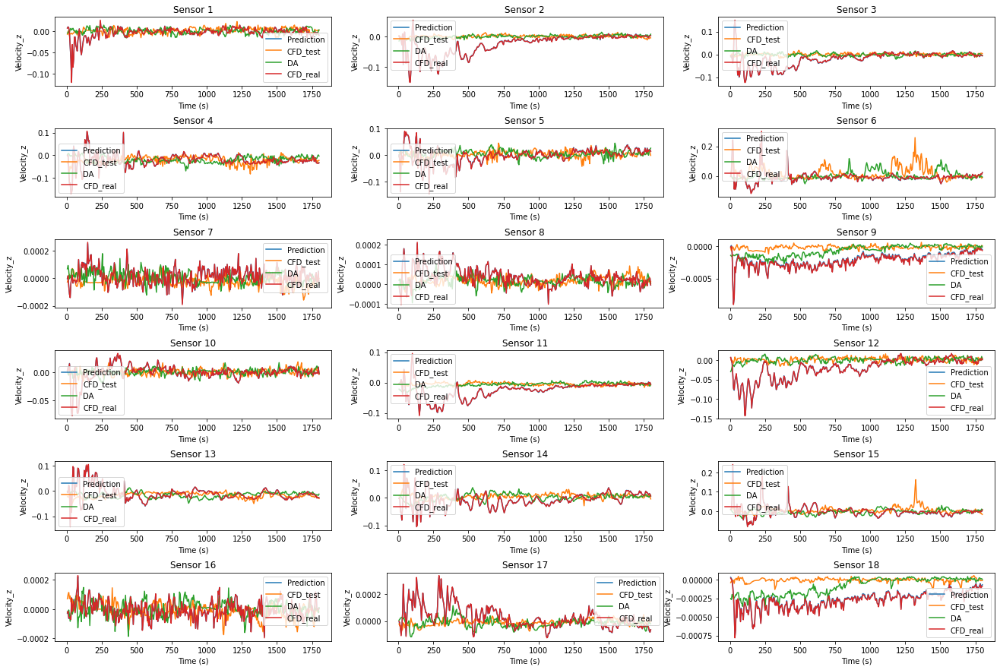

In [ ]:
plot_output_sensor_DA(pred_sensor_zdata, ob_zdata_all, pred_sensor_zdata_DA, 'Velocity_z')

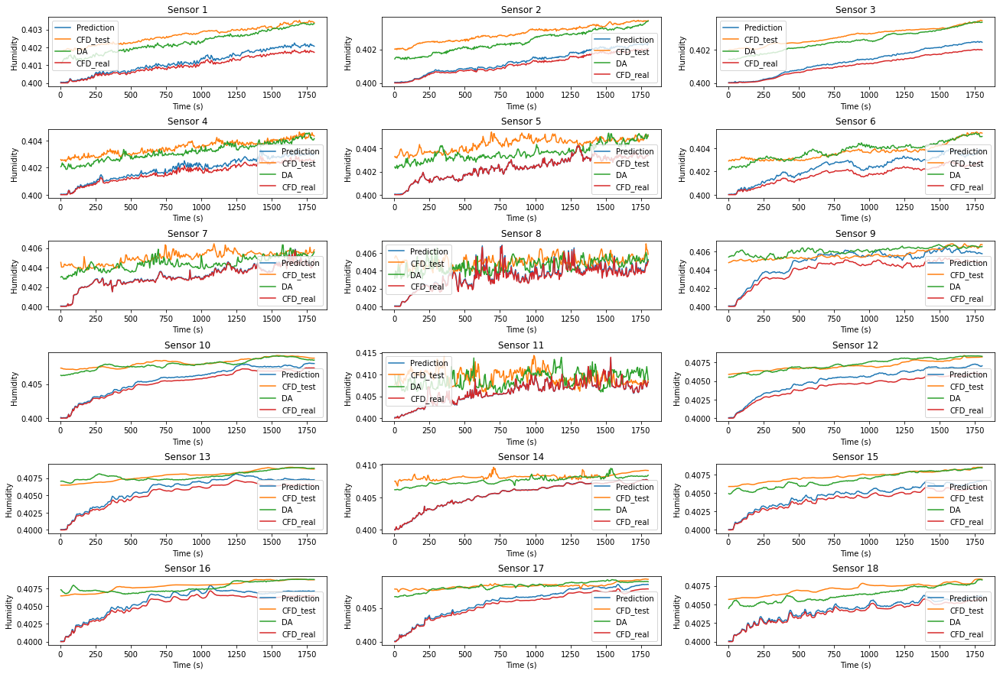

In [ ]:
plot_output_sensor_DA(pred_sensor_Humidity, ob_Humidity_all, pred_sensor_Humidity_DA, 'Humidity')

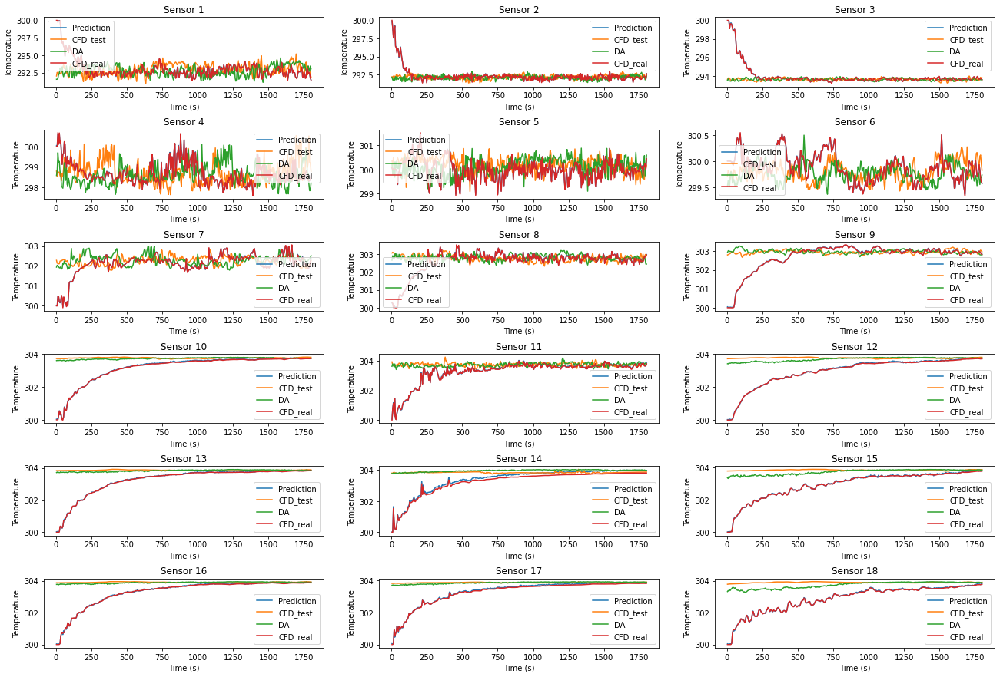

In [ ]:
plot_output_sensor_DA(pred_sensor_Temperature, ob_Temperature_all, pred_sensor_Temperature_DA, 'Temperature')

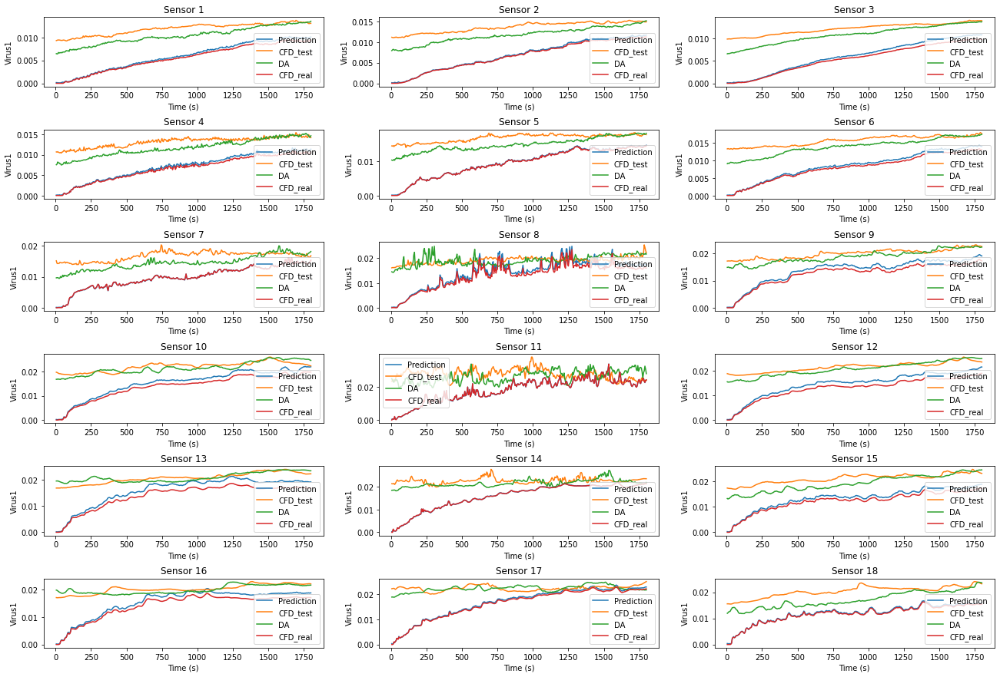

In [ ]:
plot_output_sensor_DA(pred_sensor_Virus1, ob_Virus1_all, pred_sensor_Virus1_DA, 'Virus1')

## Process nodes results

In [ ]:
# Undo (0,1) scaling
X_DA_inverse_01 = scaler_01.inverse_transform(pod_pred_DA)
# Undo PCA to obtain a scaled snapshot matrix
X_DA_inverse_PCA = pca_compress.inverse_transform(X_DA_inverse_01)
# Split to CO2 and three dimensions of velocity data
X_DA_predict_split = np.hsplit(X_DA_inverse_PCA, 7)
# Undo (−1,1) scaling
DA_pred_CO2 = scaler_CO2_all.inverse_transform(X_DA_predict_split[0])
DA_pred_Velocity_x = scaler_x_all.inverse_transform(X_DA_predict_split[1])
DA_pred_Velocity_y = scaler_y_all.inverse_transform(X_DA_predict_split[2])
DA_pred_Velocity_z = scaler_z_all.inverse_transform(X_DA_predict_split[3])
DA_pred_Humidity = scaler_Humidity_all.inverse_transform(X_DA_predict_split[4])
DA_pred_Temperature = scaler_Temperature_all.inverse_transform(X_DA_predict_split[5])
DA_pred_Virus1 = scaler_Virus1_all.inverse_transform(X_DA_predict_split[6])

## Plot the results of nodes after apply DA

In [ ]:
def plot_output_DA(predict_data, CFD_data, DA_data, filename):
  fig, ax = plt.subplots(3, 3, figsize=[16,10])
  fig.tight_layout(h_pad=3.5, w_pad=3.5)
  for i in range(9):
    ax.flatten()[i].plot(x_axis_middle*5, predict_data[n:n+real_timestamp+prediction_num-t,i*200], '-')
    ax.flatten()[i].plot(x_axis_middle*5, CFD_data[n+t:n+(real_timestamp+prediction_num),i*200], '-')
    ax.flatten()[i].plot(x_axis_middle*5, DA_data[:,i*200], '-')
    ax.flatten()[i].plot(x_axis_middle*5, CFD_data[n:n+(real_timestamp+prediction_num-t),i*200], '-')
    ax.flatten()[i].legend(['Prediction', 'CFD_test', 'DA', 'CFD_real'])
    ax.flatten()[i].set_title('Node '+ str(i*200+1))
    ax.flatten()[i].set_xlabel('Time (s)')
    ax.flatten()[i].set_ylabel(filename)
  path = '/content/drive/MyDrive/output_files/Figures/Figures_with_DA_Applied/nodes/All_set/obs_data/case_1/'+str(filename)+'_DA.png'
  plt.savefig(path)

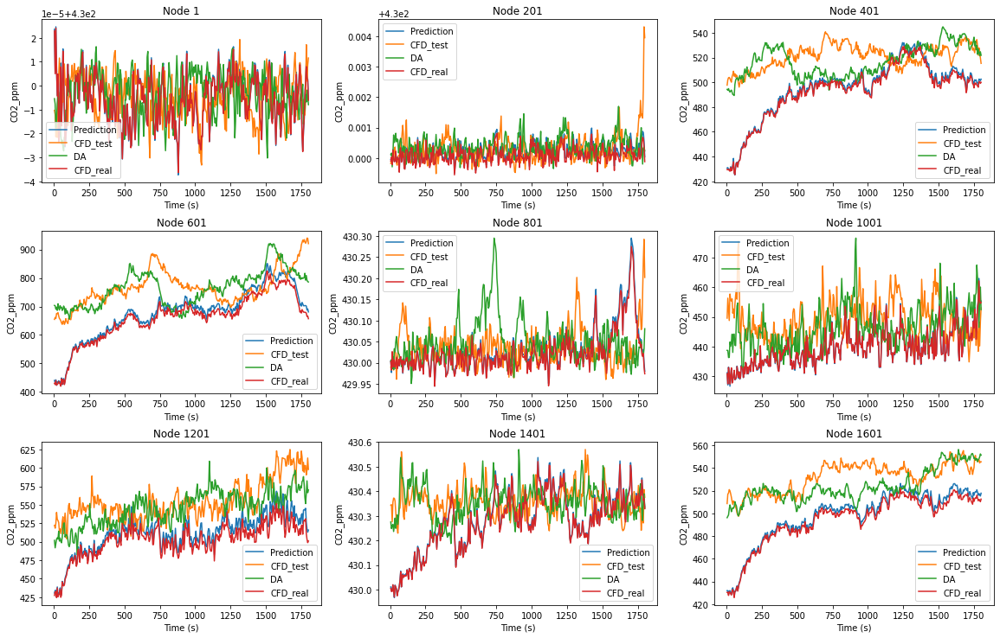

In [ ]:
plot_output_DA(pred_CO2, CFD_CO2, DA_pred_CO2, 'CO2_ppm')

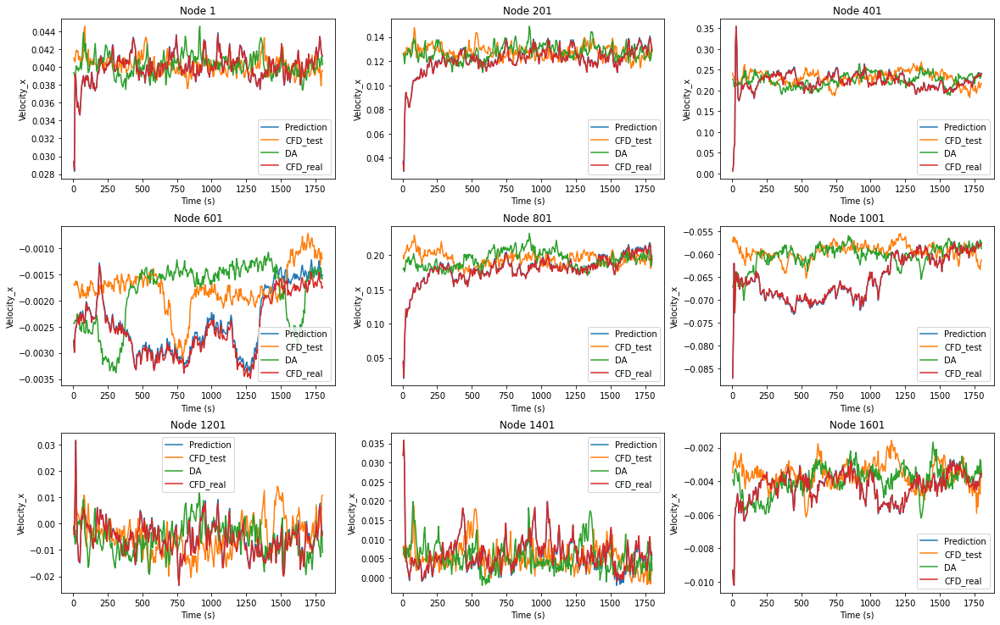

In [ ]:
plot_output_DA(pred_Velocity_x, CFD_Velocity_x, DA_pred_Velocity_x, 'Velocity_x')

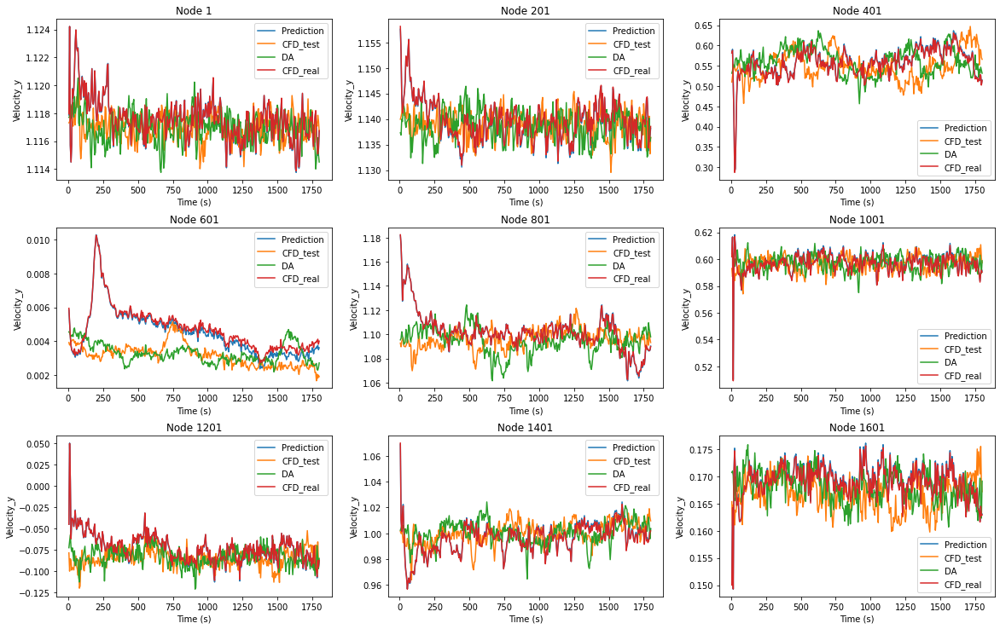

In [ ]:
plot_output_DA(pred_Velocity_y, CFD_Velocity_y, DA_pred_Velocity_y, 'Velocity_y')

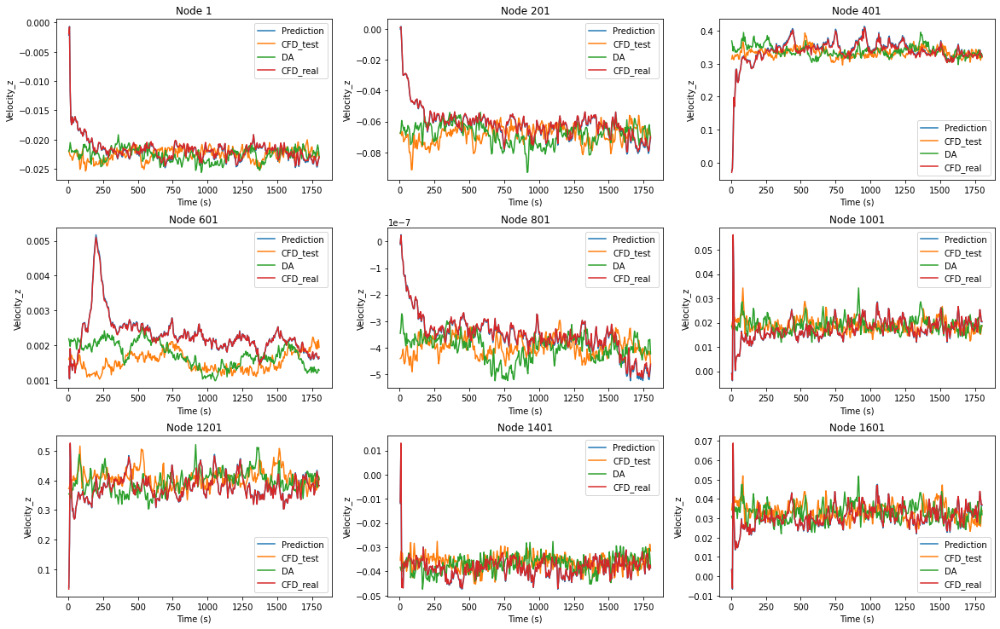

In [ ]:
plot_output_DA(pred_Velocity_z, CFD_Velocity_z, DA_pred_Velocity_z, 'Velocity_z')

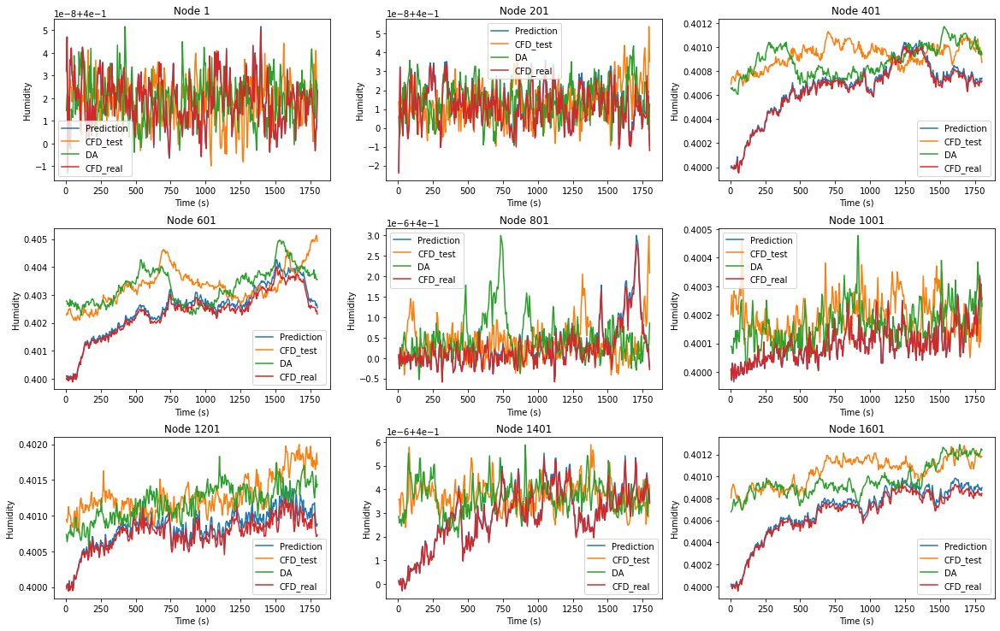

In [ ]:
plot_output_DA(pred_Humidity, CFD_Humidity, DA_pred_Humidity, 'Humidity')

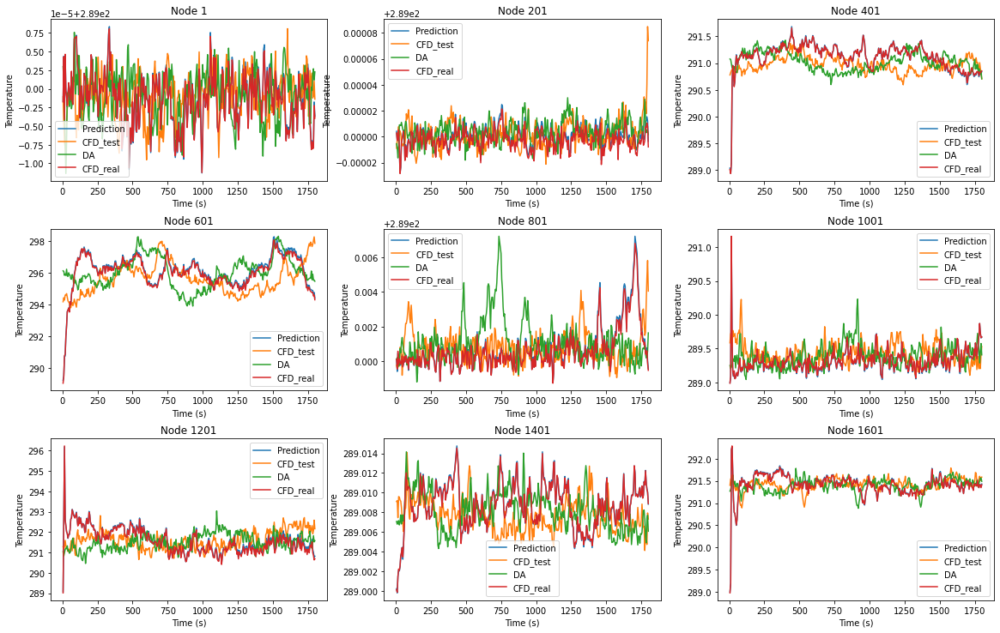

In [ ]:
plot_output_DA(pred_Temperature, CFD_Temperature, DA_pred_Temperature, 'Temperature')

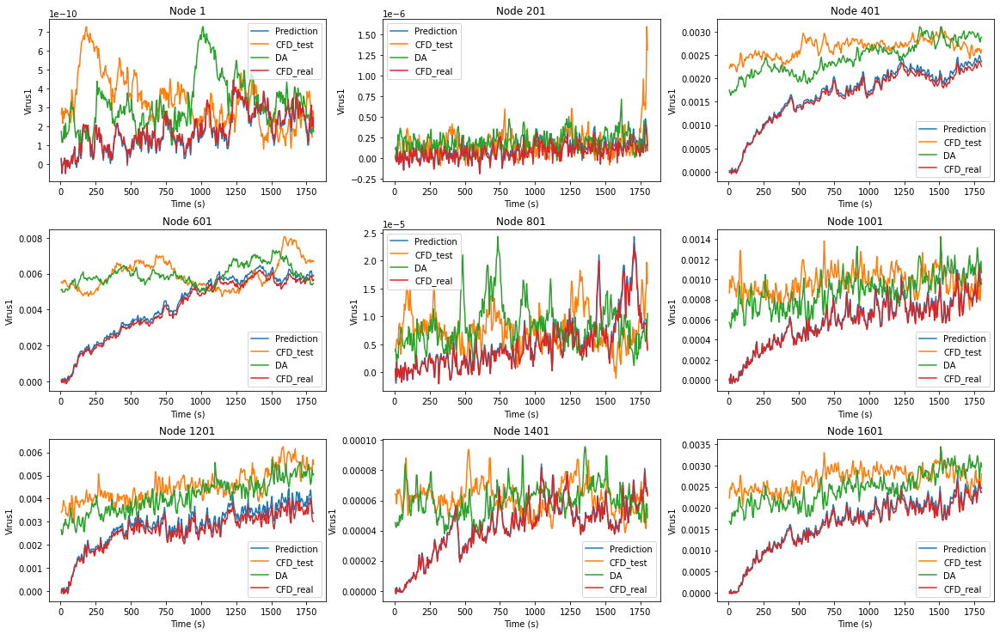

In [ ]:
plot_output_DA(pred_Virus1, CFD_Virus1, DA_pred_Virus1, 'Virus1')

In [ ]:
!pip -q install vtk

     |████████████████████████████████| 88.3 MB 1.2 MB/s 


In [ ]:
import os
os.chdir("/content/drive/MyDrive")
import vtktools
from tools_io import get_nNodes_from_vtu, get_clean_vtu_file

def write_example_to_vtu_DA(i, exm_num, filepath):
  # get clean vtu file
  snapshot_data_location = '/content/drive/MyDrive/Cotrace_fixed_final/'
  snapshot_file_base = 'Cotrace_fixed_'
  filename = snapshot_data_location + snapshot_file_base + '582.vtu'
  clean_vtu = get_clean_vtu_file(filename)

  # write results to vtu
  nNodes = get_nNodes_from_vtu(snapshot_data_location, snapshot_file_base)
  CO2_ppm = np.zeros((nNodes,1))
  velocity = np.zeros((nNodes,3))
  humidity = np.zeros((nNodes,1))
  temperature = np.zeros((nNodes,1))
  virus1 = np.zeros((nNodes,1))

  new_vtu = vtktools.vtu()
  new_vtu.ugrid.DeepCopy(clean_vtu.ugrid)
  new_vtu.filename = filepath + str(exm_num) + '.vtu'

  CO2_ppm[:] = DA_pred_CO2[i].reshape((192060, 1),order='F')
  virus1 = DA_pred_Virus1[i].reshape((192060, 1),order='F')

  new_vtu.AddField('Tracer', CO2_ppm)
  new_vtu.AddField('Virus1', virus1)
  new_vtu.Write()

In [ ]:
import tqdm
start = 361
end = 720
i = 0
for filenum in tqdm.tqdm(range(start,end+1,1)):
  path = '/content/drive/MyDrive/output_files/vtu_files/case_1/output_'
  write_example_to_vtu_DA(i, filenum, path)
  i += 1

100%|██████████| 360/360 [23:24<00:00,  3.90s/it]


# Test case 2: start DA with CFD data from test set

In [ ]:
t_start = 576

In [ ]:
import random
times = random.sample(range(0, 720-t_start), 700-t_start+1)
times.sort()
# print(len(times))

X_obs = []
# Get the observation data
for time in times:
  X_obs.append(ob_all_values[t_start+time])
# Add the corresponding time level to the observation data for DA
X_obs = np.array(X_obs)
times = np.array(times).reshape(len(times),1)
X_obs = np.hstack((times,X_obs))

## Data assimilation

In [ ]:
# start data assimilation at timestamp t.
t = t_start
weight = 70  # set 70 if over relaxation is used, here we use over relaxation

In [ ]:
x_axis_DA

First backward march

In [ ]:
# Extract the value of the last m-1 continuous time level in the prediction
real_value = X_predict[-(input_timestamps - 1):,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
# Set value of time level n-m as same as that of time level n-m+1
initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)

# Set the range of the time level for prediction
march_range = np.arange(time_steps-(input_timestamps-1), time_steps)
# Extract observation data
obs_data = process_obs_data(march_range, X_obs)
# Predict a point backward in time with observation data
prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)

# Update input and initial guess
X_predict_backward = list(prediction_values.numpy().reshape(-1,total_coeffs))
# prediction of the mth time level from the bottom
gen_predict = prediction_values[:,:1,:,:]
# Add the predicted value to the input
real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
# Set for the next iteration
initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)

# Predict backward in time with obs_data
for i in tqdm.tqdm(range(1, forward_steps-t)):
    # Set the range of the time level that prediction will cover
    march_range = np.arange(time_steps - (input_timestamps - 1) - i, time_steps - i)
    # Extract observation data within the prediction range
    obs_data = process_obs_data(march_range, X_obs)

    prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)

    # Update input and initial guess
    gen_predict = prediction_values[:,:1,:,:].numpy()
    X_predict_backward.insert(0,gen_predict.flatten())
    real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
    initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)
X_predict_backward = np.array(X_predict_backward, dtype = np.float32)

100%|██████████| 135/135 [00:16<00:00,  8.08it/s]


Iterations for forward and backward march

In [ ]:
DA = []
for j in range(20):
    print(f'\nIteration {j}: forward and backward')

    print('-- Forward March --') 
    forward_loss_i = []

    # Set time level n-m to n-1 as the input 
    real_coding = X_predict_backward[:input_timestamps - 1,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
    # Set value of time level n as same as that of time level n-1
    initial_pred = np.concatenate((real_coding, real_coding[:,-1:,:,:]), axis=1)
    # Set the range of the time level for prediction
    march_range = np.arange(0, input_timestamps)
    # Extract observation data
    obs_data = process_obs_data(march_range, X_obs)
    # Predict data for one time level forward in time (time level m-1)
    prediction_values,loss = predict_coding_forward(initial_pred, real_coding, obs_data)
    forward_loss_i.append(loss)

    # Update real value and initial guess
    X_predict_forward = list(prediction_values.numpy().reshape(-1,total_coeffs))
    gen_predict = prediction_values[:,(input_timestamps - 1):,:,:]
    # print(prediction_values)
    real_coding = np.concatenate((real_coding[:,1:,:,:], gen_predict), axis=1)
    initial_pred = np.concatenate((real_coding, real_coding[:,-1:,:,:]), axis=1)

    # Predict backward with observation data
    for i in tqdm.tqdm(range(1, forward_steps-t)):
        # Set the range of the time level for prediction
        march_range = np.arange(i, (input_timestamps - 1) + i)
        # get observation data
        obs_data = process_obs_data(march_range, X_obs)

        prediction_values,loss = predict_coding_forward(initial_pred, real_coding, obs_data)
        forward_loss_i.append(loss)

        # Update real value and initial guess
        gen_predict = prediction_values[:,(input_timestamps - 1):,:,:].numpy()
        X_predict_forward.append(gen_predict.flatten())
        real_coding = np.concatenate((real_coding[:,1:,:,:], gen_predict), axis=1)
        initial_pred = np.concatenate((real_coding, real_coding[:,-1:,:,:]), axis=1)
    X_predict_forward = np.array(X_predict_forward)
    DA.append(np.array(forward_loss_i).mean())

    print('-- Backward March --')
    backward_loss_i = []

    # Extract the value of the last m-1 continuous time level in the prediction
    real_value = X_predict_forward[-(input_timestamps - 1):,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
    # Set value of time level n-m as same as that of time level n-m+1
    initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)
    
    # Set the range of the time level for prediction
    march_range = np.arange(time_steps-(input_timestamps-1), time_steps)
    # Extract observation data
    obs_data = process_obs_data(march_range, X_obs)
    # Predict a point backward in time with observation data
    prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)
    backward_loss_i.append(loss)

    X_predict_backward2 = list(prediction_values.numpy().reshape(-1, total_coeffs))
    # Update input and initial guess
    gen_predict = prediction_values[:,:1,:,:]
    # Add the predicted value to the input
    real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
    # Set for the next iteration
    initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)

    # Predict backward with observation data
    for i in tqdm.tqdm(range(1, forward_steps-t)):
        # Set the range of the time level for prediction
        march_range = np.arange(time_steps - (input_timestamps - 1) - i, time_steps - i)
        # get observation data
        obs_data = process_obs_data(march_range, X_obs)

        prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)
        backward_loss_i.append(loss)

        # Update input and initial guess
        gen_predict = prediction_values[:,:1,:,:].numpy()
        X_predict_backward2.insert(0,gen_predict.flatten())
        real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
        initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)
    X_predict_backward2 = np.array(X_predict_backward2)
    DA.append(np.array(backward_loss_i).mean())
    print(DA[-1], DA[-2])
    # Do relaxation (DA with dynamic relaxation), comment this if over relaxation is selected.
    # if j>0:
    #   if DA[-2]-DA[-1]<1e-5 and DA[-2]<1e-4:
    #     break
    #   if DA[-2]-DA[-1]>0:
    #     weight = weight * 0.5
    #   else:
    #     weight = 1.5 * weight
    #   if weight > 1:
    #     weight = 1


Iteration 0: forward and backward
-- Forward March --


100%|██████████| 135/135 [00:16<00:00,  8.19it/s]


-- Backward March --


100%|██████████| 135/135 [00:16<00:00,  8.30it/s]


4.7450692e-05 0.00051308615

Iteration 1: forward and backward
-- Forward March --


100%|██████████| 135/135 [00:16<00:00,  8.11it/s]


-- Backward March --


100%|██████████| 135/135 [00:15<00:00,  8.48it/s]


4.7450692e-05 0.0005130861

Iteration 2: forward and backward
-- Forward March --


100%|██████████| 135/135 [00:16<00:00,  8.09it/s]


-- Backward March --


100%|██████████| 135/135 [00:15<00:00,  8.62it/s]


4.735221e-05 0.00051058497

Iteration 3: forward and backward
-- Forward March --


100%|██████████| 135/135 [00:16<00:00,  8.09it/s]


-- Backward March --


100%|██████████| 135/135 [00:15<00:00,  8.50it/s]


4.4051652e-05 0.00043408267

Iteration 4: forward and backward
-- Forward March --


100%|██████████| 135/135 [00:16<00:00,  8.05it/s]


-- Backward March --


100%|██████████| 135/135 [00:16<00:00,  8.14it/s]


3.6668713e-05 0.0002490899

Iteration 5: forward and backward
-- Forward March --


100%|██████████| 135/135 [00:16<00:00,  8.21it/s]


-- Backward March --


100%|██████████| 135/135 [00:16<00:00,  8.29it/s]


3.1922467e-05 0.000112853704

Iteration 6: forward and backward
-- Forward March --


100%|██████████| 135/135 [00:16<00:00,  8.07it/s]


-- Backward March --


100%|██████████| 135/135 [00:16<00:00,  8.10it/s]


3.0234833e-05 5.6142675e-05

Iteration 7: forward and backward
-- Forward March --


100%|██████████| 135/135 [00:16<00:00,  8.21it/s]


-- Backward March --


100%|██████████| 135/135 [00:16<00:00,  8.24it/s]

2.9756797e-05 3.77677e-05


Last forward march

In [ ]:
last_forward_loss = []

# Set time level n-m to n-1 as the input
real_value = X_predict_backward2[:input_timestamps - 1,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
# Set value of time level n-m as same as that of time level n-m+1
initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)

# Predict data for one time level forward in time (time level m-1)
prediction_values,loss = predict_coding_forward_basic(initial_pred, real_value)
last_forward_loss.append(loss)

# Update input and initial guess
X_predict_last = list(prediction_values.numpy().reshape(-1,total_coeffs))
# prediction of time level n
gen_predict = prediction_values[:,(input_timestamps - 1):,:,:]
# Add the predicted value to the real value
real_value = np.concatenate((real_value[:,1:,:,:], gen_predict), axis=1)
# Set value of time level n as same as that of time level n-1
initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)

# Predict forward in time without observation data
for i in tqdm.tqdm(range(1, forward_steps-t)):
    prediction_values, loss = predict_coding_forward_basic(initial_pred, real_value)
    last_forward_loss.append(loss)

    # Update input values and initial guess
    gen_predict = prediction_values[:,(input_timestamps - 1):,:,:].numpy()
    X_predict_last.append(gen_predict.flatten())
    real_value = np.concatenate((real_value[:,1:,:,:], gen_predict), axis=1)
    initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)
X_predict_last = np.array(X_predict_last)

print(X_predict_last)

100%|██████████| 135/135 [00:15<00:00,  8.46it/s]

[[0.16141964 0.18610859 0.163773   ... 0.8599255  0.82948047 0.7584613 ]
 [0.15925595 0.1969008  0.1608056  ... 0.87263846 0.8334938  0.76206726]
 [0.16503446 0.20000784 0.1690125  ... 0.8731213  0.8301194  0.7580412 ]
 ...
 [0.00821901 0.32973656 0.313109   ... 0.9453532  0.87552977 0.95734113]
 [0.00794697 0.3312104  0.36045164 ... 0.94865733 0.8751248  0.9547449 ]
 [0.00751818 0.32272455 0.35873908 ... 0.9497373  0.87466794 0.95152473]]


## Split the results into nodes and sensors parts

In [ ]:
pod_pred_DA = X_predict_last[:,:coeffs_num]
sensors_pred_DA = X_predict_last[:,coeffs_num:]

## Process sensor results

In [ ]:
pred_sensor_split_DA = np.hsplit(sensors_pred_DA, 7)

In [ ]:
# Undo (0,1) scaling
pred_sensor_CO2_DA = scaler_ob_CO2_all.inverse_transform(pred_sensor_split_DA[0])
pred_sensor_xdata_DA = scaler_ob_xdata_all.inverse_transform(pred_sensor_split_DA[1])
pred_sensor_ydata_DA = scaler_ob_ydata_all.inverse_transform(pred_sensor_split_DA[2])
pred_sensor_zdata_DA = scaler_ob_zdata_all.inverse_transform(pred_sensor_split_DA[3])
pred_sensor_Humidity_DA = scaler_ob_Humidity_all.inverse_transform(pred_sensor_split_DA[4])
pred_sensor_Temperature_DA = scaler_ob_Temperature_all.inverse_transform(pred_sensor_split_DA[5])
pred_sensor_Virus1_DA = scaler_ob_Virus1_all.inverse_transform(pred_sensor_split_DA[6])

## Plot the results of sensors after apply DA

In [ ]:
x_axis_middle = np.linspace(1, 720-t, 720-t)
x_axis_middle

array([  1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,  11.,
        12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,  22.,
        23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,  33.,
        34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,  44.,
        45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,  55.,
        56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,  66.,
        67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,  77.,
        78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,  88.,
        89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,  99.,
       100., 101., 102., 103., 104., 105., 106., 107., 108., 109., 110.,
       111., 112., 113., 114., 115., 116., 117., 118., 119., 120., 121.,
       122., 123., 124., 125., 126., 127., 128., 129., 130., 131., 132.,
       133., 134., 135., 136., 137., 138., 139., 140., 141., 142., 143.,
       144.])

In [ ]:
def plot_output_sensor_DA(predict_data, CFD_data, DA_data, filename):
  fig, ax = plt.subplots(6, 3, figsize=[18,12])
  fig.tight_layout(h_pad=3.5, w_pad=3.5)
  for i in range(18):
    ax.flatten()[i].plot(x_axis_middle*5, predict_data[n:real_timestamp+prediction_num-t,i], '-')
    ax.flatten()[i].plot(x_axis_middle*5, CFD_data[n+t:real_timestamp+prediction_num,i], '-')
    ax.flatten()[i].plot(x_axis_middle*5, DA_data[:,i], '-')
    ax.flatten()[i].plot(x_axis_middle*5, CFD_data[n:real_timestamp+prediction_num-t,i], '-')
    ax.flatten()[i].legend(['Prediction', 'CFD_test', 'DA', 'CFD_real'])
    ax.flatten()[i].set_title('Sensor '+ str(i+1))
    ax.flatten()[i].set_xlabel('Time (s)')
    ax.flatten()[i].set_ylabel(filename)
  path = '/content/drive/MyDrive/output_files/Figures/Figures_with_DA_Applied/sensors/All_set/obs_data/case_2/'+str(filename)+'_DA.png'
  plt.savefig(path)

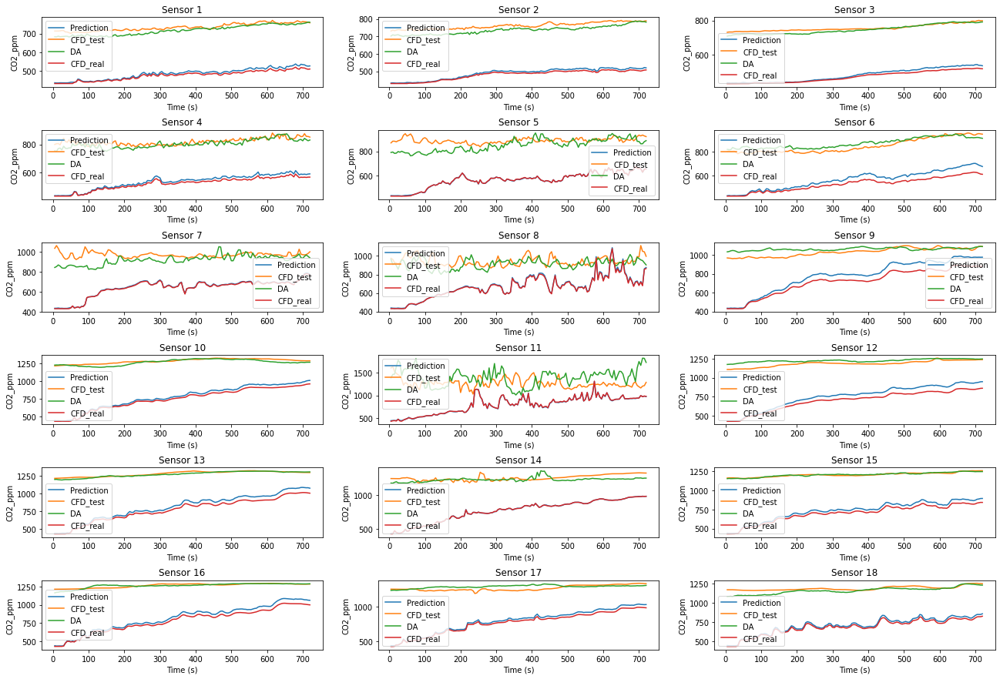

In [ ]:
plot_output_sensor_DA(pred_sensor_CO2, ob_CO2_all, pred_sensor_CO2_DA, 'CO2_ppm')

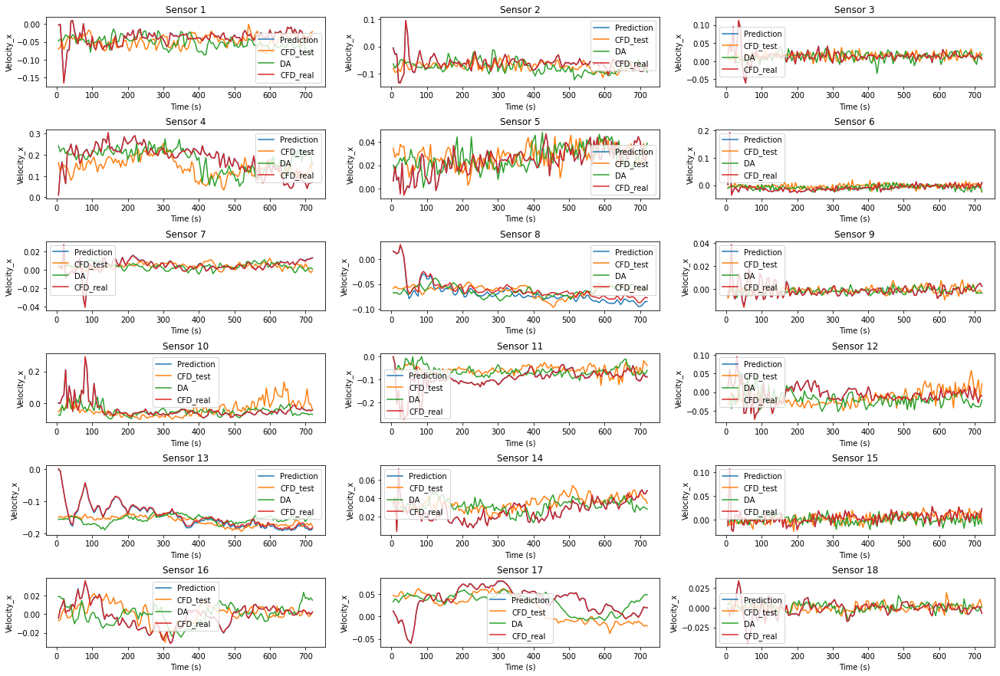

In [ ]:
plot_output_sensor_DA(pred_sensor_xdata, ob_xdata_all, pred_sensor_xdata_DA, 'Velocity_x')

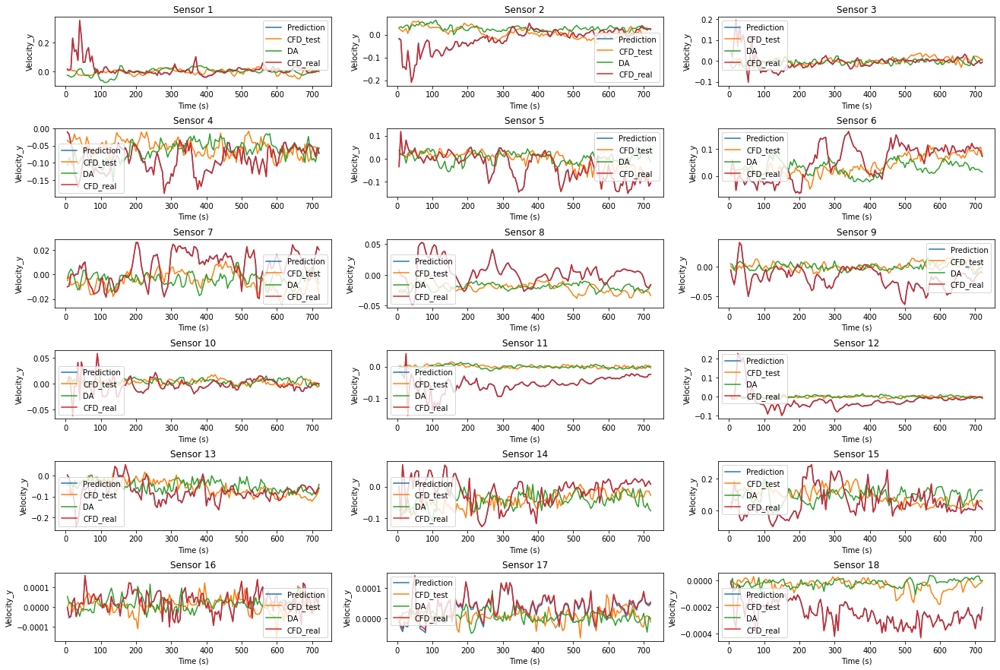

In [ ]:
plot_output_sensor_DA(pred_sensor_ydata, ob_ydata_all, pred_sensor_ydata_DA, 'Velocity_y')

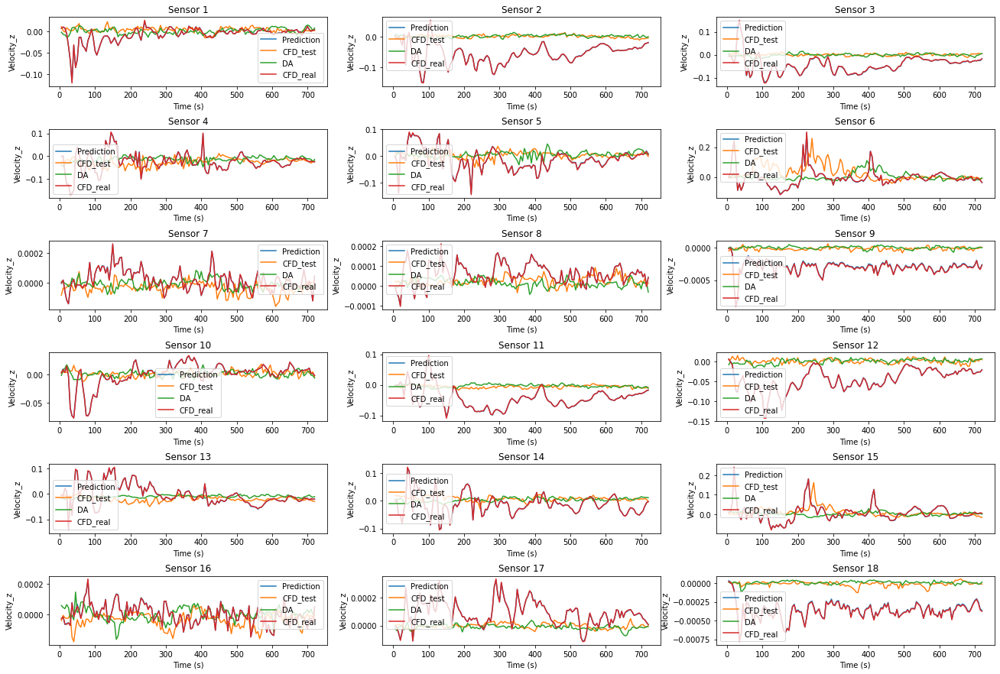

In [ ]:
plot_output_sensor_DA(pred_sensor_zdata, ob_zdata_all, pred_sensor_zdata_DA, 'Velocity_z')

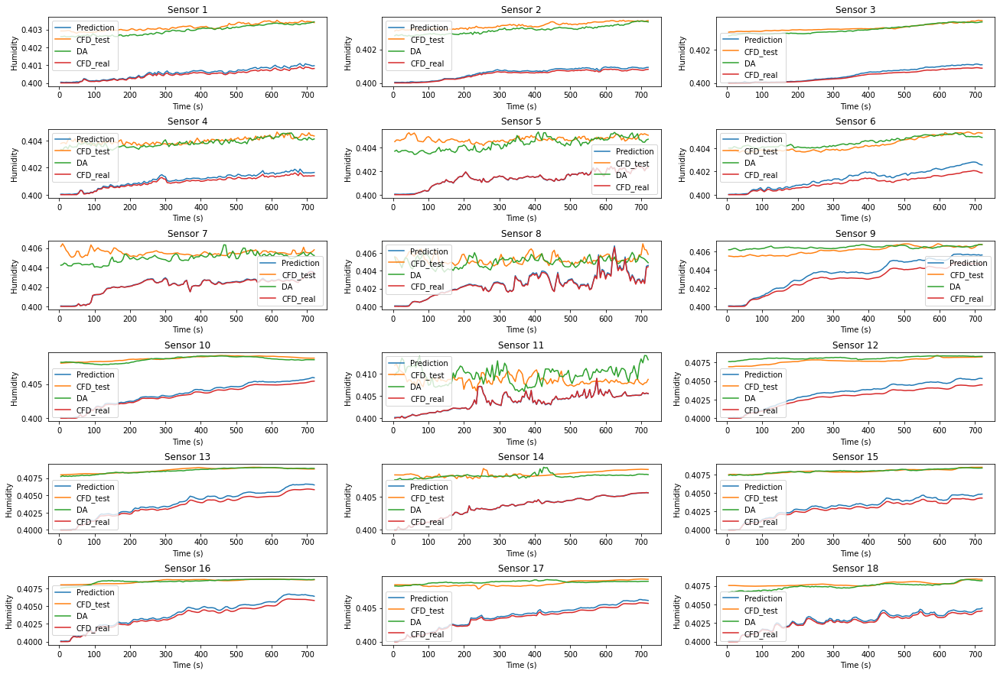

In [ ]:
plot_output_sensor_DA(pred_sensor_Humidity, ob_Humidity_all, pred_sensor_Humidity_DA, 'Humidity')

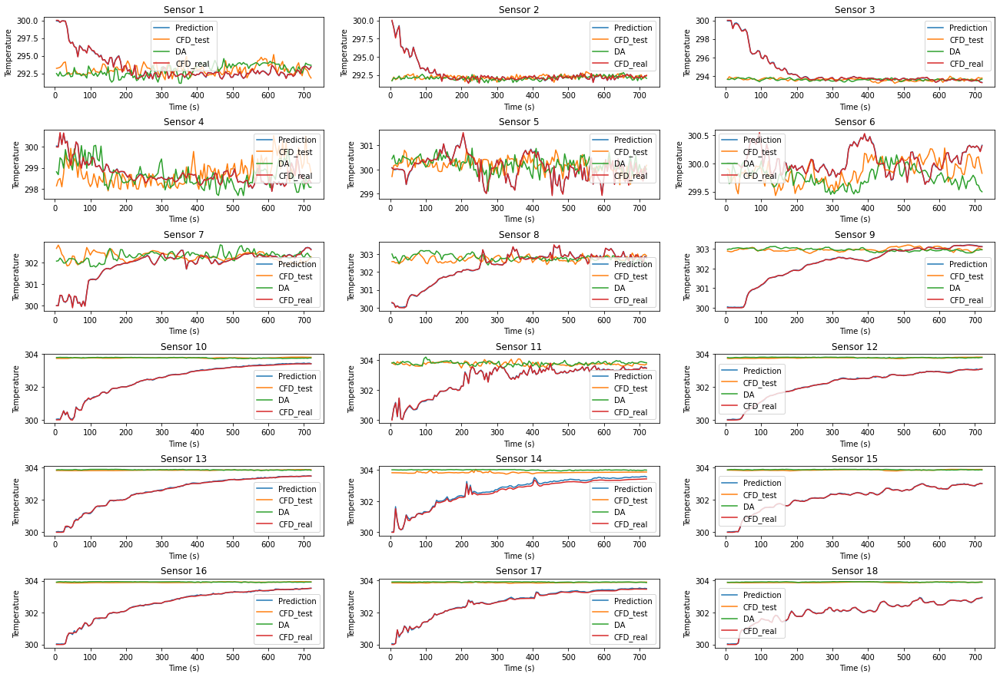

In [ ]:
plot_output_sensor_DA(pred_sensor_Temperature, ob_Temperature_all, pred_sensor_Temperature_DA, 'Temperature')

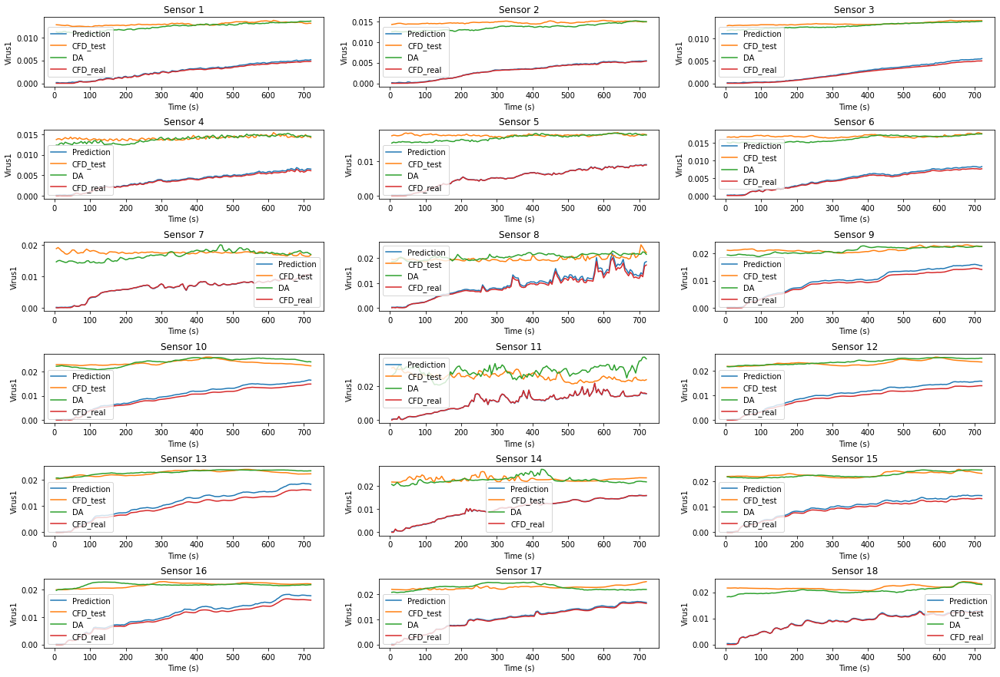

In [ ]:
plot_output_sensor_DA(pred_sensor_Virus1, ob_Virus1_all, pred_sensor_Virus1_DA, 'Virus1')

## Process nodes results

In [ ]:
# Undo (0,1) scaling
X_DA_inverse_01 = scaler_01.inverse_transform(pod_pred_DA)
# Undo PCA to obtain a scaled snapshot matrix
X_DA_inverse_PCA = pca_compress.inverse_transform(X_DA_inverse_01)
# Split to CO2 and three dimensions of velocity data
X_DA_predict_split = np.hsplit(X_DA_inverse_PCA, 7)
# Undo (−1,1) scaling
DA_pred_CO2 = scaler_CO2_all.inverse_transform(X_DA_predict_split[0])
DA_pred_Velocity_x = scaler_x_all.inverse_transform(X_DA_predict_split[1])
DA_pred_Velocity_y = scaler_y_all.inverse_transform(X_DA_predict_split[2])
DA_pred_Velocity_z = scaler_z_all.inverse_transform(X_DA_predict_split[3])
DA_pred_Humidity = scaler_Humidity_all.inverse_transform(X_DA_predict_split[4])
DA_pred_Temperature = scaler_Temperature_all.inverse_transform(X_DA_predict_split[5])
DA_pred_Virus1 = scaler_Virus1_all.inverse_transform(X_DA_predict_split[6])

## Plot the results of nodes after apply DA

In [ ]:
def plot_output_DA(predict_data, CFD_data, DA_data, filename):
  fig, ax = plt.subplots(3, 3, figsize=[16,10])
  fig.tight_layout(h_pad=3.5, w_pad=3.5)
  for i in range(9):
    ax.flatten()[i].plot(x_axis_middle*5, predict_data[n:n+real_timestamp+prediction_num-t,i*200], '-')
    ax.flatten()[i].plot(x_axis_middle*5, CFD_data[n+t:n+(real_timestamp+prediction_num),i*200], '-')
    ax.flatten()[i].plot(x_axis_middle*5, DA_data[:,i*200], '-')
    ax.flatten()[i].plot(x_axis_middle*5, CFD_data[n:n+(real_timestamp+prediction_num-t),i*200], '-')
    ax.flatten()[i].legend(['Prediction', 'CFD_test', 'DA', 'CFD_real'])
    ax.flatten()[i].set_title('Node '+ str(i*200+1))
    ax.flatten()[i].set_xlabel('Time (s)')
    ax.flatten()[i].set_ylabel(filename)
  path = '/content/drive/MyDrive/output_files/Figures/Figures_with_DA_Applied/nodes/All_set/obs_data/case_2/'+str(filename)+'_DA.png'
  plt.savefig(path)

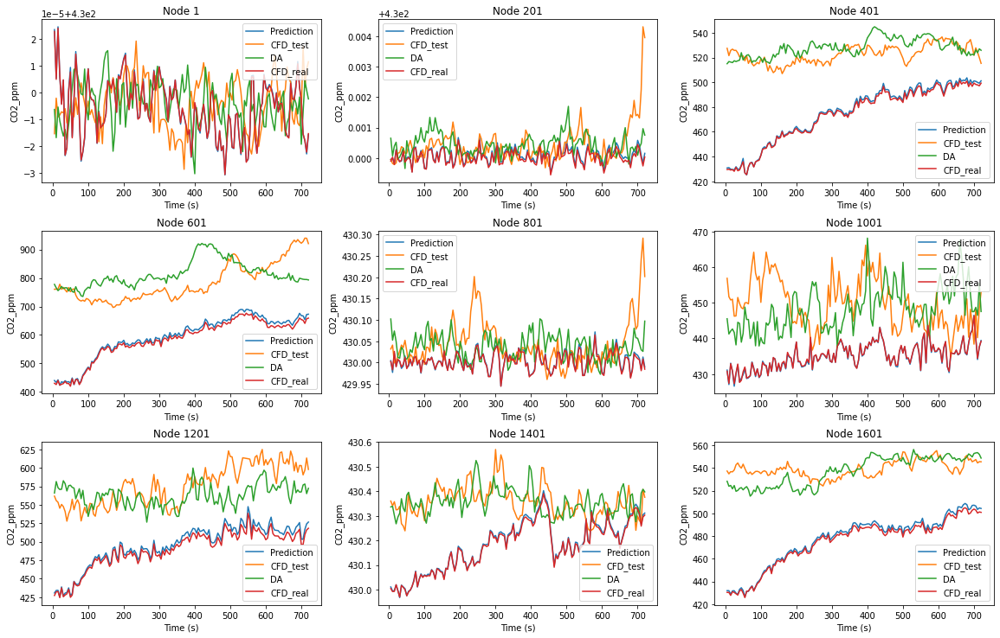

In [ ]:
plot_output_DA(pred_CO2, CFD_CO2, DA_pred_CO2, 'CO2_ppm')

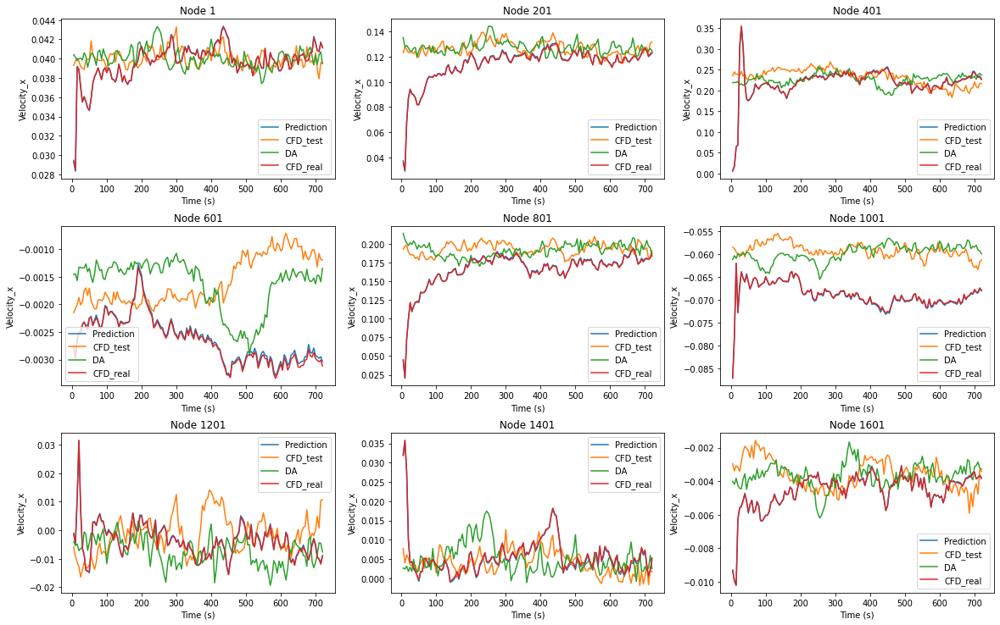

In [ ]:
plot_output_DA(pred_Velocity_x, CFD_Velocity_x, DA_pred_Velocity_x, 'Velocity_x')

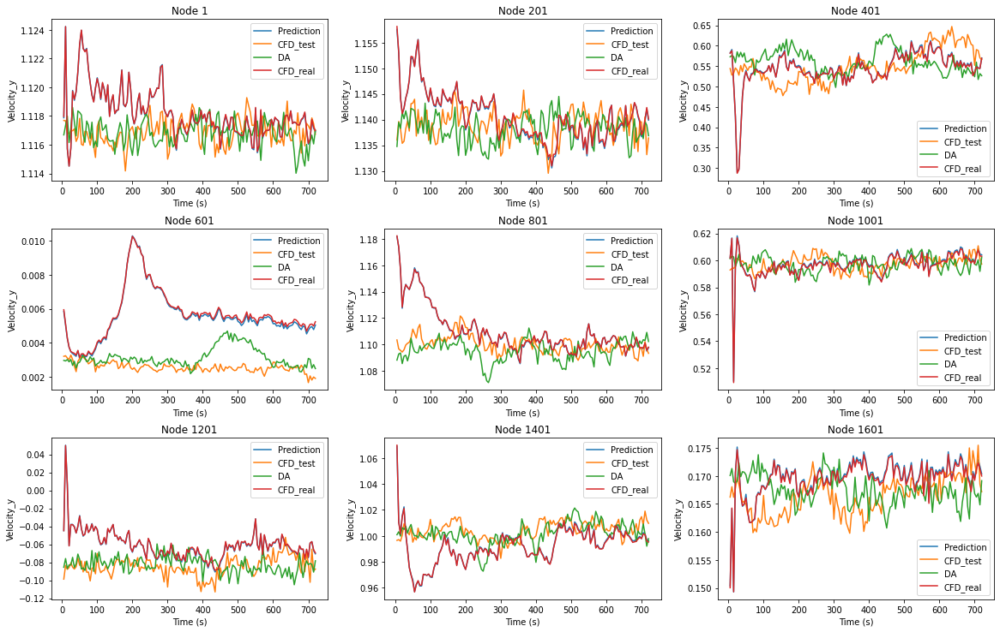

In [ ]:
plot_output_DA(pred_Velocity_y, CFD_Velocity_y, DA_pred_Velocity_y, 'Velocity_y')

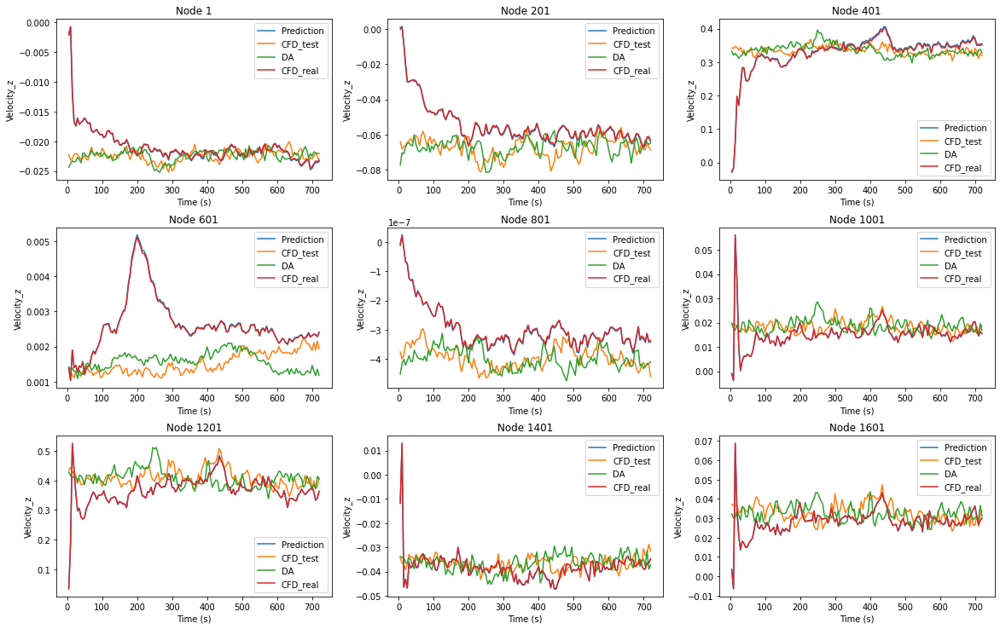

In [ ]:
plot_output_DA(pred_Velocity_z, CFD_Velocity_z, DA_pred_Velocity_z, 'Velocity_z')

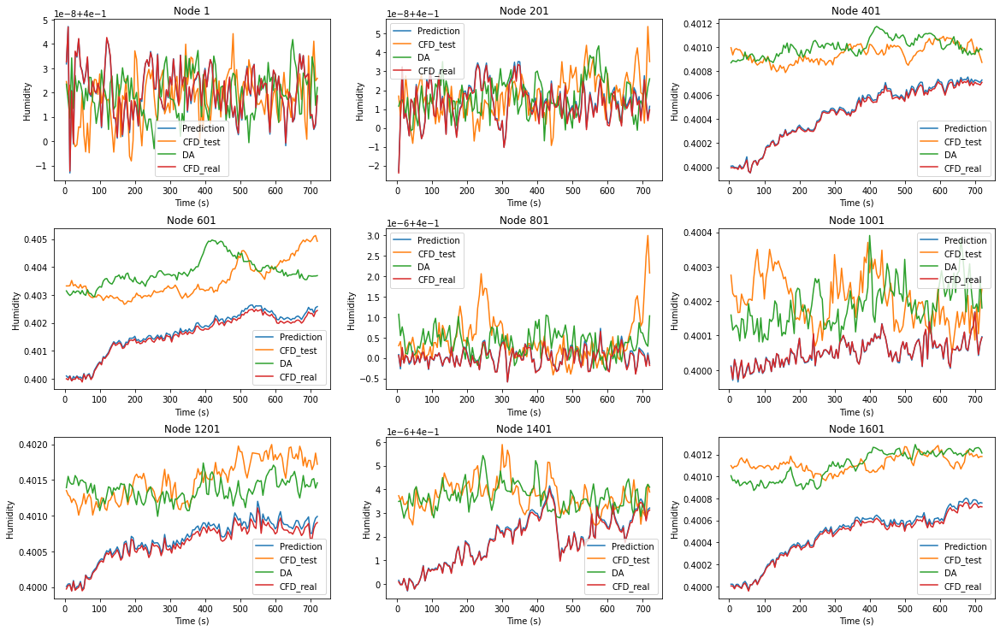

In [ ]:
plot_output_DA(pred_Humidity, CFD_Humidity, DA_pred_Humidity, 'Humidity')

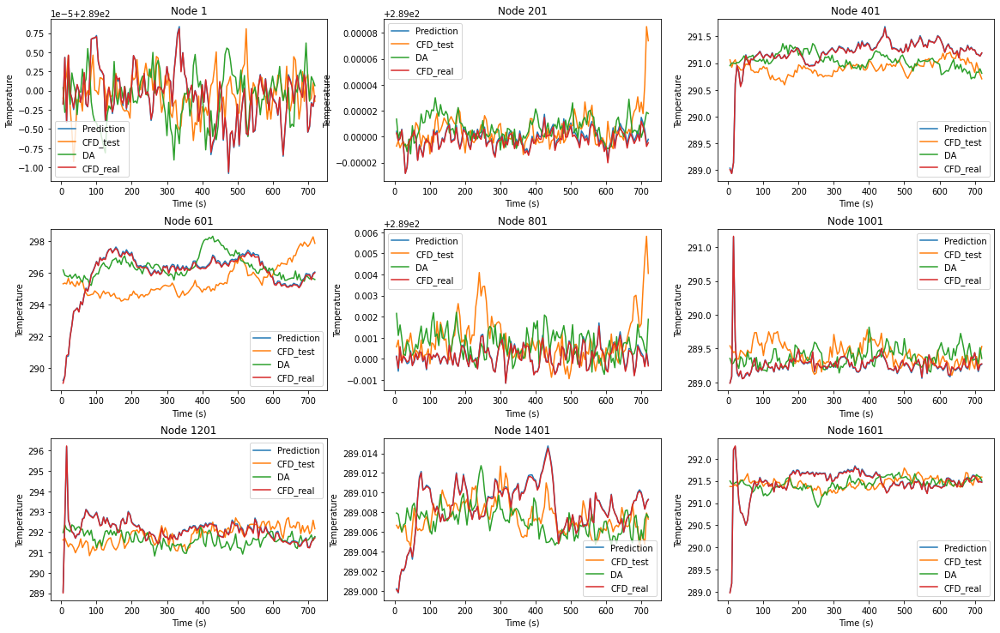

In [ ]:
plot_output_DA(pred_Temperature, CFD_Temperature, DA_pred_Temperature, 'Temperature')

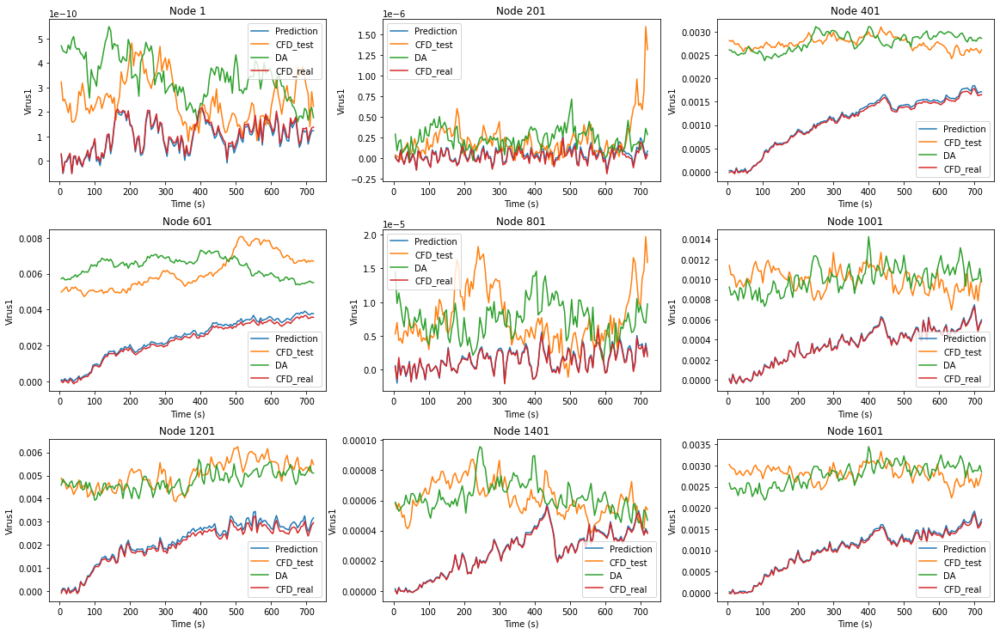

In [ ]:
plot_output_DA(pred_Virus1, CFD_Virus1, DA_pred_Virus1, 'Virus1')

In [ ]:
!pip -q install vtk

     |████████████████████████████████| 88.3 MB 91.3 MB/s 


In [ ]:
import os
os.chdir("/content/drive/MyDrive")
import vtktools
from tools_io import get_nNodes_from_vtu, get_clean_vtu_file

def write_example_to_vtu_DA(i, exm_num, filepath):
  # get clean vtu file
  snapshot_data_location = '/content/drive/MyDrive/Cotrace_fixed_final/'
  snapshot_file_base = 'Cotrace_fixed_'
  filename = snapshot_data_location + snapshot_file_base + '582.vtu'
  clean_vtu = get_clean_vtu_file(filename)

  # write results to vtu
  nNodes = get_nNodes_from_vtu(snapshot_data_location, snapshot_file_base)
  CO2_ppm = np.zeros((nNodes,1))
  velocity = np.zeros((nNodes,3))
  humidity = np.zeros((nNodes,1))
  temperature = np.zeros((nNodes,1))
  virus1 = np.zeros((nNodes,1))

  new_vtu = vtktools.vtu()
  new_vtu.ugrid.DeepCopy(clean_vtu.ugrid)
  new_vtu.filename = filepath + str(exm_num) + '.vtu'

  CO2_ppm[:] = DA_pred_CO2[i].reshape((192060, 1),order='F')
  virus1 = DA_pred_Virus1[i].reshape((192060, 1),order='F')

  new_vtu.AddField('Tracer', CO2_ppm)
  new_vtu.AddField('Virus1', virus1)
  new_vtu.Write()

In [ ]:
import tqdm
start = 577
end = 720
i = 0
for filenum in tqdm.tqdm(range(start,end+1,1)):
  path = '/content/drive/MyDrive/output_files/vtu_files/case_2/output_'
  write_example_to_vtu_DA(i, filenum, path)
  i += 1

100%|██████████| 144/144 [09:08<00:00,  3.81s/it]


# Test Case 3: DA with experimental data

In [ ]:
import joblib
exp_data = joblib.load('/content/drive/MyDrive/output_files/DATA/data_used_for_model/experimental.pkl')

In [ ]:
t = 0
x_axis_DA = np.linspace(t+1, 720, 720-t)
weight = 0.8

In [ ]:
x_axis_DA

array([  1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,  11.,
        12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,  22.,
        23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,  33.,
        34.,  35.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,  44.,
        45.,  46.,  47.,  48.,  49.,  50.,  51.,  52.,  53.,  54.,  55.,
        56.,  57.,  58.,  59.,  60.,  61.,  62.,  63.,  64.,  65.,  66.,
        67.,  68.,  69.,  70.,  71.,  72.,  73.,  74.,  75.,  76.,  77.,
        78.,  79.,  80.,  81.,  82.,  83.,  84.,  85.,  86.,  87.,  88.,
        89.,  90.,  91.,  92.,  93.,  94.,  95.,  96.,  97.,  98.,  99.,
       100., 101., 102., 103., 104., 105., 106., 107., 108., 109., 110.,
       111., 112., 113., 114., 115., 116., 117., 118., 119., 120., 121.,
       122., 123., 124., 125., 126., 127., 128., 129., 130., 131., 132.,
       133., 134., 135., 136., 137., 138., 139., 140., 141., 142., 143.,
       144., 145., 146., 147., 148., 149., 150., 15

In [ ]:
# import random
# times = random.sample(range(0, 720), 650)
# times.sort()
# # print(times.shape)

# X_exp = []
# # Get the observation data
# for time in times:
#   X_exp.append(exp_data[time])

# # Add the corresponding time level to the observation data for DA
# X_exp = np.array(X_exp)
# times = np.array(times).reshape(len(times),1)
# X_exp = np.hstack((times,X_exp))
import random
times = np.linspace(1, 715, 120)
times.sort()
print(times.shape)

X_exp = []
# Get the observation data
for time in times:
  X_exp.append(exp_data[int((time-1)/6)])

# Add the corresponding time level to the observation data for DA
X_exp = np.array(X_exp)
times = np.array(times).reshape(len(times),1)
X_exp = np.hstack((times,X_exp))

(120,)


In [ ]:
mse = tf.keras.losses.MeanSquaredError()
def mse_loss(inp, outp):
    """
    Calculate mean square error 
    between real value and prediction
    
    Parameters
    ----------
    inp : numpy.ndarray 
       real POD coefficients
    ontp : numpy.ndarray
       generated values of the POD coefficients

    Returns
    -------
    float
       mean squared loss between inp and outp
    """   
    inp = tf.reshape(inp, [-1, total_coeffs])
    outp = tf.reshape(outp, [-1, total_coeffs])
    return mse(inp, outp)

def predict_coding_forward_basic(initial_pred, real_coding, epochs=10):
    """
    Generate predictions of m consecutive time levels:
    use {0-(m-2)} to predict m-1
    
    Parameters
    ----------
    initial_pred : numpy.ndarray 
       initial guess of m consecutive time levels
    real_coding : numpy.ndarray
       real value of {0 - (m-2)} consecutive time levels
    epochs: int
       times of update iteration
       
    Returns
    -------
    numpy.ndarray
       predictions for m consecutive time levels
    float
       mean squared loss of the last iteration   
    """   
    loss = []
    # Do the iteration to get the result
    for epoch in range(epochs):
        encoder_output = encoder(initial_pred, training=False)
        decoder_output = decoder(encoder_output, training=False)
        loss.append(mse_loss(real_coding, decoder_output[:,:(input_timestamps - 1),:,:]).numpy())
        # Replace initial guess with the output of decoder at time level n        
        initial_pred[:,(input_timestamps - 1):,:,:] = decoder_output[:,(input_timestamps - 1):,:,:]        
        
    return decoder_output,loss[-1]

def predict_coding_forward(initial_pred, real_coding, obs_data, epochs=10):
    """
    Generate predictions of m consecutive time levels:
    use {0-(m-2)} to predict m-1
    
    Parameters
    ----------
    initial_pred : numpy.ndarray 
       initial guess of m consecutive time levels
    real_coding : numpy.ndarray
       real value of {0 - (m-2)} consecutive time levels
    obs_data : numpy.ndarray
       observation data given by sensors
    epochs: int
       times of update iteration
       
    Returns
    -------
    numpy.ndarray
       predictions for m consecutive time levels
    float
       mean squared loss of the last iteration   
    """     
    loss = []
    # Do the iteration to get the result   
    for epoch in range(epochs):
        encoder_output = encoder(initial_pred, training=False)
        decoder_output = decoder(encoder_output, training=False)
        loss.append(mse_loss(real_coding, decoder_output[:,:(input_timestamps - 1),:,:]).numpy())
        # Replace initial guess with the output of decoder at time level n          
        initial_pred[:,(input_timestamps - 1):,:,:] = decoder_output[:,(input_timestamps - 1):,:,:]
 
        # Replace sensors' data in initial input with observation data
        for i in range(len(obs_data)):
            # Find the time level having observation data
            time_level = int(obs_data[i,0])
            # Replace initial guess with the output of decoder at time level n 
            initial_pred[0,time_level,150:168,0] = (1-weight)*(initial_pred[0,time_level,150:168,0]) + weight*obs_data[i,1:19]
            initial_pred[0,time_level,222:240,0] = (1-weight)*(initial_pred[0,time_level,222:240,0]) + weight*obs_data[i,19:37]
            initial_pred[0,time_level,240:258,0] = (1-weight)*(initial_pred[0,time_level,240:258,0]) + weight*obs_data[i,37:]

    return decoder_output,loss[-1]

def predict_coding_backward(initial_pred, real_coding, obs_data, epochs=10):
    """
    Generate predictions of m consecutive time levels:
    use {1-(m-1)} to predict 0
    
    Parameters
    ----------
    initial_pred : numpy.ndarray 
       initial guess of m consecutive time levels
    real_coding : numpy.ndarray
       real value of {1 - (m-1)} consecutive time levels
    obs_data : numpy.ndarray
       observation data given by sensors
    epochs: int
       times of update iteration
       
    Returns
    -------
    numpy.ndarray
       predictions for m consecutive time levels
    float
       mean squared loss of the last iteration   
    """   
    loss = []
    # Do the iteration to get the result    
    for epoch in range(epochs):
        encoder_output = encoder(initial_pred, training=False)
        decoder_output = decoder(encoder_output, training=False)
        loss.append(mse_loss(real_coding, decoder_output[:,1:,:,:]).numpy())
        # Replace initial guess with the output of decoder at time level n           
        initial_pred[:,:1,:,:] = decoder_output[:,:1,:,:]

        # Replace sensors' data in initial input with observation data using weight
        for i in range(len(obs_data)):
            # Find the time level with existing observation data
            time_level = int(obs_data[i,0])
            # Replace data with observation data by weight
            initial_pred[0,time_level,150:168,0] = (1-weight)*(initial_pred[0,time_level,150:168,0]) + weight*obs_data[i,1:19]
            initial_pred[0,time_level,222:240,0] = (1-weight)*(initial_pred[0,time_level,222:240,0]) + weight*obs_data[i,19:37]
            initial_pred[0,time_level,240:258,0] = (1-weight)*(initial_pred[0,time_level,240:258,0]) + weight*obs_data[i,37:]
    return decoder_output,loss[-1]

def process_obs_data(march_range, X_exp):
    """
    Process the observation data to be 
    in the range of the forward/backward march
    
    Parameters
    ----------
    march_range : numpy.ndarray 
       the time levels covered by the current forecast
    X_exp : numpy.ndarray
       all observation data
       
    Returns
    -------
    numpy.ndarray
       observation data in the forward/backward march   
    """   
    obs_data = []
    for x in range(len(X_exp)):
        if X_exp[x,0] in march_range:
            obs_data.append(X_exp[x])
    
    # Convert the time level to the range [0, (m-1))
    obs_data = np.array(obs_data)
    for i in range(len(obs_data)):
        obs_data[i,0] = obs_data[i,0] - march_range[0]
   
    return obs_data

First backward march

In [ ]:
# Extract the value of the last m-1 continuous time level in the prediction
real_value = X_predict[-(input_timestamps - 1):,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
# Set value of time level n-m as same as that of time level n-m+1
initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)

# Set the range of the time level for prediction
march_range = np.arange(time_steps-(input_timestamps-1), time_steps)
# Extract observation data
obs_data = process_obs_data(march_range, X_exp)
# Predict a point backward in time with observation data
prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)

# Update input and initial guess
X_predict_backward = list(prediction_values.numpy().reshape(-1,total_coeffs))
# prediction of the mth time level from the bottom
gen_predict = prediction_values[:,:1,:,:]
# Add the predicted value to the input
real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
# Set for the next iteration
initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)

# Predict backward with observation data
for i in tqdm.tqdm(range(1, forward_steps-t)):
    # Set the range of the time level for prediction
    march_range = np.arange(time_steps - (input_timestamps - 1) - i, time_steps - i)
    # get observation data
    obs_data = process_obs_data(march_range, X_exp)

    prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)

    # Update input and initial guess
    gen_predict = prediction_values[:,:1,:,:].numpy()
    X_predict_backward.insert(0,gen_predict.flatten())
    real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
    initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)
X_predict_backward = np.array(X_predict_backward, dtype = np.float32)

100%|██████████| 711/711 [01:35<00:00,  7.47it/s]


Iterations for forward and backward march

In [ ]:
DA = []
for j in range(10):
    print(f'\nIteration {j}.')

    forward_loss_i = []

    # Set time level n-m to n-1 as the input  
    real_coding = X_predict_backward[:input_timestamps - 1,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
    # Set value of time level n as same as that of time level n-1
    initial_pred = np.concatenate((real_coding, real_coding[:,-1:,:,:]), axis=1)
    # Set the range of the time level for prediction
    march_range = np.arange(0, input_timestamps)
    # Extract observation data
    obs_data = process_obs_data(march_range, X_exp)
    # Predict a point backward in time with observation data
    prediction_values,loss = predict_coding_forward(initial_pred, real_coding, obs_data)
    forward_loss_i.append(loss)

    # Predict backward with observation data
    X_predict_forward = list(prediction_values.numpy().reshape(-1,total_coeffs))
    gen_predict = prediction_values[:,(input_timestamps - 1):,:,:]
    real_coding = np.concatenate((real_coding[:,1:,:,:], gen_predict), axis=1)
    initial_pred = np.concatenate((real_coding, real_coding[:,-1:,:,:]), axis=1)

    # Predict backward with observation data
    for i in tqdm.tqdm(range(1, forward_steps-t)):
        # Set the range of the time level for prediction
        march_range = np.arange(i, (input_timestamps - 1) + i)
        # get observation data
        obs_data = process_obs_data(march_range, X_exp)

        prediction_values,loss = predict_coding_forward(initial_pred, real_coding, obs_data)
        forward_loss_i.append(loss)

        # Update real value and initial guess
        gen_predict = prediction_values[:,(input_timestamps - 1):,:,:].numpy()
        X_predict_forward.append(gen_predict.flatten())
        real_coding = np.concatenate((real_coding[:,1:,:,:], gen_predict), axis=1)
        initial_pred = np.concatenate((real_coding, real_coding[:,-1:,:,:]), axis=1)
    X_predict_forward = np.array(X_predict_forward)
    DA.append(np.array(forward_loss_i).mean())

    backward_loss_i = []
    # Extract the value of the last m-1 continuous time level in the prediction
    real_value = X_predict_forward[-(input_timestamps - 1):,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
    # Set value of time level n-m as same as that of time level n-m+1
    initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)
    
    # Set the range of the time level for prediction
    march_range = np.arange(time_steps-(input_timestamps-1), time_steps)
    # Extract observation data
    obs_data = process_obs_data(march_range, X_exp)
    # Predict a point backward in time with observation data
    prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)
    backward_loss_i.append(loss)

    X_predict_backward2 = list(prediction_values.numpy().reshape(-1, total_coeffs))
    # Update input and initial guess
    gen_predict = prediction_values[:,:1,:,:]
    # Add the predicted value to the input
    real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
    # Set for the next iteration
    initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)

    # Predict backward with observation data
    for i in tqdm.tqdm(range(1, forward_steps-t)):
        # Set the range of the time level for prediction
        march_range = np.arange(time_steps - (input_timestamps - 1) - i, time_steps - i)
        # get observation data
        obs_data = process_obs_data(march_range, X_exp)

        prediction_values,loss = predict_coding_backward(initial_pred, real_value, obs_data)
        backward_loss_i.append(loss)

        # Update input and initial guess
        gen_predict = prediction_values[:,:1,:,:].numpy()
        X_predict_backward2.insert(0,gen_predict.flatten())
        real_value = np.concatenate((gen_predict, real_value[:,:(input_timestamps - 2),:,:]), axis=1)
        initial_pred = np.concatenate((real_value[:,:1,:,:], real_value), axis=1)
    X_predict_backward2 = np.array(X_predict_backward2)
    DA.append(np.array(backward_loss_i).mean())
    print(DA[-1], DA[-2])
    # Do relaxation (DA with dynamic relaxation), comment this if over relaxation is selected.
    if j>0:
      if DA[-2]-DA[-1]<1e-5 and DA[-2]<1e-4:
        break
      if DA[-2]-DA[-1]>0:
        weight = weight * 0.5
      else:
        weight = 1.5 * weight
      if weight > 1:
        weight = 1


Iteration 0.


100%|██████████| 711/711 [01:35<00:00,  7.45it/s]


0.009138648 0.0064504803

Iteration 1.


100%|██████████| 711/711 [01:35<00:00,  7.44it/s]


0.0091386475 0.0064504803

Iteration 2.


100%|██████████| 711/711 [01:34<00:00,  7.52it/s]


0.010570125 0.0064504864

Iteration 3.


100%|██████████| 711/711 [01:33<00:00,  7.59it/s]


0.010570126 0.0064504864

Iteration 4.


100%|██████████| 711/711 [01:32<00:00,  7.67it/s]


0.010570127 0.0064504864

Iteration 5.


100%|██████████| 711/711 [01:32<00:00,  7.65it/s]


0.010570125 0.0064504864

Iteration 6.


100%|██████████| 711/711 [01:32<00:00,  7.67it/s]


0.010570125 0.0064504864

Iteration 7.


100%|██████████| 711/711 [01:33<00:00,  7.62it/s]


0.010570126 0.0064504864

Iteration 8.


100%|██████████| 711/711 [01:33<00:00,  7.59it/s]


0.010570125 0.0064504864

Iteration 9.


100%|██████████| 711/711 [01:34<00:00,  7.55it/s]

0.010570126 0.0064504854


Last forward march

In [ ]:
last_forward_loss = []
# Set time level n-m to n-1 as the input
real_value = X_predict_backward2[:input_timestamps - 1,].reshape((1, input_timestamps - 1, X_all_for_conv.shape[2], 1))
# Set value of time level n-m as same as that of time level n-m+1
initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)

# Predict data for one time level forward in time (time level m-1)
prediction_values,loss = predict_coding_forward_basic(initial_pred, real_value)
last_forward_loss.append(loss)

# Update input and initial guess
X_predict_last = list(prediction_values.numpy().reshape(-1,total_coeffs))
# prediction of time level n
gen_predict = prediction_values[:,(input_timestamps - 1):,:,:]
# Add the predicted value to the real value
real_value = np.concatenate((real_value[:,1:,:,:], gen_predict), axis=1)
# Set value of time level n as same as that of time level n-1
initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)

# Predict forward in time without observation data
for i in tqdm.tqdm(range(1, forward_steps-t)):
    prediction_values, loss = predict_coding_forward_basic(initial_pred, real_value)
    last_forward_loss.append(loss)

    # Update input values and initial guess
    gen_predict = prediction_values[:,(input_timestamps - 1):,:,:].numpy()
    X_predict_last.append(gen_predict.flatten())
    real_value = np.concatenate((real_value[:,1:,:,:], gen_predict), axis=1)
    initial_pred = np.concatenate((real_value, real_value[:,-1:,:,:]), axis=1)
X_predict_last = np.array(X_predict_last)

print(X_predict_last)

100%|██████████| 711/711 [01:26<00:00,  8.20it/s]

[[0.05856595 0.3459305  0.77285516 ... 0.9318919  0.9034855  0.87606436]
 [0.05112253 0.33608237 0.76457983 ... 0.93384    0.91800845 0.84987664]
 [0.05537611 0.29049867 0.7896459  ... 0.9401871  0.8974301  0.8742453 ]
 ...
 [0.01337923 0.3679286  0.50286883 ... 0.9354062  0.8501903  0.9362705 ]
 [0.01541456 0.37283775 0.50696534 ... 0.9282173  0.8314011  0.93503964]
 [0.01414295 0.36758077 0.5127464  ... 0.931505   0.84547657 0.93102926]]


## Split the results into nodes and sensors parts

In [ ]:
pod_pred_DA = X_predict_last[:,:coeffs_num]
sensors_pred_DA = X_predict_last[:,coeffs_num:]

## Process sensor results

In [ ]:
pred_sensor_split_DA = np.hsplit(sensors_pred_DA, 7)

In [ ]:
# Undo (0,1) scaling
pred_sensor_CO2_DA = scaler_ob_CO2_all.inverse_transform(pred_sensor_split_DA[0])
pred_sensor_xdata_DA = scaler_ob_xdata_all.inverse_transform(pred_sensor_split_DA[1])
pred_sensor_ydata_DA = scaler_ob_ydata_all.inverse_transform(pred_sensor_split_DA[2])
pred_sensor_zdata_DA = scaler_ob_zdata_all.inverse_transform(pred_sensor_split_DA[3])
pred_sensor_Humidity_DA = scaler_ob_Humidity_all.inverse_transform(pred_sensor_split_DA[4])
pred_sensor_Temperature_DA = scaler_ob_Temperature_all.inverse_transform(pred_sensor_split_DA[5])
pred_sensor_Virus1_DA = scaler_ob_Virus1_all.inverse_transform(pred_sensor_split_DA[6])

## Process experimental data

In [ ]:
exp_data_split = np.hsplit(exp_data, 3)

In [ ]:
# exp_CO2 = scaler_exp_CO2_all.inverse_transform(exp_data_split[0])
# exp_Humidity = scaler_exp_Humidity_all.inverse_transform(exp_data_split[1])
# exp_Temperature = scaler_exp_Temperature_all.inverse_transform(exp_data_split[2])
exp_CO2 = scaler_ob_CO2_all.inverse_transform(exp_data_split[0])
exp_Humidity = scaler_ob_Humidity_all.inverse_transform(exp_data_split[1])
exp_Temperature = scaler_ob_Temperature_all.inverse_transform(exp_data_split[2])

## Plot the results of sensors after apply DA

In [ ]:
def plot_output_sensor_DA(predict_data, CFD_data, DA_data, filename):
  fig, ax = plt.subplots(6,3, figsize=[18,12])
  fig.tight_layout(h_pad=3.5, w_pad=3.5)
  for i in range(18):
    ax.flatten()[i].plot(x_axis*5, predict_data[n:real_timestamp+prediction_num,i], '-', label='Prediction')
    ax.flatten()[i].plot(x_axis*5, CFD_data[n:real_timestamp+prediction_num,i], '-', label='Fluidity')
    ax.flatten()[i].plot(x_axis_DA*5, DA_data[:,i], '-', label='Data assimilation')
    if filename == 'CO2_ppm':
      ax.flatten()[i].plot(times*5, exp_CO2[n:real_timestamp+prediction_num,i], '-', label='Experiment')
    elif filename == 'Humidity':
      ax.flatten()[i].plot(times*5, exp_Humidity[n:real_timestamp+prediction_num,i], '-', label='Experiment')
    elif filename == 'Temperature':
      ax.flatten()[i].plot(times*5, exp_Temperature[:,i], '-', label='Experiment')
    ax.flatten()[i].legend()
    ax.flatten()[i].set_title('Sensor '+ str(i+1))
    ax.flatten()[i].set_xlabel('Time (s)')
    ax.flatten()[i].set_ylabel(filename)
  path = '/content/drive/MyDrive/output_files/Figures/Figures_with_DA_Applied/sensors/All_set/exp_data/'+str(filename)+'_DA.png'
  plt.savefig(path)

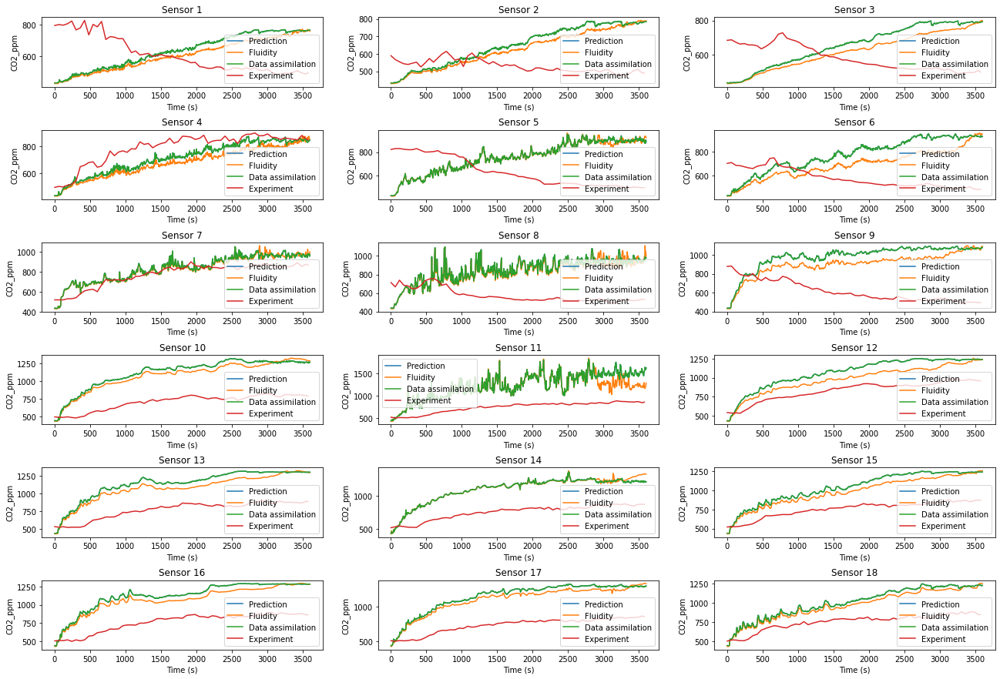

In [ ]:
plot_output_sensor_DA(pred_sensor_CO2, ob_CO2_all, pred_sensor_CO2_DA, 'CO2_ppm')

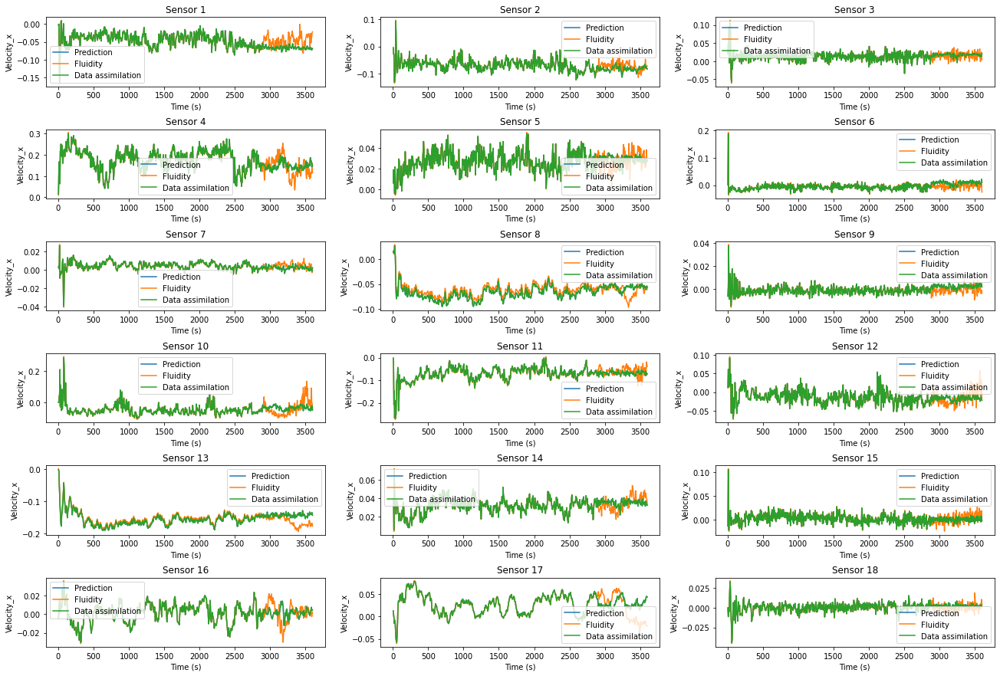

In [ ]:
plot_output_sensor_DA(pred_sensor_xdata, ob_xdata_all, pred_sensor_xdata_DA, 'Velocity_x')

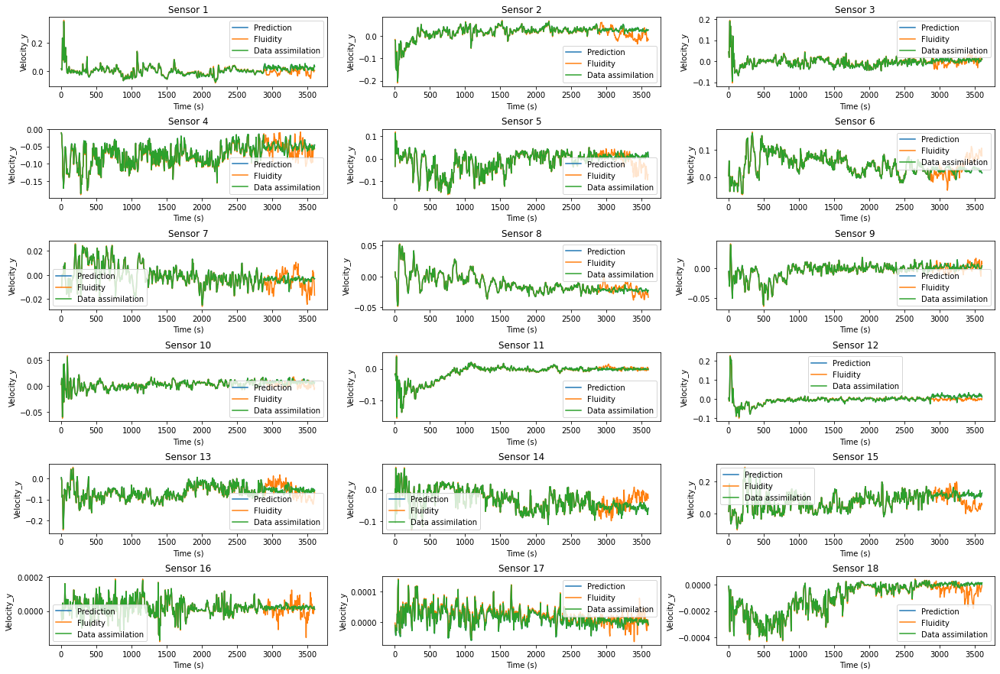

In [ ]:
plot_output_sensor_DA(pred_sensor_ydata, ob_ydata_all, pred_sensor_ydata_DA, 'Velocity_y')

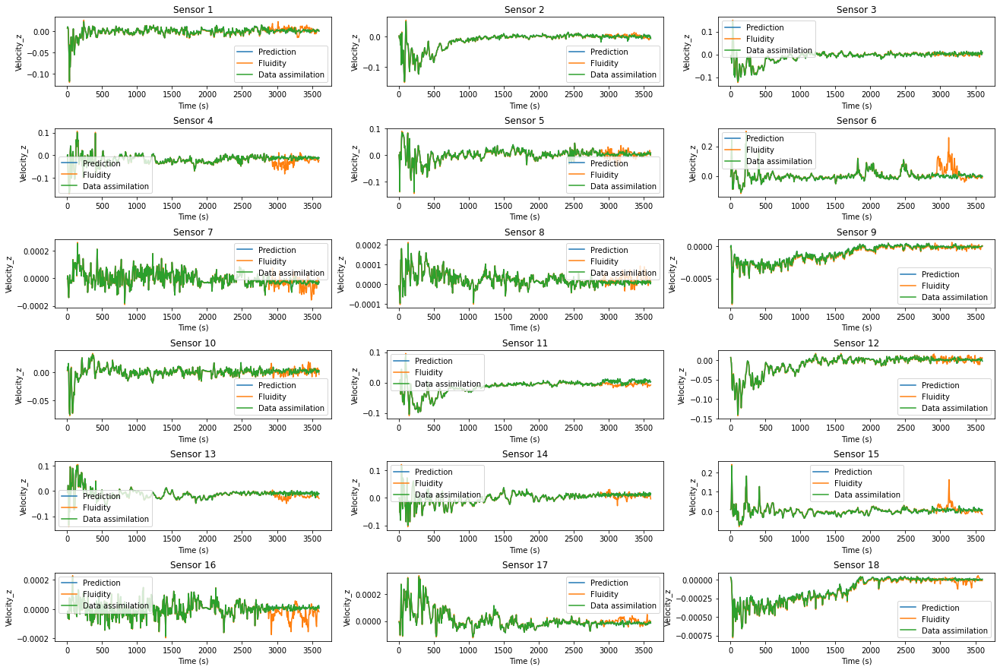

In [ ]:
plot_output_sensor_DA(pred_sensor_zdata, ob_zdata_all, pred_sensor_zdata_DA, 'Velocity_z')

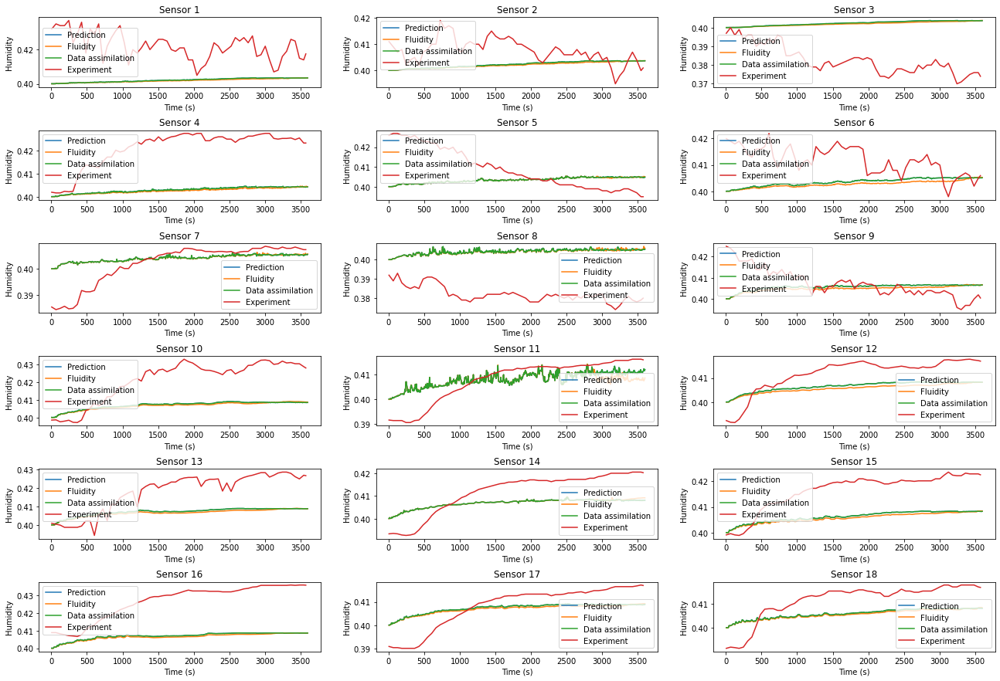

In [ ]:
plot_output_sensor_DA(pred_sensor_Humidity, ob_Humidity_all, pred_sensor_Humidity_DA, 'Humidity')

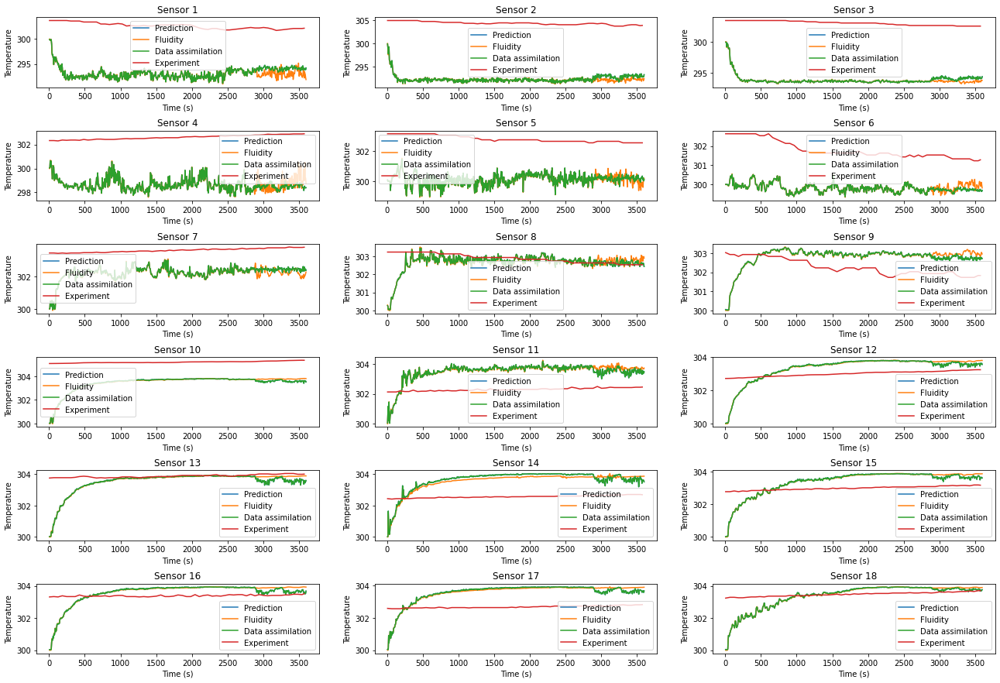

In [ ]:
plot_output_sensor_DA(pred_sensor_Temperature, ob_Temperature_all, pred_sensor_Temperature_DA, 'Temperature')

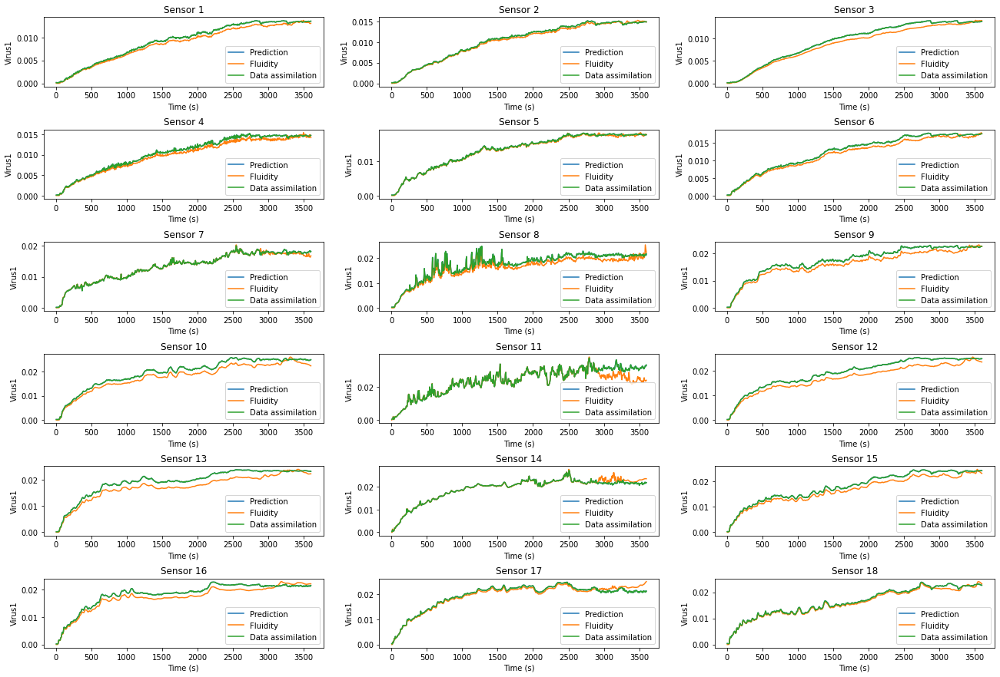

In [ ]:
plot_output_sensor_DA(pred_sensor_Virus1, ob_Virus1_all, pred_sensor_Virus1_DA, 'Virus1')

## Process node results after apply DA

In [ ]:
# Undo (0,1) scaling
X_DA_inverse_01 = scaler_01.inverse_transform(pod_pred_DA)
# Undo PCA to obtain a scaled snapshot matrix
X_DA_inverse_PCA = pca_compress.inverse_transform(X_DA_inverse_01)
# Split to CO2 and three dimensions of velocity data
X_DA_predict_split = np.hsplit(X_DA_inverse_PCA, 7)
# Undo (−1,1) scaling
DA_pred_CO2 = scaler_CO2_all.inverse_transform(X_DA_predict_split[0])
DA_pred_Velocity_x = scaler_x_all.inverse_transform(X_DA_predict_split[1])
DA_pred_Velocity_y = scaler_y_all.inverse_transform(X_DA_predict_split[2])
DA_pred_Velocity_z = scaler_z_all.inverse_transform(X_DA_predict_split[3])
DA_pred_Humidity = scaler_Humidity_all.inverse_transform(X_DA_predict_split[4])
DA_pred_Temperature = scaler_Temperature_all.inverse_transform(X_DA_predict_split[5])
DA_pred_Virus1 = scaler_Virus1_all.inverse_transform(X_DA_predict_split[6])

## Plot the results of nodes after apply DA

In [ ]:
def plot_output_DA(predict_data, CFD_data, DA_data, filename):
  fig, ax = plt.subplots(3, 3, figsize=[16,10])
  fig.tight_layout(h_pad=3.5, w_pad=3.5)
  for i in range(9):
    ax.flatten()[i].plot(x_axis*5, predict_data[:real_timestamp+prediction_num,i*200], '-')
    ax.flatten()[i].plot(x_axis*5, CFD_data[n:n+(real_timestamp+prediction_num)*step:step,i*200], '-')
    ax.flatten()[i].plot(x_axis_DA*5, DA_data[:real_timestamp+prediction_num,i*200], '-')
    ax.flatten()[i].legend(['Prediction', 'Fluidity', 'Input data'])
    ax.flatten()[i].set_title('Node '+ str(i*200+1))
    ax.flatten()[i].set_xlabel('Time (s)')
    ax.flatten()[i].set_ylabel(filename)
  path = '/content/drive/MyDrive/output_files/Figures/Figures_with_DA_Applied/nodes/All_set/exp_data/'+str(filename)+'_DA.png'
  # plt.savefig(path)

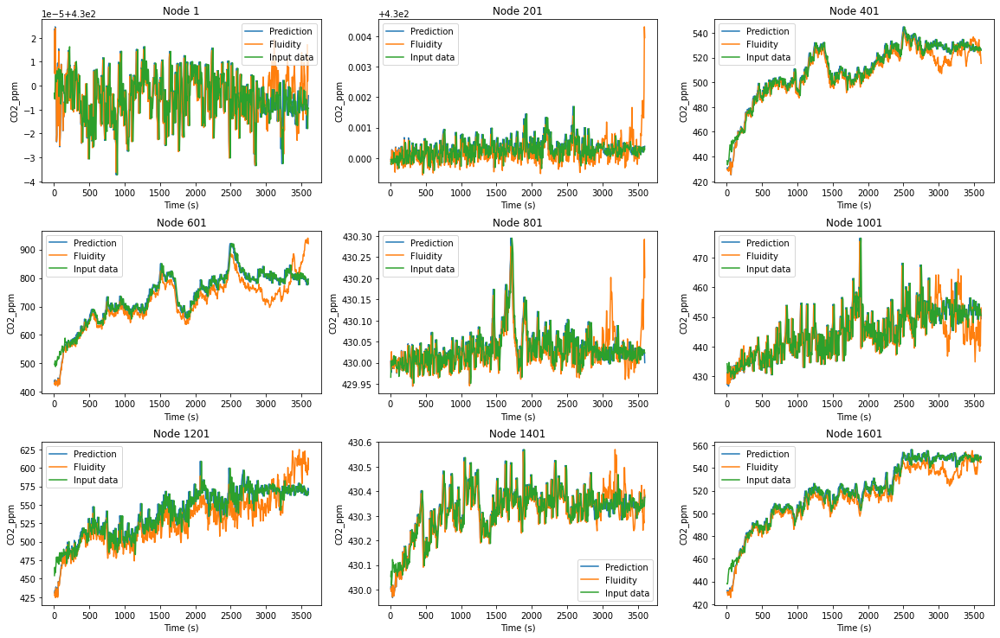

In [ ]:
plot_output_DA(pred_CO2, CFD_CO2, DA_pred_CO2, 'CO2_ppm')

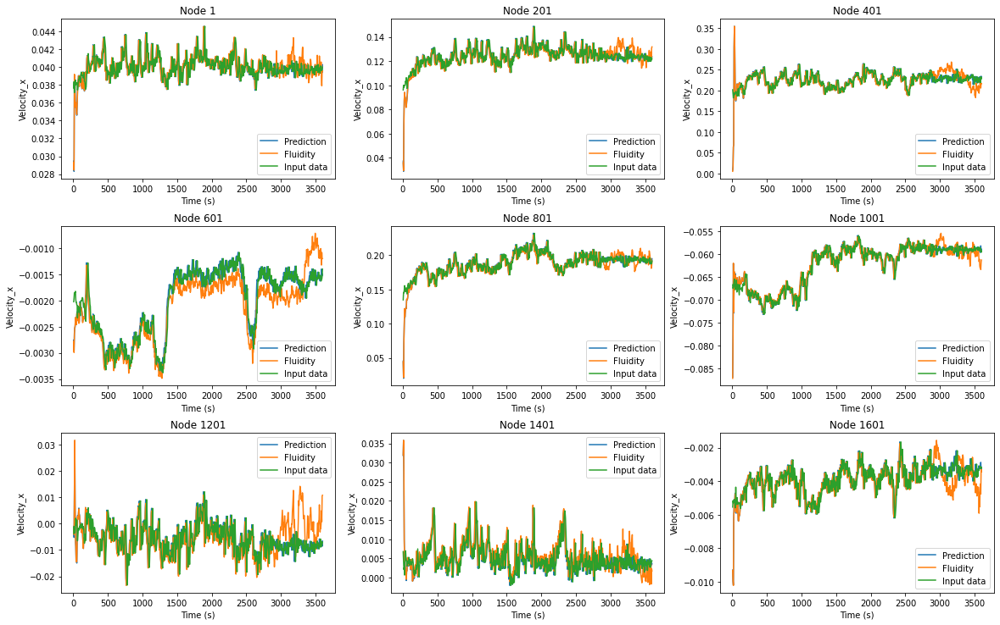

In [ ]:
plot_output_DA(pred_Velocity_x, CFD_Velocity_x, DA_pred_Velocity_x, 'Velocity_x')

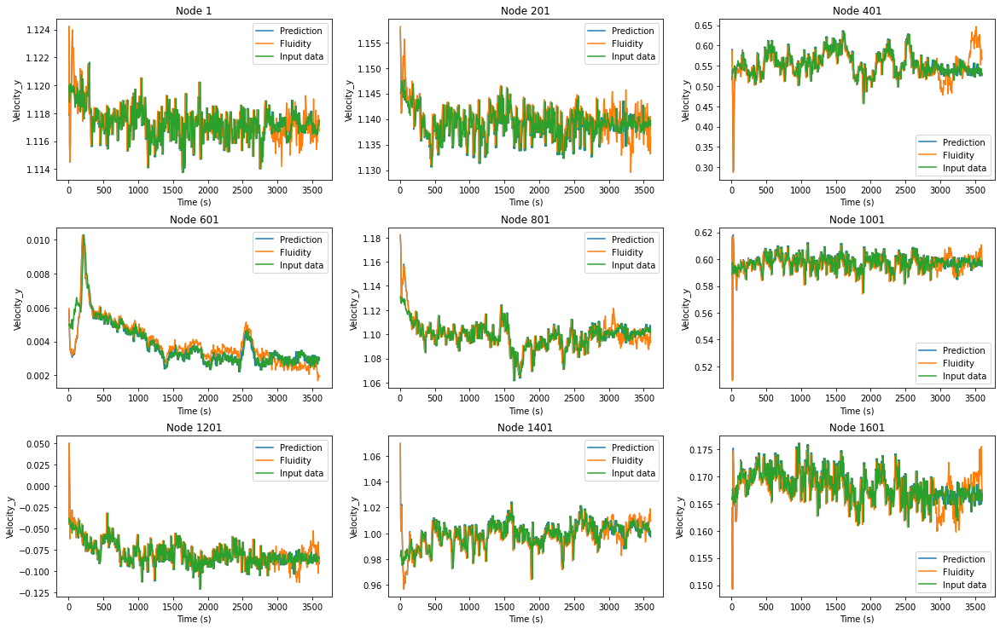

In [ ]:
plot_output_DA(pred_Velocity_y, CFD_Velocity_y, DA_pred_Velocity_y, 'Velocity_y')

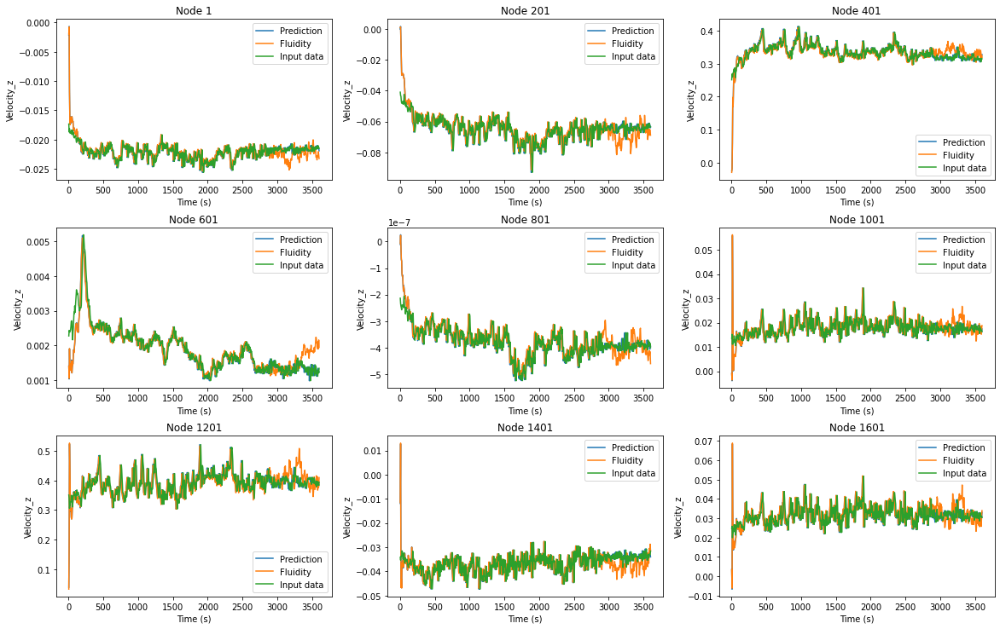

In [ ]:
plot_output_DA(pred_Velocity_z, CFD_Velocity_z, DA_pred_Velocity_z, 'Velocity_z')

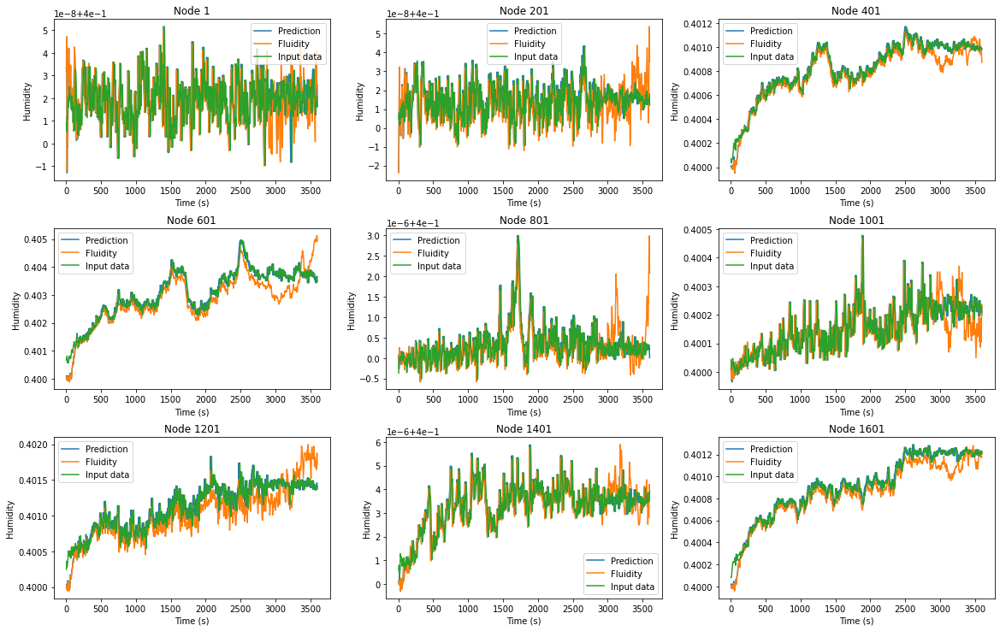

In [ ]:
plot_output_DA(pred_Humidity, CFD_Humidity, DA_pred_Humidity, 'Humidity')

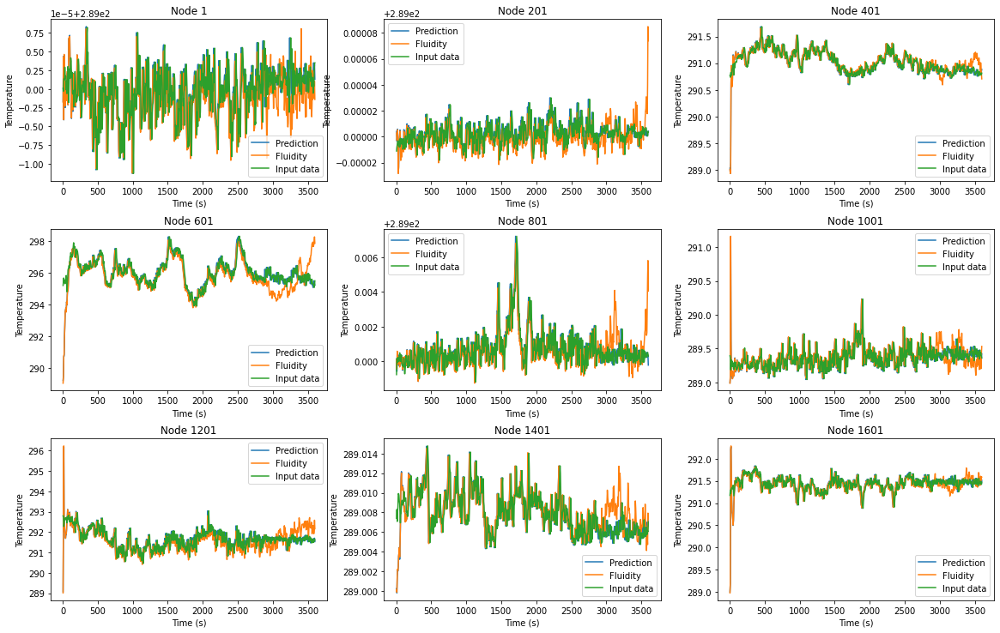

In [ ]:
plot_output_DA(pred_Temperature, CFD_Temperature, DA_pred_Temperature, 'Temperature')

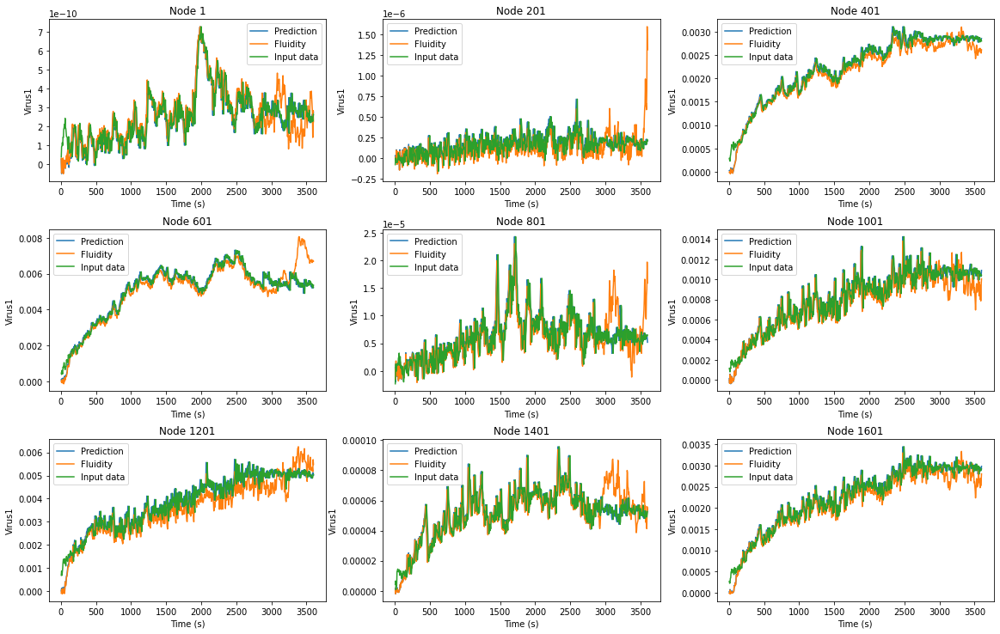

In [ ]:
plot_output_DA(pred_Virus1, CFD_Virus1, DA_pred_Virus1, 'Virus1')